In [1]:
import jax
import jax.nn as jnn
import jax.numpy as jnp
import numpy as np

import equinox as eqx
import diffrax
import optax
from functools import partial

In [2]:
import os
os.chdir("..")
from policy.policy_training import DPCTrainer
from exciting_environments.pmsm.pmsm_env import PMSM, step_eps
import jax_dataclasses as jdc
from models.models import MLP_lin, MLP_tanh,MLP
#from policy.networks import MLP#,MLP2
import matplotlib.pyplot as plt

2025-01-22 19:34:11.507408: W external/xla/xla/service/gpu/nvptx_compiler.cc:760] The NVIDIA driver's CUDA version is 12.2 which is older than the ptxas CUDA version (12.6.77). Because the driver is older than the ptxas version, XLA is disabling parallel compilation, which may slow down compilation. You should update your NVIDIA driver or use the NVIDIA-provided CUDA forward compatibility packages.


In [3]:
gpus = jax.devices()
jax.config.update("jax_default_device", gpus[0])
jax.config.update("jax_enable_x64", True)

In [4]:
import matplotlib.pyplot as plt
from matplotlib import cm
def valid_points(Z,D,Q):
    def cond(point):
        return (point[0]**2+point[1]**2-250**2 <= 0).astype(int)
    z_flat=Z.flatten()
    points=jnp.array([D.flatten(),Q.flatten()]).T
    val_points=jax.vmap(cond,in_axes=0)(points)
    z_flat_val=z_flat*val_points
    return z_flat_val.reshape(D.shape)

def eval_psi(expert_model):
    fig = plt.figure(figsize=(12,8))
    xx = np.linspace(-250, 0, 26)
    yy = np.linspace(-250, 250, 51)
    D, Q = np.meshgrid(xx, yy, indexing='ij')
    learned_psi={"Psi_d":expert_model.psi_d_mlp,"Psi_q":expert_model.psi_q_mlp}

    for  i,name in  zip(range(2),["Psi_d","Psi_q"]):
        
        interp=expert_model.motor_env.LUT_interpolators[name]
        Z = interp((D,Q))
        
        Z=Z*1000
        Z=valid_points(Z,D,Q)
        ax = fig.add_subplot(2, 3, 3*i +1, projection='3d')
        norm = plt.Normalize(Z.min(), Z.max())
        colors = cm.viridis(norm(Z))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D,Q, Z, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title(name+' in mH - LUT')

        mlp=learned_psi[name]
        z_flatt=jax.vmap(mlp)(jnp.array([D.flatten(),Q.flatten()]).T/expert_model.motor_env.env_properties.physical_constraints.i_d) #
        Z_d=z_flatt.reshape(D.shape)*1000
        
        Z_d=valid_points(Z_d,D,Q)

        ax = fig.add_subplot(2, 3, 3*i +2, projection='3d')
        norm = plt.Normalize(Z_d.min(), Z_d.max())
        colors = cm.viridis(norm(Z_d))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D, Q, Z_d, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title(name+' in mH - learned MLP')

        Z_difference=jnp.abs(Z - Z_d) #np.abs
        ax = fig.add_subplot(2, 3, 3*i +3, projection='3d')
        norm = plt.Normalize(Z_difference.min(), Z_difference.max())
        colors = cm.viridis(norm(Z_difference))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D, Q, Z_difference, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title('abs. error in mH')
        ax.ticklabel_format(style='plain')

    fig.show()

def eval_psi_and_L(expert_model):
    fig = plt.figure(figsize=(6,10))
    xx = np.linspace(-250, 0, 26)
    yy = np.linspace(-250, 250, 51)
    D, Q = np.meshgrid(xx, yy, indexing='ij')
    learned_psi={"Psi_d":expert_model.psi_d_mlp,"Psi_q":expert_model.psi_q_mlp,
                 "L_dd":expert_model.L_dd,"L_dq":expert_model.L_dq,"L_qd":expert_model.L_qd,"L_qq":expert_model.L_qq}

    for  i,name in  zip(range(6),["Psi_d","Psi_q","L_dd","L_dq","L_qd","L_qq"]):
        
        interp=expert_model.motor_env.LUT_interpolators[name]
        Z = interp((D,Q))
        
        Z=Z*1000
        Z=valid_points(Z,D,Q)
        ax = fig.add_subplot(6, 3, 3*i +1, projection='3d')
        norm = plt.Normalize(Z.min(), Z.max())
        colors = cm.viridis(norm(Z))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D,Q, Z, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title(name+' in mH - LUT')

        mlp=learned_psi[name]
        z_flatt=jax.vmap(mlp)(jnp.array([D.flatten(),Q.flatten()]).T/expert_model.motor_env.env_properties.physical_constraints.i_d)#
        Z_d=z_flatt.reshape(D.shape)*1000
        
        Z_d=valid_points(Z_d,D,Q)

        ax = fig.add_subplot(6, 3, 3*i +2, projection='3d')
        norm = plt.Normalize(Z_d.min(), Z_d.max())
        colors = cm.viridis(norm(Z_d))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D, Q, Z_d, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title(name+' in mH - learned MLP')

        Z_difference=jnp.abs(Z - Z_d) #np.abs
        ax = fig.add_subplot(6, 3, 3*i +3, projection='3d')
        norm = plt.Normalize(Z_difference.min(), Z_difference.max())
        colors = cm.viridis(norm(Z_difference))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D, Q, Z_difference, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title('abs. error in mH')
        ax.ticklabel_format(style='plain')

    fig.show()

def eval_L(expert_model):
    fig = plt.figure(figsize=(12,20))
    xx = np.linspace(-250, 0, 26)
    yy = np.linspace(-250, 250, 51)
    D, Q = np.meshgrid(xx, yy, indexing='ij')

    exp_values=1e-3*jax.vmap(expert_model.L_mlp)(jnp.array([D.flatten(),Q.flatten()]).T/expert_model.motor_env.env_properties.physical_constraints.i_d)
    

    for  i,name in  zip(range(4),["L_dd","L_dq","L_qd","L_qq"]):
        
        interp=expert_model.motor_env.LUT_interpolators[name]
        Z = interp((D,Q))
        
        Z=Z*1000
        Z=valid_points(Z,D,Q)
        ax = fig.add_subplot(6, 3, 3*i +1, projection='3d')
        norm = plt.Normalize(Z.min(), Z.max())
        colors = cm.viridis(norm(Z))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D,Q, Z, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title(name+' in mH - LUT')

        z_flatt=exp_values[:,i]
        Z_d=z_flatt.reshape(D.shape)*1000
        
        Z_d=valid_points(Z_d,D,Q)

        ax = fig.add_subplot(6, 3, 3*i +2, projection='3d')
        norm = plt.Normalize(Z_d.min(), Z_d.max())
        colors = cm.viridis(norm(Z_d))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D, Q, Z_d, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title(name+' in mH - learned MLP')

        Z_difference=jnp.abs(Z - Z_d) #np.abs
        ax = fig.add_subplot(6, 3, 3*i +3, projection='3d')
        norm = plt.Normalize(Z_difference.min(), Z_difference.max())
        colors = cm.viridis(norm(Z_difference))
        rcount, ccount, _ = colors.shape
        surf = ax.plot_surface(D, Q, Z_difference, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
        surf.set_facecolor((0,0,0,0))
        ax.azim=225
        ax.set_xlabel("i_d in A")
        ax.set_ylabel("i_q in A")
        ax.set_title('abs. error in mH')
        ax.ticklabel_format(style='plain')

    fig.show()

def eval_det(expert_model):
    fig = plt.figure(figsize=(12,8))
    xx = np.linspace(-250, 0, 26)
    yy = np.linspace(-250, 250, 51)
    D, Q = np.meshgrid(xx, yy, indexing='ij')
    def det_gt(i_dq):
        L_dd=motor_env.LUT_interpolators["L_dd"](i_dq)[0]
        L_dq=motor_env.LUT_interpolators["L_dq"](i_dq)[0]
        L_qd=motor_env.LUT_interpolators["L_qd"](i_dq)[0]
        L_qq=motor_env.LUT_interpolators["L_qq"](i_dq)[0]
        mat=jnp.array([[L_dd,L_dq],[L_qd,L_qq]])
        return jnp.linalg.det(mat)

    
    def det_model(i_dq):
        i_dq_norm=i_dq/motor_env.env_properties.physical_constraints.i_d
        mat=expert_model.L_matrix(i_dq_norm)
        return jnp.linalg.det(mat)

    L_det_gt=jax.vmap(det_gt)(jnp.array([D.flatten(),Q.flatten()]).T)#
    L_det_gt=L_det_gt.reshape(D.shape)
    L_det_gt=valid_points(L_det_gt,D,Q)
    L_det_pred=jax.vmap(det_model)(jnp.array([D.flatten(),Q.flatten()]).T)#
    L_det_pred=L_det_pred.reshape(D.shape)
    
    L_det_pred=valid_points(L_det_pred,D,Q)
    
    ax = fig.add_subplot(1, 3, 1, projection='3d')
    norm = plt.Normalize(L_det_gt.min(), L_det_gt.max())
    colors = cm.viridis(norm(L_det_gt))
    rcount, ccount, _ = colors.shape
    surf = ax.plot_surface(D,Q, L_det_gt, rcount=rcount, ccount=ccount,
                    facecolors=colors, shade=False)
    surf.set_facecolor((0,0,0,0))
    ax.set_xlabel("i_d in A")
    ax.set_ylabel("i_q in A")
    ax.set_title("det_gt")

    ax = fig.add_subplot(1, 3, 2, projection='3d')
    norm = plt.Normalize(L_det_pred.min(), L_det_pred.max())
    colors = cm.viridis(norm(L_det_pred))
    rcount, ccount, _ = colors.shape
    surf = ax.plot_surface(D,Q, L_det_pred, rcount=rcount, ccount=ccount,
                    facecolors=colors, shade=False)
    surf.set_facecolor((0,0,0,0))
    ax.set_xlabel("i_d in A")
    ax.set_ylabel("i_q in A")
    ax.set_title("det_pred")

    
    Z_difference=jnp.abs(L_det_gt - L_det_pred) #np.abs
    ax = fig.add_subplot(1, 3, 3, projection='3d')
    norm = plt.Normalize(Z_difference.min(), Z_difference.max())
    colors = cm.viridis(norm(Z_difference))
    rcount, ccount, _ = colors.shape
    surf = ax.plot_surface(D, Q, Z_difference, rcount=rcount, ccount=ccount,
                    facecolors=colors, shade=False)
    surf.set_facecolor((0,0,0,0))
    ax.set_xlabel("i_d in A")
    ax.set_ylabel("i_q in A")
    ax.set_title('abs. error in mH')
    ax.ticklabel_format(style='plain')

    fig.show()
        

In [5]:
class ExpertModel(eqx.Module):
    motor_env: PMSM = eqx.field(static=True)
    psi_d_mlp: MLP
    psi_q_mlp: MLP
    
    def __init__(self,motor_env,psi_layer_sizes,L_layer_sizes,key):
        self.motor_env=motor_env
        key , subkey = jax.random.split(key)
        self.psi_d_mlp=MLP(psi_layer_sizes,key=subkey,hidden_activation=jax.nn.swish,output_activation=jax.nn.tanh)#
        key , subkey = jax.random.split(key)
        self.psi_q_mlp=MLP(psi_layer_sizes,key=subkey,hidden_activation=jax.nn.swish,output_activation=jax.nn.tanh)#,output_activation=jax.nn.tanh


    def __call__(self, init_obs, actions, tau):

        def body_fun(carry, action):
            obs = carry
            obs = self.step(obs, action, tau)
            return obs, obs

        _, observations = jax.lax.scan(body_fun, init_obs, actions)
        observations = jnp.concatenate([init_obs[None, :], observations], axis=0)
        return observations
    
    def step(self, obs ,action,tau):
        obs1,_= self.motor_env.reset(self.motor_env.env_properties)  #
        obs1 = obs1.at[2].set((3*1500 / 60 * 2 * jnp.pi) / (2 * jnp.pi * 3 * 11000 / 60))
        obs1 = obs1.at[0].set(obs[0])
        obs1 = obs1.at[1].set(obs[1])
        obs1 = obs1.at[4].set(obs[2])
        obs1 = obs1.at[5].set(obs[3])
        state=self.motor_env.generate_state_from_observation(obs1,self.motor_env.env_properties)
        #obs,_= self.motor_env.step(state, action, self.motor_env.env_properties)
        obs,_=self.step_expert(state,action,self.motor_env.env_properties)
        return jnp.concatenate([obs[0:2],obs[4:6]])
    
    @partial(jax.jit, static_argnums=[0, 3])
    def ode_step(self, state, u_dq, properties):
        """Computes state by simulating one step.

        Args:
            system_state: The state from which to calculate state for the next step.
            u_dq: The action to apply to the environment.
            properties: Parameters and settings of the environment, that do not change over time.

        Returns:
            state: The computed state after the one step simulation.
        """
        system_state = state.physical_state
        omega_el = system_state.omega_el
        i_d = system_state.i_d
        i_q = system_state.i_q
        eps = system_state.epsilon

        args = (u_dq, properties.static_params)
        if properties.saturated:

            def vector_field(t, y, args):
                i_d, i_q = y
                u_dq, _ = args

                J_k = jnp.array([[0, -1], [1, 0]])
                i_dq = jnp.array([i_d, i_q])
                p_d = {q: interp(jnp.array([i_d, i_q])) for q, interp in self.motor_env.LUT_interpolators.items()}
                i_dq_norm=i_dq/properties.physical_constraints.i_d
                

                p_d["Psi_d"]=self.psi_d_mlp(i_dq_norm)
                p_d["Psi_q"]=self.psi_q_mlp(i_dq_norm)
                p_d["L_dd"]=self.L_dd(i_dq_norm)
                p_d["L_dq"]=self.L_dq(i_dq_norm)
                p_d["L_qd"]=self.L_qd(i_dq_norm)
                p_d["L_qq"]=self.L_qq(i_dq_norm)
            

                L_diff = jnp.column_stack([p_d[q] for q in ["L_dd", "L_dq", "L_qd", "L_qq"]]).reshape(2, 2)
                #L_diff_inv = 1/(p_d["L_dd"]*p_d["L_qq"]-p_d["L_dq"]*p_d["L_qd"])*(jnp.array([[p_d["L_qq"],-p_d["L_dq"]],[-p_d["L_qd"],p_d["L_dd"]]]).reshape(2, 2)) #jnp.linalg.inv(L_diff) 
                L_diff_inv=jnp.linalg.inv(L_diff)
                psi_dq = jnp.column_stack([p_d[psi] for psi in ["Psi_d", "Psi_q"]]).reshape(-1)
                di_dq_1 = jnp.einsum(
                    "ij,j->i",
                    (-L_diff_inv * properties.static_params.r_s),
                    i_dq,
                )
                di_dq_2 = jnp.einsum("ik,k->i", L_diff_inv, u_dq)
                di_dq_3 = jnp.einsum("ij,jk,k->i", -L_diff_inv, J_k, psi_dq) * omega_el
                i_dq_diff = di_dq_1 + di_dq_2 + di_dq_3
                d_y = i_dq_diff[0], i_dq_diff[1]

                return d_y

        else:

            def vector_field(t, y, args):
                i_d, i_q = y
                u_dq, params = args
                u_d = u_dq[0]
                u_q = u_dq[1]
                l_d = params.l_d
                l_q = params.l_q
                psi_p = params.psi_p
                r_s = params.r_s
                i_d_diff = (u_d + omega_el * l_q * i_q - r_s * i_d) / l_d
                i_q_diff = (u_q - omega_el * (l_d * i_d + psi_p) - r_s * i_q) / l_q
                d_y = i_d_diff, i_q_diff
                return d_y

        term = diffrax.ODETerm(vector_field)
        t0 = 0
        t1 = self.motor_env.tau
        y0 = tuple([i_d, i_q])
        env_state = self.motor_env._solver.init(term, t0, t1, y0, args)
        y, _, _, env_state, _ = self.motor_env._solver.step(term, t0, t1, y0, args, env_state, made_jump=False)

        i_d_k1 = y[0]
        i_q_k1 = y[1]

        if properties.saturated:
            torque = jnp.array([self.motor_env.currents_to_torque_saturated(i_d=i_d_k1, i_q=i_q_k1, env_properties=properties)])[
                0
            ]
        else:
            torque = jnp.array([self.motor_env.currents_to_torque(i_d_k1, i_q_k1, properties)])[0]

        with jdc.copy_and_mutate(system_state, validate=False) as system_state_next:
            system_state_next.epsilon = step_eps(eps, omega_el, self.motor_env.tau, 1.0)
            system_state_next.i_d = i_d_k1
            system_state_next.i_q = i_q_k1
            system_state_next.torque = torque  # [0]

        with jdc.copy_and_mutate(state, validate=False) as state_next:
            state_next.physical_state = system_state_next
        return state_next

    @partial(jax.jit, static_argnums=[0, 3])
    def step_expert(self, state, action, env_properties):
        """Computes state by simulating one step taking the deadtime into account.

        Args:
            system_state: The state from which to calculate state for the next step.
            action: The action to apply to the environment.
            properties: Parameters and settings of the environment, that do not change over time.

        Returns:
            state: The computed state after the one step simulation.
        """

        action = self.motor_env.constraint_denormalization(action, state, env_properties)

        action_buffer = jnp.array([state.physical_state.u_d_buffer, state.physical_state.u_q_buffer])

        if env_properties.static_params.deadtime > 0:

            updated_buffer = jnp.array([action[0], action[1]])
            u_dq = action_buffer
        else:
            updated_buffer = action_buffer

            u_dq = action

        next_state = self.ode_step(state, u_dq, env_properties)
        with jdc.copy_and_mutate(next_state, validate=True) as next_state_update:
            next_state_update.physical_state.u_d_buffer = updated_buffer[0]
            next_state_update.physical_state.u_q_buffer = updated_buffer[1]

        observation = self.motor_env.generate_observation(next_state_update, env_properties)
        return observation, next_state_update

    def psi_d(self,i_dq):
        i_dq_norm=i_dq/self.motor_env.env_properties.physical_constraints.i_d
        return self.psi_d_mlp(i_dq_norm)[0] #  self.motor_env.LUT_interpolators["Psi_d"](i_dq)[0]  
    def psi_q(self,i_dq):
        i_dq_norm=i_dq/self.motor_env.env_properties.physical_constraints.i_d
        return self.psi_q_mlp(i_dq_norm)[0]#   self.motor_env.LUT_interpolators["Psi_q"](i_dq)[0]
    def l_d_dq(self,i_dq):
        return jax.grad(self.psi_d)(i_dq)
    def l_q_dq(self,i_dq):
        return jax.grad(self.psi_q)(i_dq)
    
    def L_dd(self,i_dq_norm):
        i_dq=i_dq_norm*self.motor_env.env_properties.physical_constraints.i_d
        return self.l_d_dq(i_dq)[0]
    def L_dq(self,i_dq_norm):
        i_dq=i_dq_norm*self.motor_env.env_properties.physical_constraints.i_d
        return self.l_d_dq(i_dq)[1]
    def L_qd(self,i_dq_norm):
        i_dq=i_dq_norm*self.motor_env.env_properties.physical_constraints.i_d
        return self.l_q_dq(i_dq)[0]
    def L_qq(self,i_dq_norm):
        i_dq=i_dq_norm*self.motor_env.env_properties.physical_constraints.i_d
        return self.l_q_dq(i_dq)[1]
    
    def L_matrix(self, i_dq):
        L_dd=self.L_dd(i_dq)
        L_dq=self.L_dq(i_dq)
        L_qd=self.L_qd(i_dq)
        L_qq=self.L_qq(i_dq)
        mat=jnp.array([[L_dd,L_dq],[L_qd,L_qq]])
        return mat
    

In [6]:
motor_env = PMSM(
    saturated=True,
    LUT_motor_name="BRUSA",
    batch_size=1,
    control_state=[], 
    static_params = {
            "p": 3,
            "r_s": 15e-3,
            "l_d": 0.37e-3,
            "l_q": 1.2e-3,
            "psi_p": 65.6e-3,
            "deadtime": 0,
    })

## Model Learning

In [7]:
from utils.interactions import rollout_traj_env_policy
from models.model_training import ModelTrainer
from models.models import NeuralEulerODE

In [8]:
def featurize_node(obs):
    return obs#jnp.concatenate([obs[0:2],obs[4:6]])

In [9]:
import json
with open('model_data/dmpe4.json') as json_data:
    d = json.load(json_data)
long_obs=jnp.array(d["observations"])
long_acts=jnp.array(d["actions"])


def step_eps(eps, omega_el, tau, tau_scale=1.0):
    eps += omega_el * tau * tau_scale
    eps %= 2 * jnp.pi
    boolean = eps > jnp.pi
    summation_mask = boolean * -2 * jnp.pi
    eps = eps + summation_mask
    return eps
eps=[0]
for i in range(long_obs.shape[0]):
    eps.append(step_eps(eps[-1],3*1500 / 60 * 2 * jnp.pi,1e-4))
cos_long_eps=jnp.cos(jnp.array(eps[:-1])[:,None])
sin_long_eps=jnp.sin(jnp.array(eps[:-1])[:,None])
long_obs=jnp.hstack([long_obs,cos_long_eps,sin_long_eps])

long_obs_train=long_obs[:-400]
long_acts_train=long_acts[:-400]
long_obs_val=long_obs[-400:]
long_acts_val=long_acts[-399:]

In [10]:
from utils.interactions import vmap_rollout_traj_node,rollout_traj_env
#obs=vmap_rollout_traj_ode(node,featurize_node,jnp.array([long_obs_val,long_obs_val])[:,0,:],jnp.array([long_acts_val,long_acts_val]),1e-4)
obs1,_= motor_env.reset(motor_env.env_properties)  #
obs1 = obs1.at[2].set((3*1500 / 60 * 2 * jnp.pi) / (2 * jnp.pi * 3 * 11000 / 60))
obs1 = obs1.at[0].set(long_obs_val[0][0])
obs1 = obs1.at[1].set(long_obs_val[0][1])
obs1 = obs1.at[4].set(long_obs_val[0][2])
obs1 = obs1.at[5].set(long_obs_val[0][3])
obs= rollout_traj_env(env=motor_env,init_obs=obs1,actions=long_acts_val)

In [11]:
def data_gen_single(rng, sequence_len):
    rng, subkey = jax.random.split(rng)
    idx = jax.random.randint(subkey, shape=(1,),minval=0, maxval=(long_obs_train.shape[0]-sequence_len-1))

    slice = jnp.linspace(
            start=idx, stop=idx + sequence_len, num=sequence_len+1, dtype=int
        ).T
    act_slice = jnp.linspace(
            start=idx, stop=idx + sequence_len-1, num=sequence_len, dtype=int
        ).T
    
    obs=long_obs_train[slice][0]
    acts=long_acts_train[act_slice][0]
    return obs,acts,rng

In [12]:
@eqx.filter_jit
def val_data_gen_single(rng, sequence_len):
    obs=long_obs_val
    acts=long_acts_val
    return obs,acts,rng

In [13]:
def L_det_pred(model,obs):
    i_dq_norm=jnp.array([obs[0]*0.5-0.5,obs[1]])
    L_mat=model.L_matrix(i_dq_norm)
    return jnp.linalg.det(L_mat)

In [14]:
def L_dd(model,obs):
    i_dq_norm=jnp.array([obs[0]*0.5-0.5,obs[1]])
    L_dd=model.L_dd(i_dq_norm)
    return L_dd

In [15]:
def L_qq(model,obs):
    i_dq_norm=jnp.array([obs[0]*0.5-0.5,obs[1]])
    L_qq=model.L_qq(i_dq_norm)
    return L_qq

In [16]:
jnp.sign(jnp.array([-1,0,3]))

Array([-1,  0,  1], dtype=int64)

In [17]:
@eqx.filter_value_and_grad
def grad_loss(model, true_obs, actions, tau, featurize):

    feat_pred_obs = vmap_rollout_traj_node(model, featurize, true_obs[:, 0, :], actions, tau)
    # create vmap_rollout_traj_node

    feat_true_obs = jax.vmap(jax.vmap(featurize, in_axes=(0)), in_axes=(0))(true_obs)
    # eventually vmap along multiple dimensions (multiple vmaps)

    # positive determinant
    det_pred=jax.vmap(jax.vmap(L_det_pred, in_axes=(None,0)), in_axes=(None,0))(model,feat_pred_obs)
    L_dds= jax.vmap(jax.vmap(L_dd, in_axes=(None,0)), in_axes=(None,0))(model,feat_pred_obs)
    L_qqs= jax.vmap(jax.vmap(L_qq, in_axes=(None,0)), in_axes=(None,0))(model,feat_pred_obs)
    scaling_det=1e9
    scaling_pos=1e10

    return jnp.mean((feat_pred_obs - feat_true_obs) ** 2)+scaling_det*(jnp.mean(jax.nn.relu(-det_pred)))+scaling_pos*jnp.mean(jax.nn.relu(-L_dds))+scaling_pos*jnp.mean(jax.nn.relu(-L_qqs)) #
    #return jnp.mean((feat_pred_obs - feat_true_obs) ** 2)+scaling_det*(jnp.mean(jax.nn.relu(-det_pred)))+scaling_pos*jnp.mean((0.5*jnp.sign(-L_dds)+0.5)*(jax.nn.relu(-L_dds)+10/scaling_pos))+scaling_pos*jnp.mean((0.5*jnp.sign(-L_qqs)+0.5)*(jax.nn.relu(-L_qqs)+10/scaling_pos)) #

In [18]:
optimizer_node = optax.adam(1e-4)


In [19]:
batch_size=100
mtrainer=ModelTrainer(
    train_steps=500_000,
    batch_size=batch_size,
    sequence_len=1,
    featurize=featurize_node,
    train_data_gen_sin=data_gen_single,
    val_data_gen_sin= val_data_gen_single,
    model_optimizer=optimizer_node,
    tau= 1e-4,
    loss_func=grad_loss
    )
keys=jax.vmap(jax.random.PRNGKey)(np.random.randint(0, 2**31, size=(batch_size,)))

In [20]:
jax_key = jax.random.PRNGKey(14) # 10,11,13 worked
node = ExpertModel(motor_env=motor_env,psi_layer_sizes=[2,64,64,1],L_layer_sizes=[2,64,64,4],key=jax_key)#NeuralEulerODE([4,128,128,128,128,2],key=jax_key)
opt_state = optimizer_node.init(node)

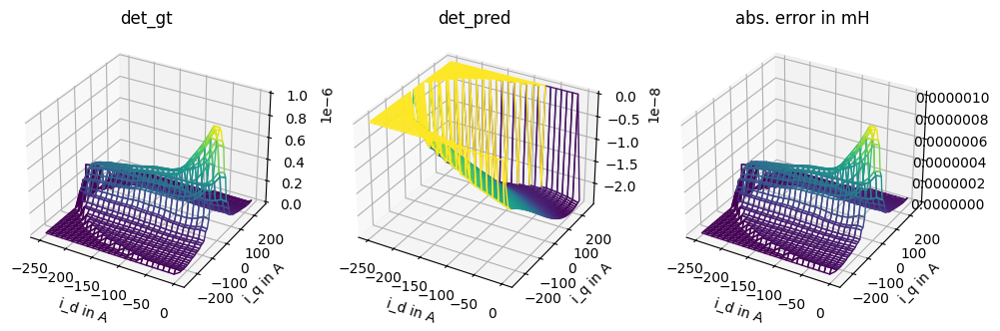

In [21]:
eval_det(node)

  0%|          | 0/500000 [00:00<?, ?it/s]

710001.5814280234


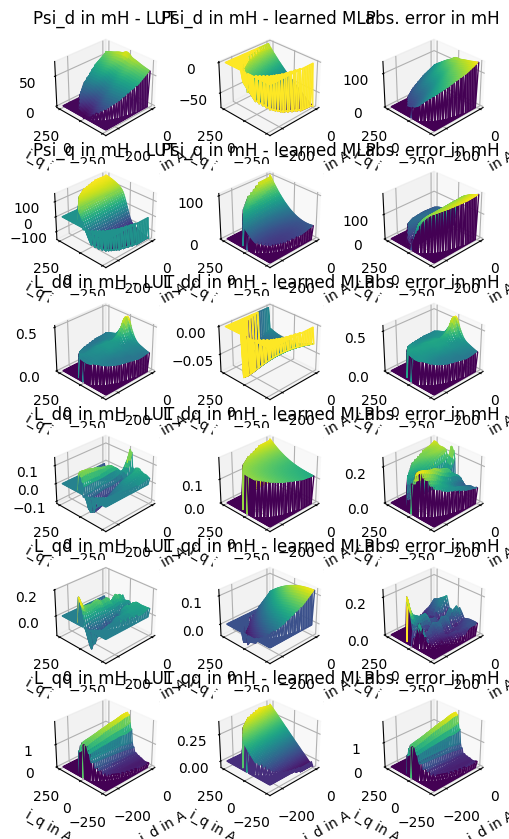

  2%|▏         | 9997/500000 [01:09<45:20, 180.09it/s] 

6.379446371287443


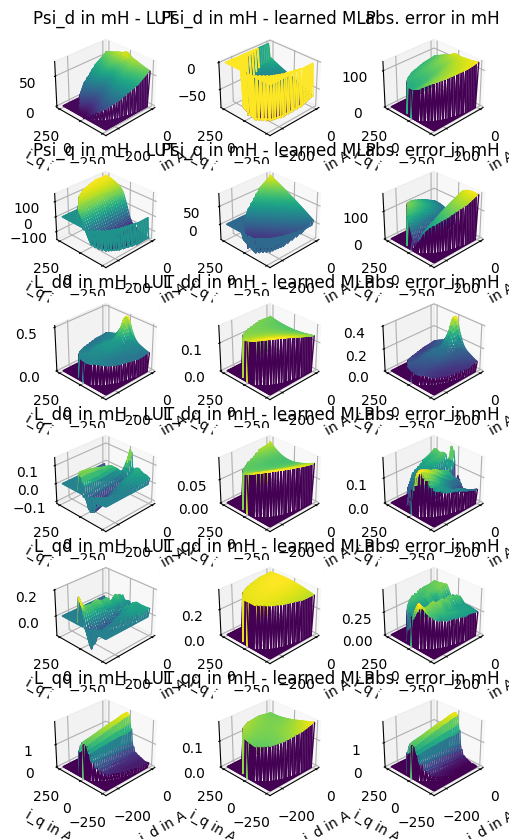

  4%|▍         | 19988/500000 [02:08<44:29, 179.84it/s]  

0.006831097109454377


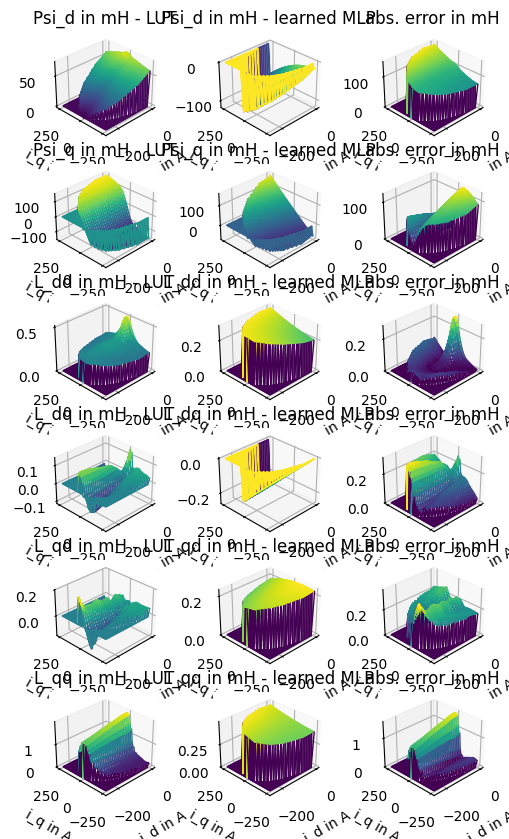

  6%|▌         | 29986/500000 [03:07<43:59, 178.08it/s]  

0.0044059112878809155


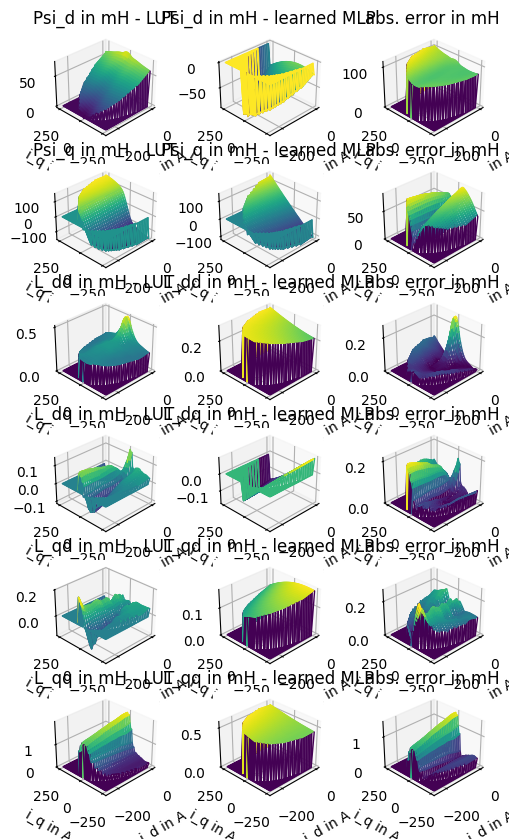

  8%|▊         | 39986/500000 [04:07<42:51, 178.87it/s]  

0.0020933517661220428


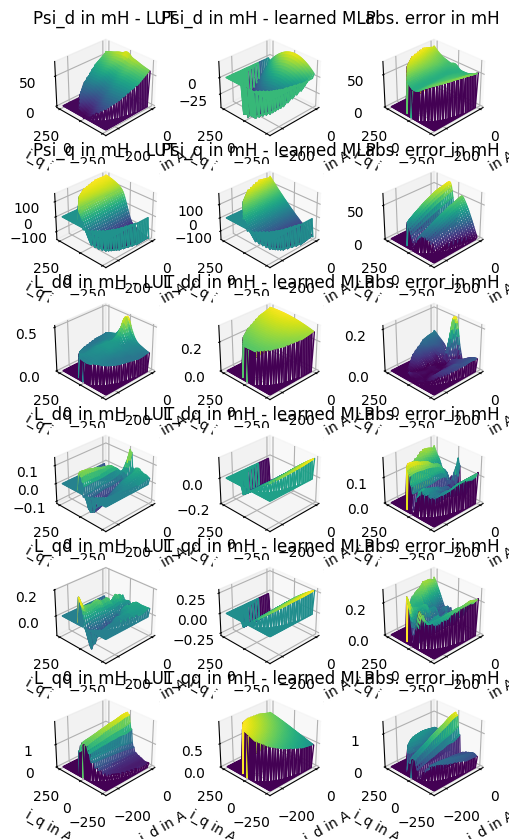

 10%|▉         | 49987/500000 [05:07<41:54, 178.94it/s]  

0.006097725018187603


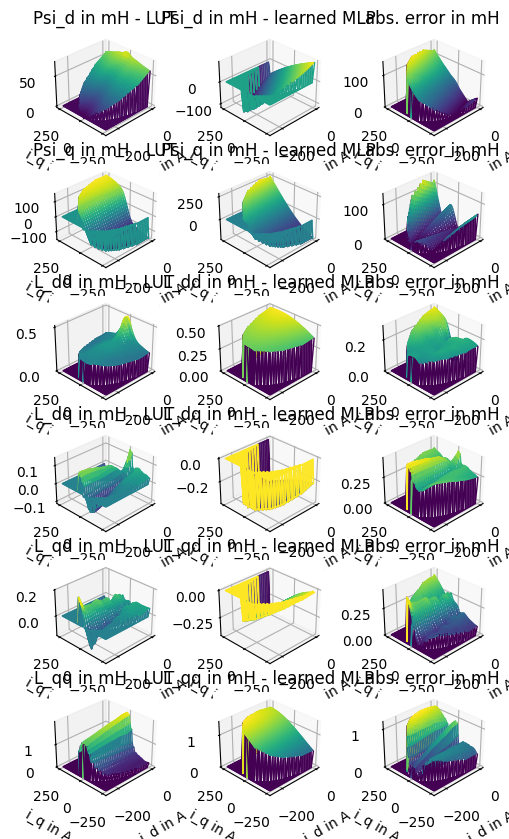

 12%|█▏        | 59988/500000 [06:06<41:02, 178.70it/s]  

0.003423665457458347


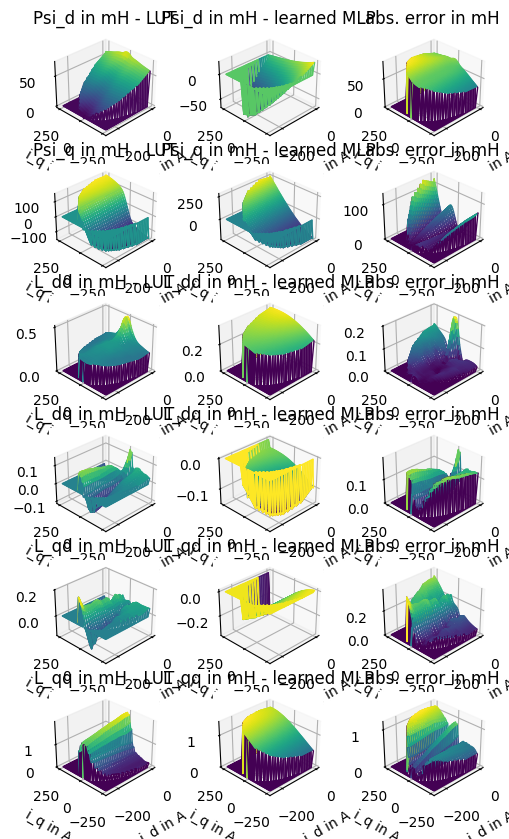

 14%|█▍        | 69992/500000 [07:06<40:19, 177.70it/s]  

0.0012162636384680774


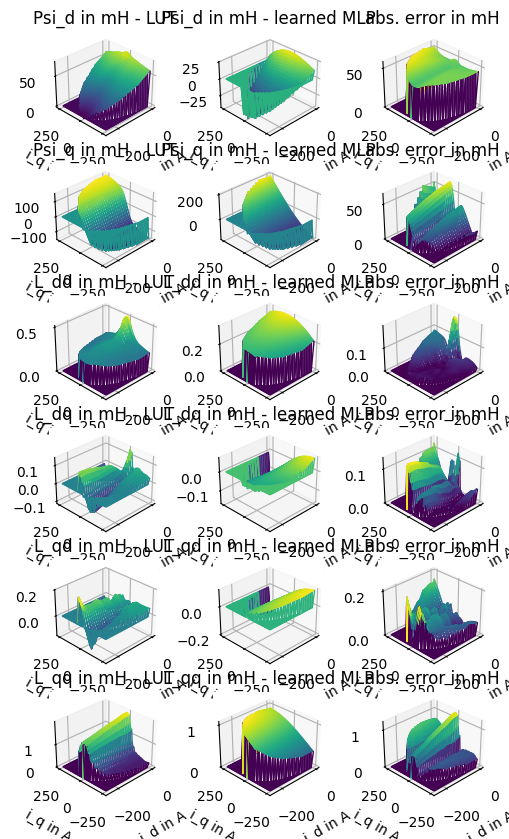

 16%|█▌        | 79994/500000 [08:06<39:08, 178.83it/s]  

0.005982591344733674


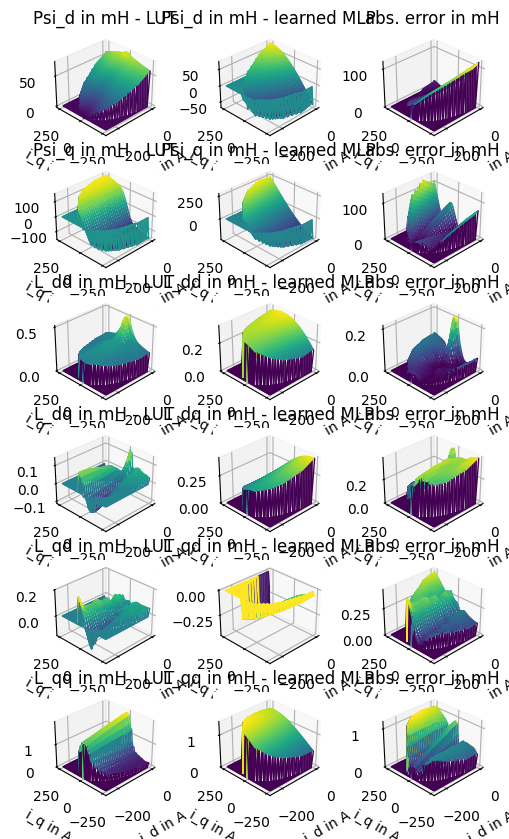

 18%|█▊        | 89998/500000 [09:06<38:13, 178.76it/s]  

0.0029371652899971503


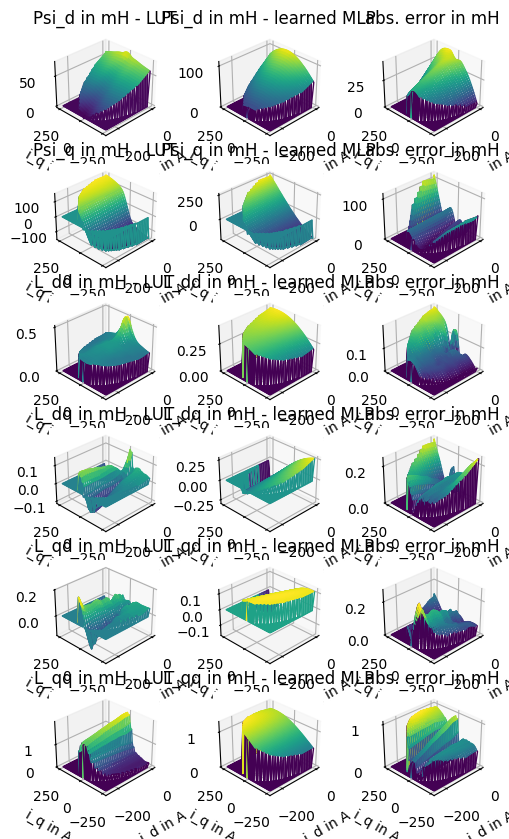

 20%|█▉        | 99985/500000 [10:06<37:18, 178.69it/s]  

0.0013586238242354926


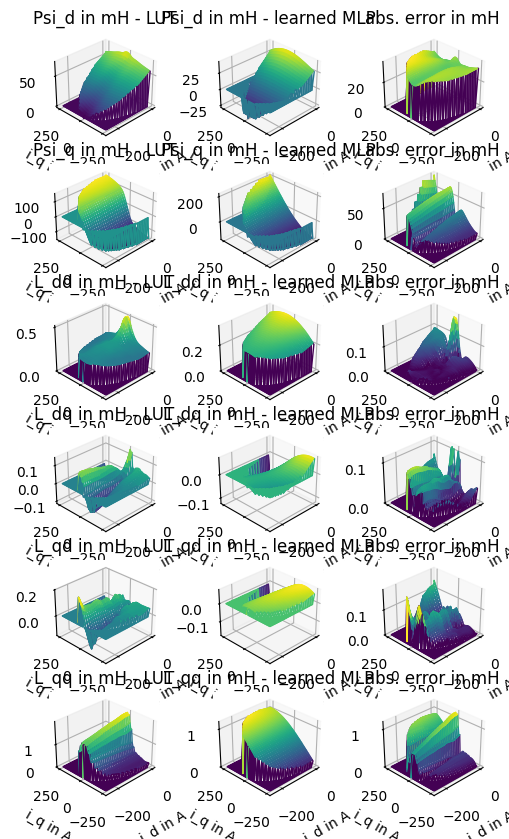

 22%|██▏       | 109987/500000 [11:06<36:21, 178.79it/s]  

0.006321976315300777


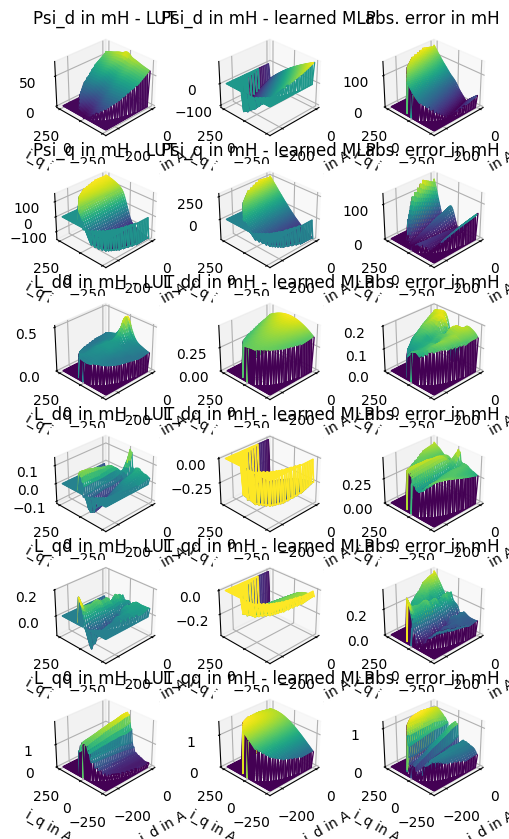

 24%|██▍       | 119991/500000 [12:05<35:25, 178.79it/s] 

0.0028858719705751068


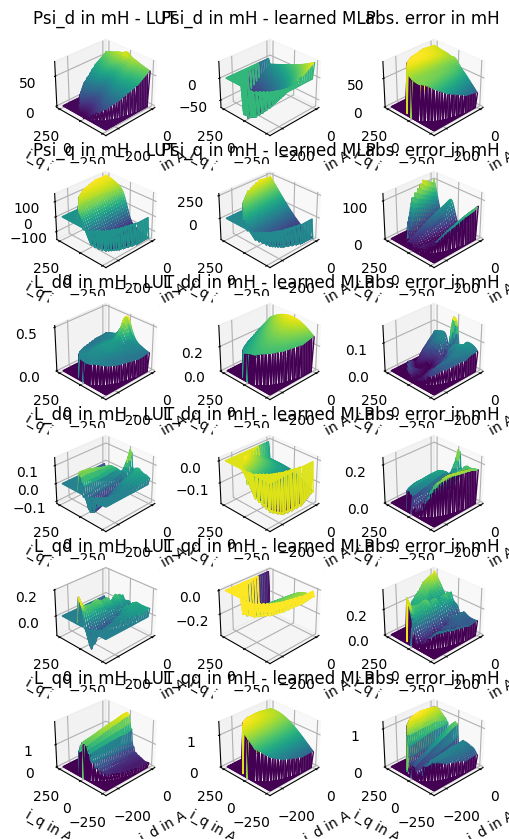

 26%|██▌       | 129996/500000 [13:05<34:48, 177.14it/s]  

0.0011578400895485535


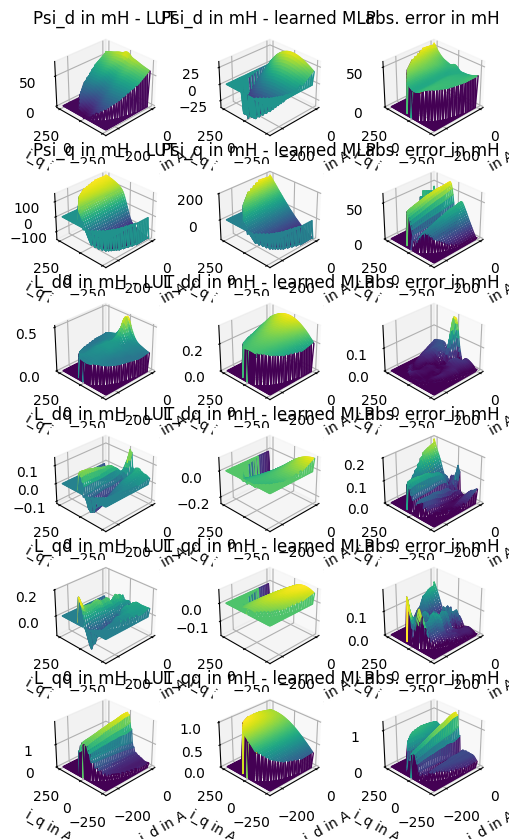

 28%|██▊       | 140000/500000 [14:05<33:50, 177.34it/s] 

0.0016359547320722013


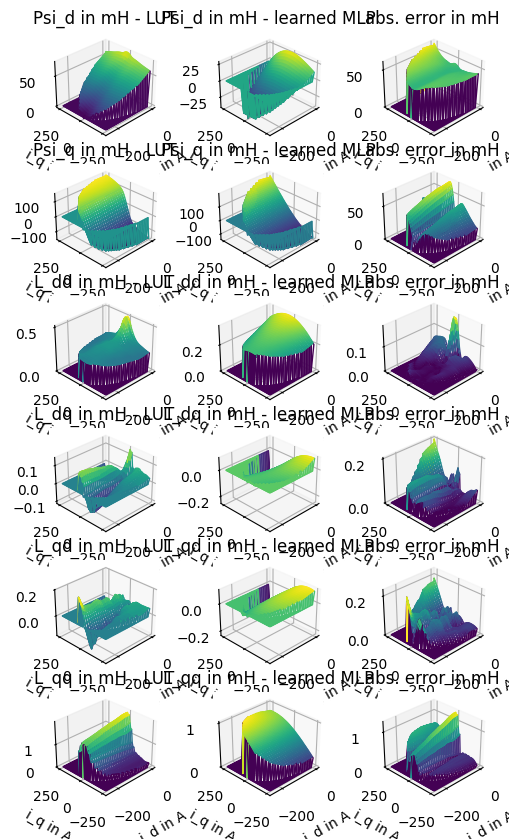

 30%|██▉       | 149985/500000 [15:05<32:34, 179.12it/s] 

0.0015465389470063634


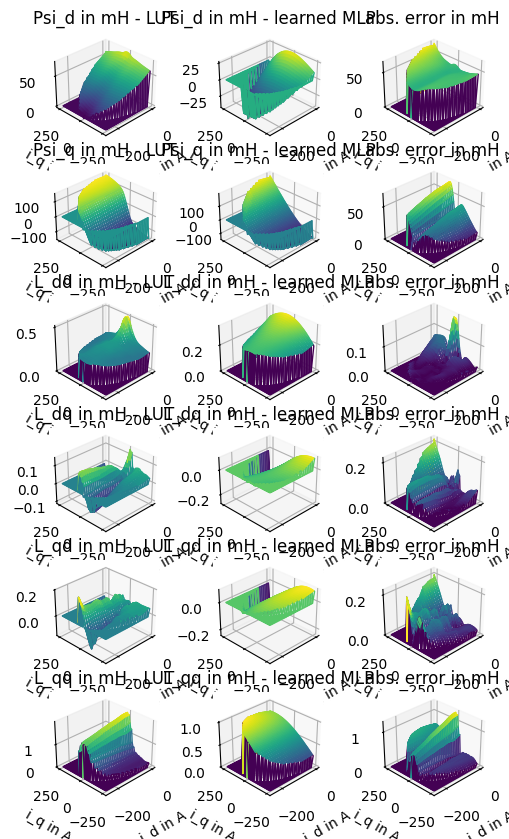

 32%|███▏      | 159984/500000 [16:05<31:41, 178.86it/s] 

0.005956988188437175


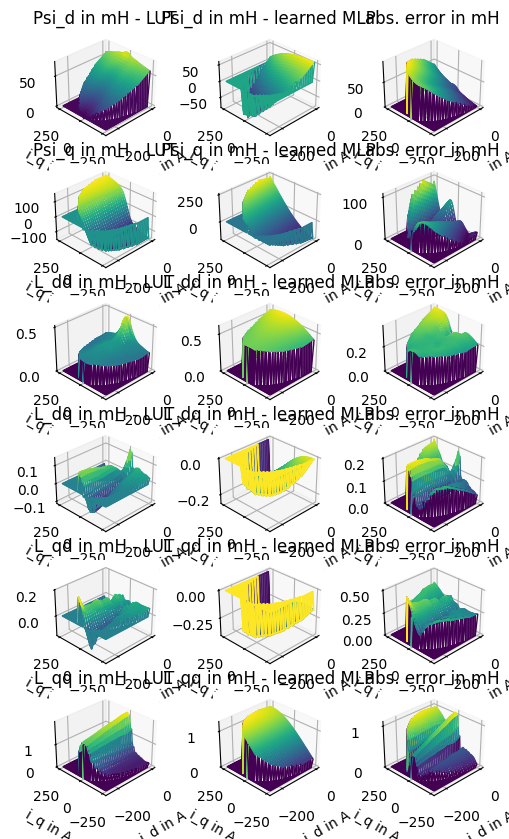

 34%|███▍      | 169984/500000 [17:05<30:46, 178.71it/s] 

0.0056218247572945865


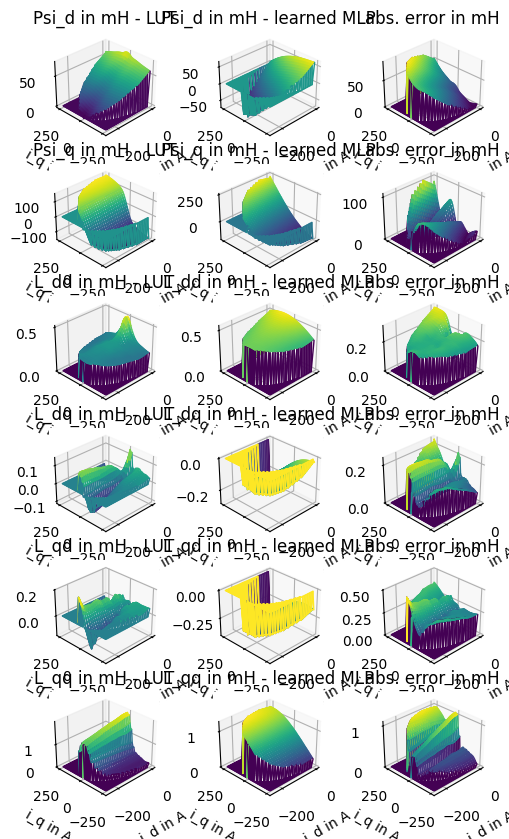

 36%|███▌      | 179983/500000 [18:05<29:47, 179.01it/s] 

0.0012064992725145673


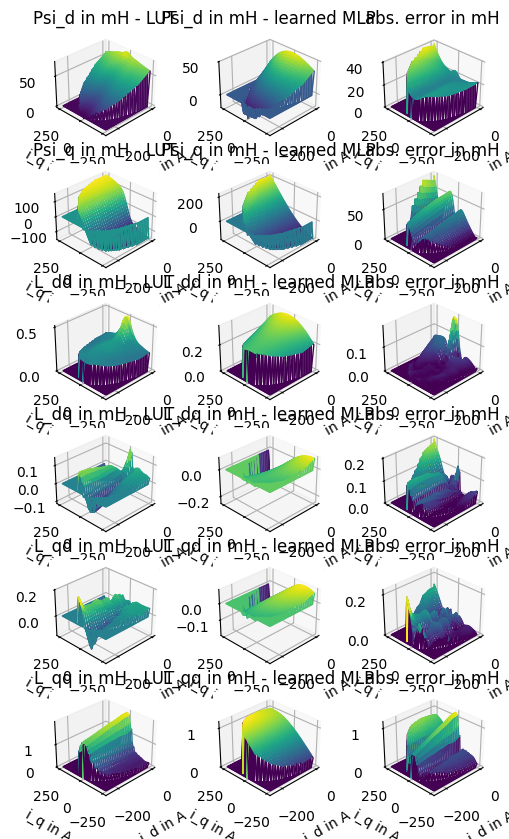

 38%|███▊      | 189985/500000 [19:05<29:04, 177.75it/s] 

67650.83152733014


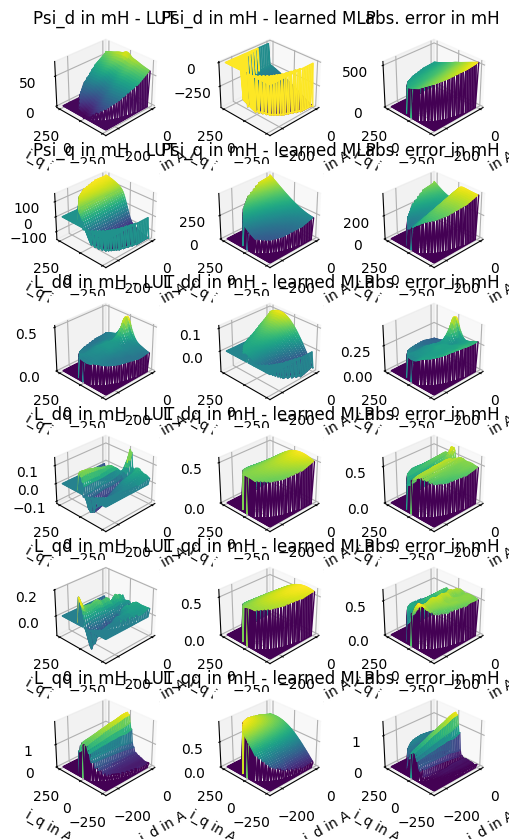

 39%|███▉      | 196975/500000 [19:48<30:28, 165.76it/s] 


KeyboardInterrupt: 

In [22]:
fin_node_14,fin_opt_state,fin_keys,losses, val_losses=mtrainer.fit_non_jit(node,opt_state,keys,plot_every=10_000)
plt.plot(losses)
plt.yscale('log')

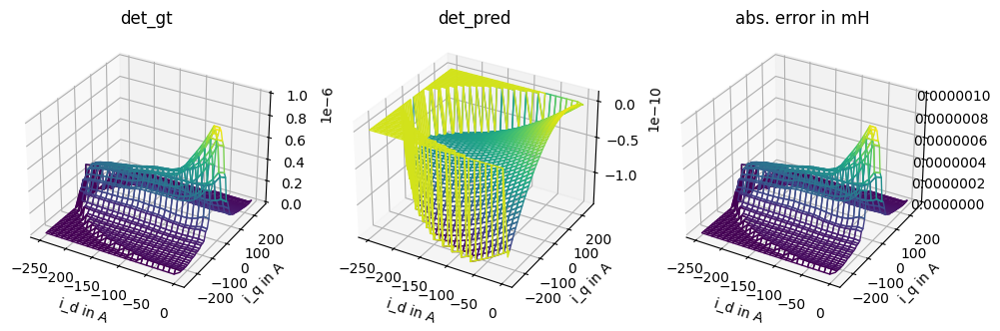

In [23]:
jax_key = jax.random.PRNGKey(20) # 10,11,13 worked 12 not
node = ExpertModel(motor_env=motor_env,psi_layer_sizes=[2,64,64,1],L_layer_sizes=[2,64,64,4],key=jax_key)#NeuralEulerODE([4,128,128,128,128,2],key=jax_key)
opt_state = optimizer_node.init(node)
eval_det(node)

  0%|          | 0/500000 [00:00<?, ?it/s]

180864.58675226325


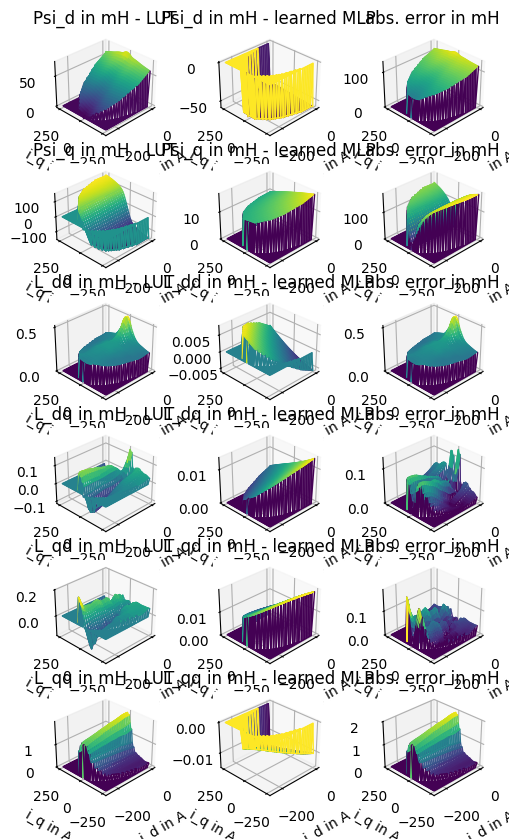

  2%|▏         | 9998/500000 [01:58<1:32:06, 88.67it/s]

3.58799590874144


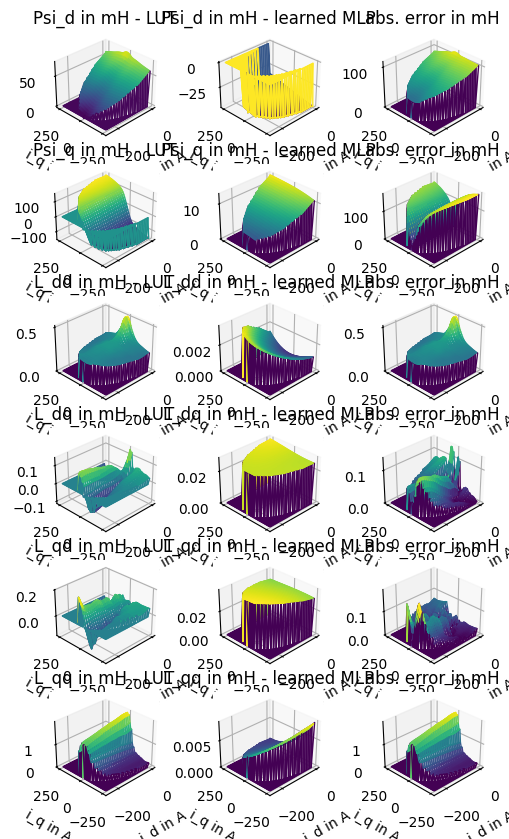

  4%|▍         | 19996/500000 [03:54<1:29:40, 89.22it/s] 

11.270999880246894


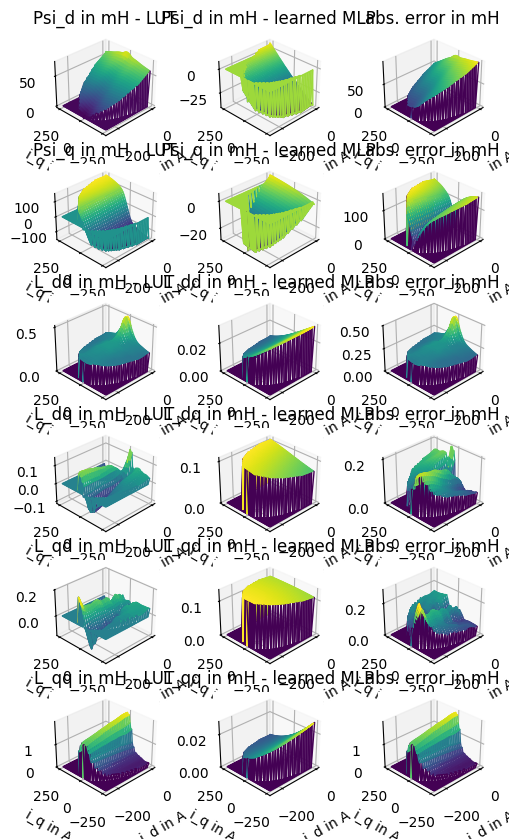

  6%|▌         | 29994/500000 [05:50<1:28:07, 88.89it/s] 

3.4910414554739626


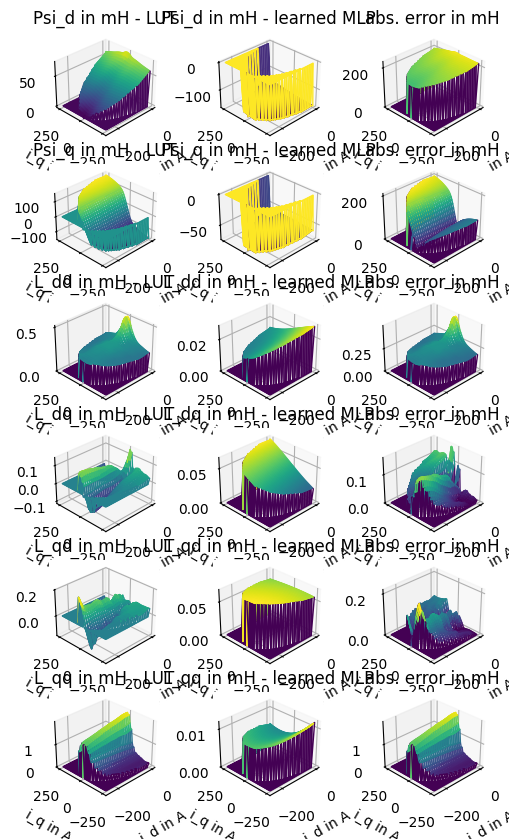

  8%|▊         | 39992/500000 [07:46<1:25:55, 89.23it/s] 

2.978588677745252


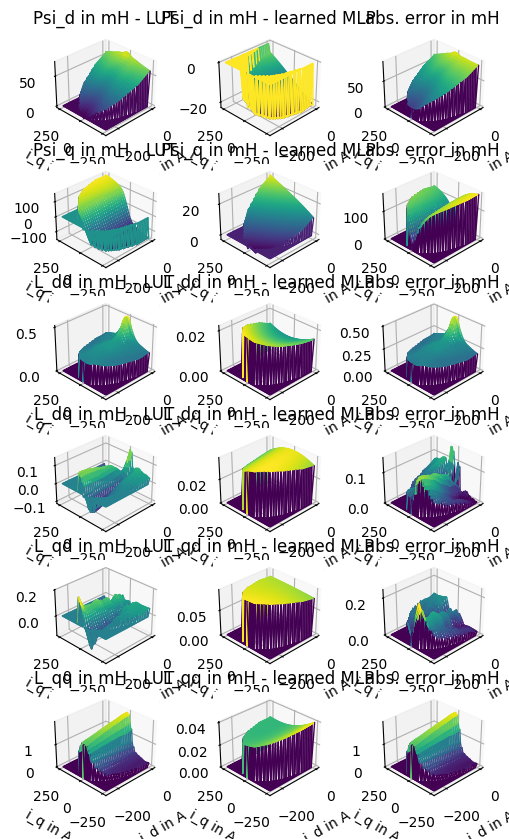

 10%|█         | 50000/500000 [09:43<1:24:05, 89.19it/s] 

2.8273997885490942


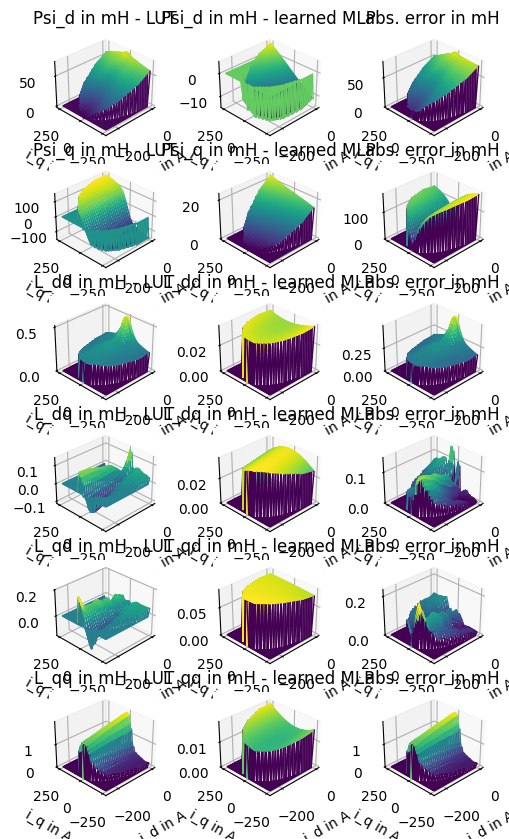

 12%|█▏        | 59998/500000 [11:38<1:22:10, 89.25it/s] 

2.510427468418834


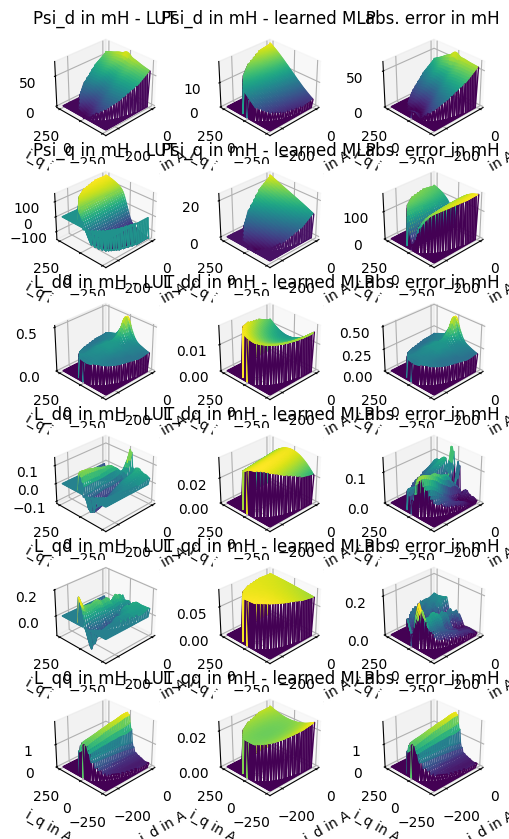

 14%|█▍        | 69997/500000 [13:35<1:20:17, 89.26it/s] 

9.59720167243177


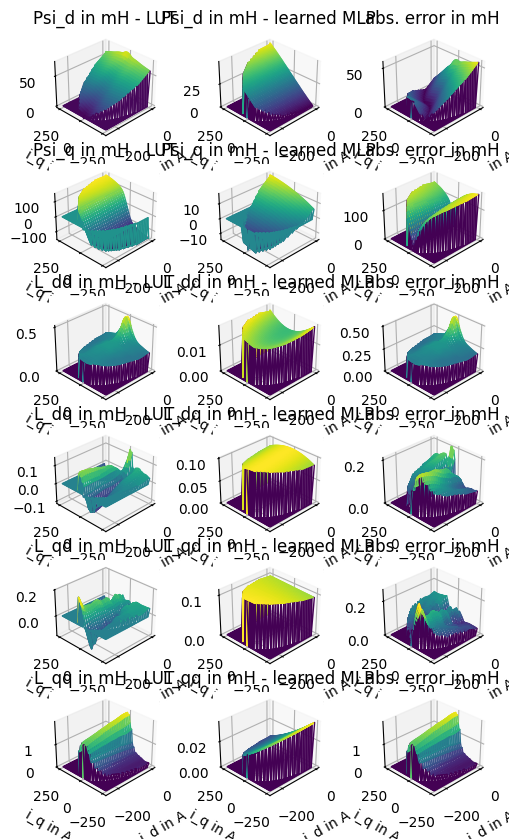

 16%|█▌        | 79999/500000 [15:31<1:18:25, 89.27it/s] 

2.40092786812167


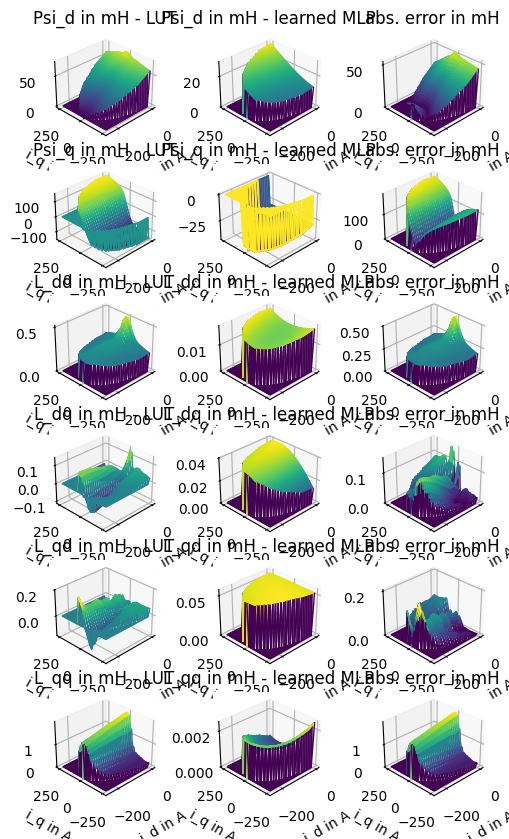

 18%|█▊        | 89998/500000 [17:28<1:17:00, 88.73it/s] 

2.754873443137771


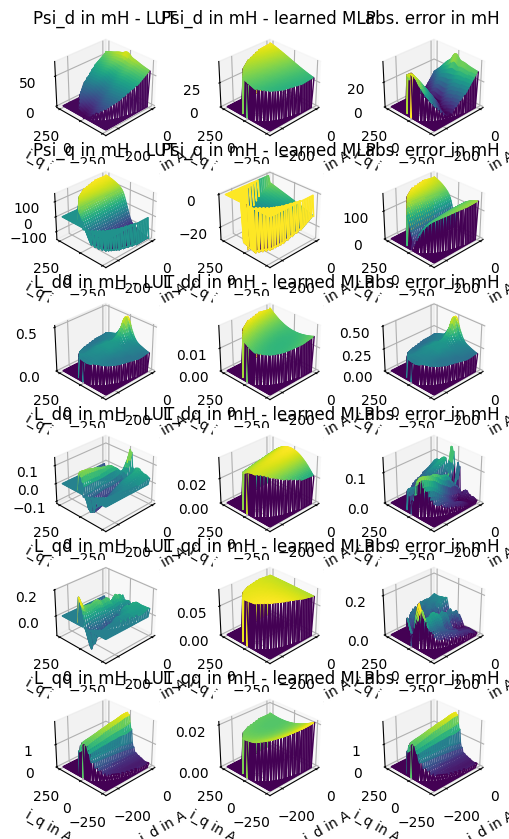

 20%|█▉        | 99996/500000 [19:25<1:15:11, 88.67it/s] 

27852.494488948214


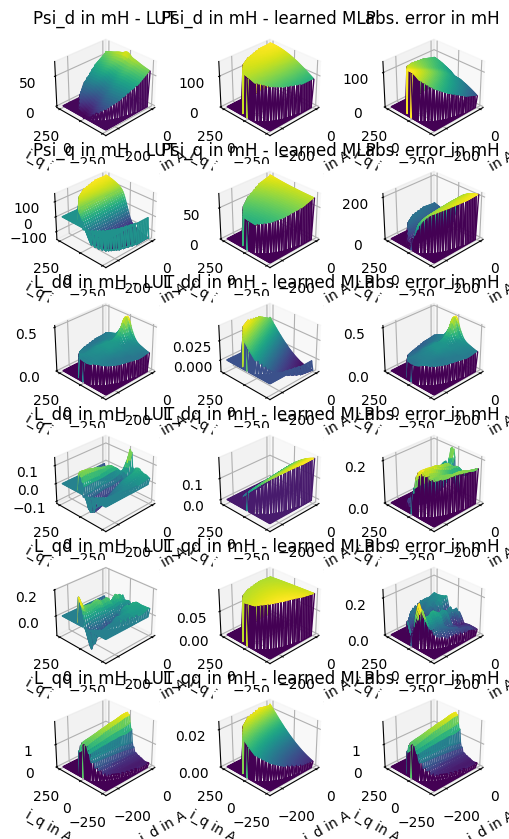

 22%|██▏       | 109993/500000 [21:22<1:12:51, 89.22it/s] 

104667.69977195891


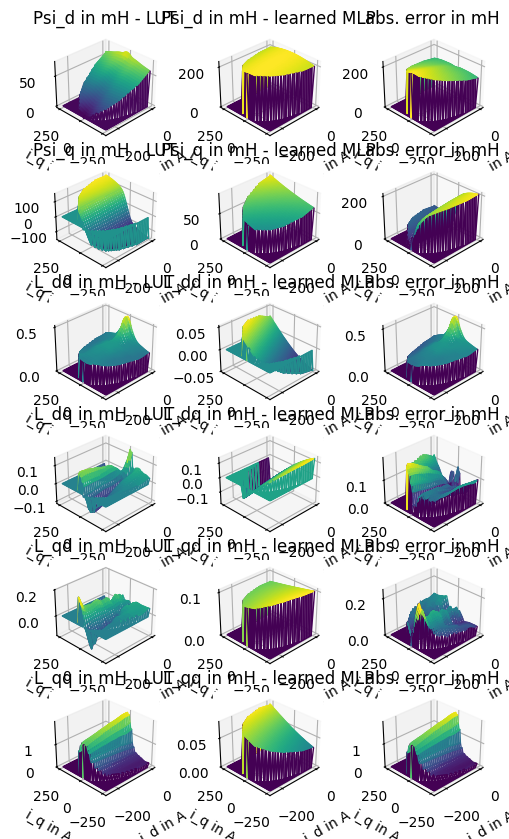

 24%|██▍       | 119998/500000 [23:17<1:11:01, 89.18it/s] 

55004.0984714718


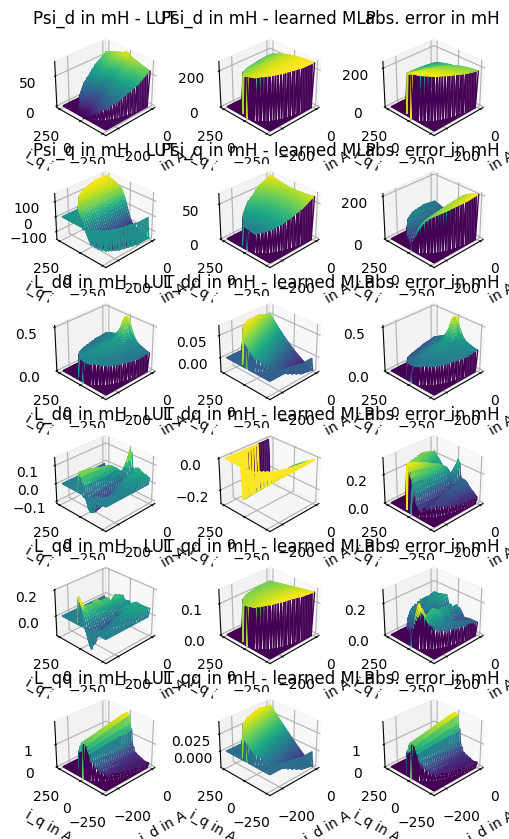

 26%|██▌       | 129993/500000 [25:14<1:09:08, 89.18it/s] 

64495.94801790369


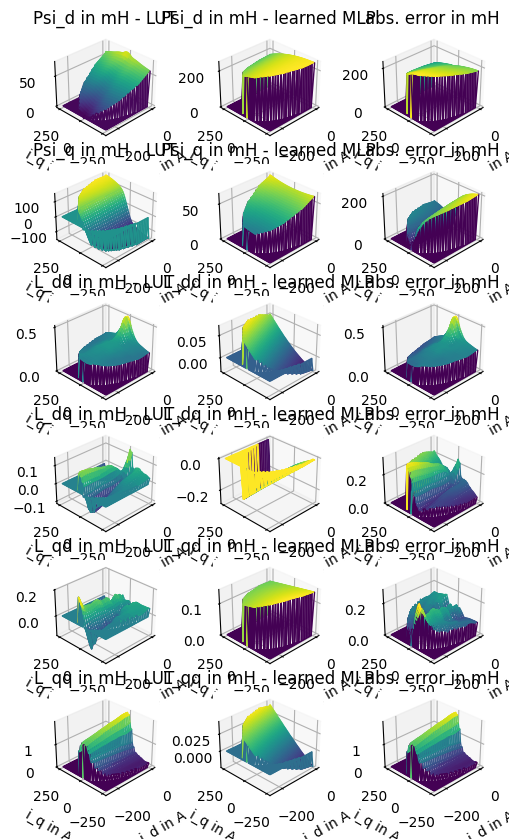

 28%|██▊       | 139993/500000 [27:10<1:07:11, 89.30it/s] 

71524.80165505044


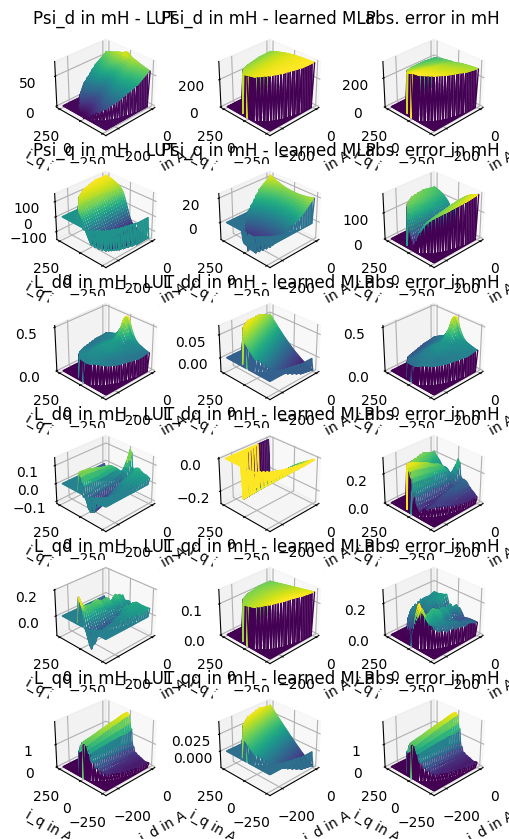

 30%|██▉       | 149997/500000 [29:07<1:05:23, 89.22it/s] 

7978.625030739595


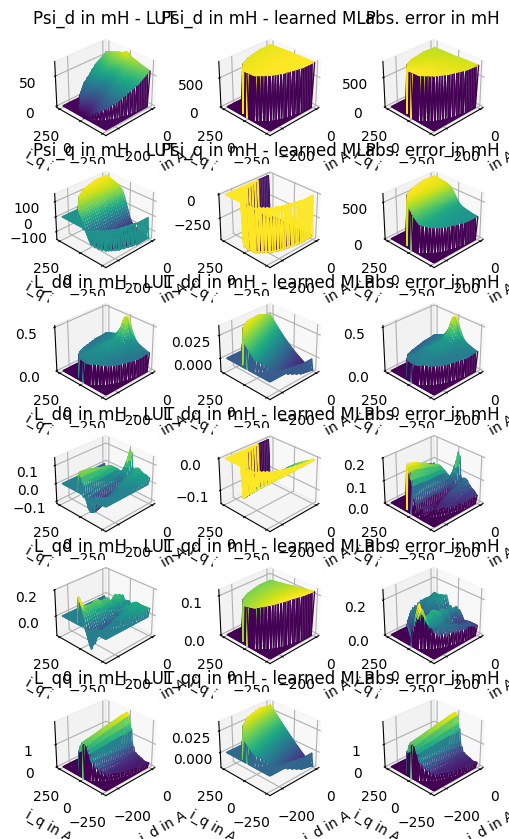

 32%|███▏      | 159996/500000 [31:03<1:03:30, 89.24it/s] 

3447.11145110846


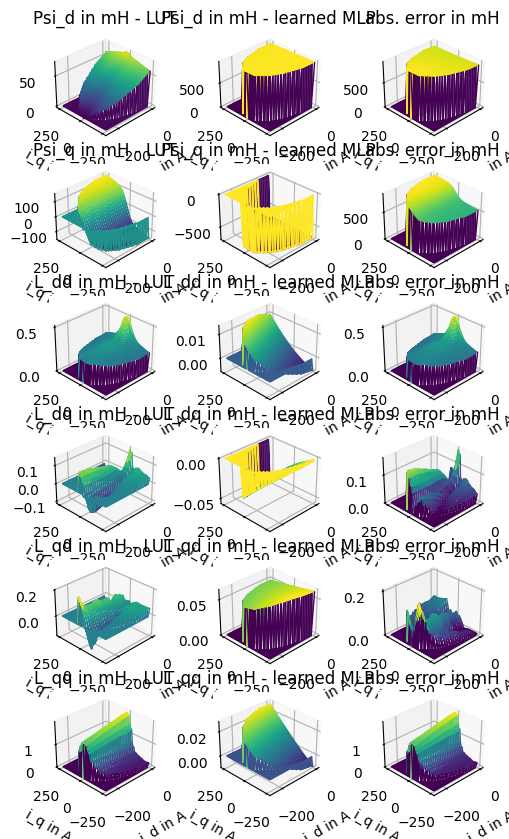

 34%|███▍      | 169992/500000 [32:58<1:01:41, 89.16it/s] 

58.96177835044149


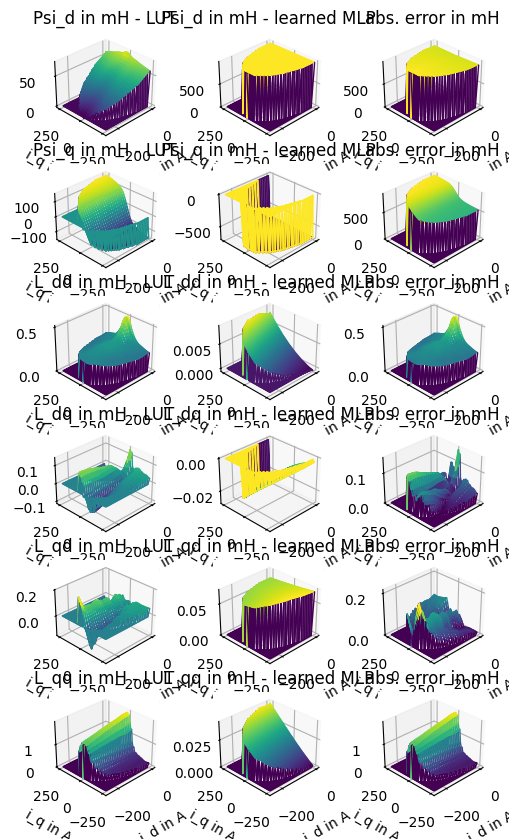

 36%|███▌      | 179992/500000 [34:55<59:44, 89.28it/s]   

2.339736638497167


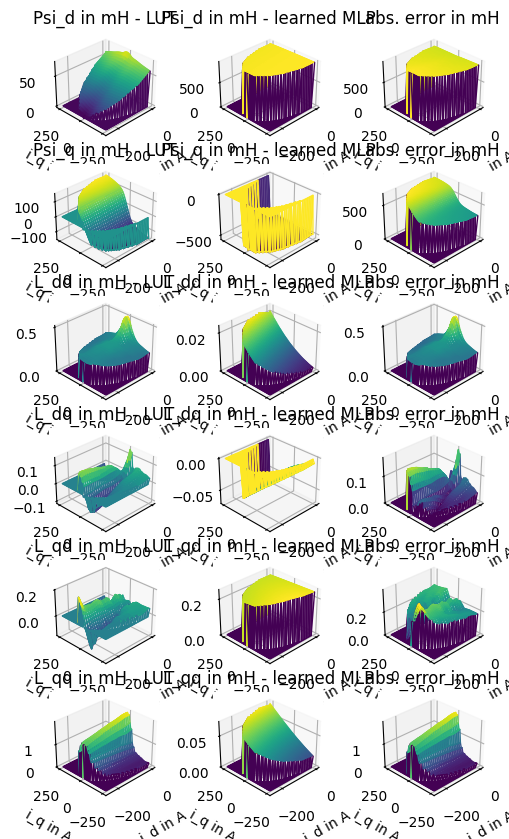

 38%|███▊      | 189998/500000 [36:51<58:03, 88.99it/s]   

0.027893974145022284


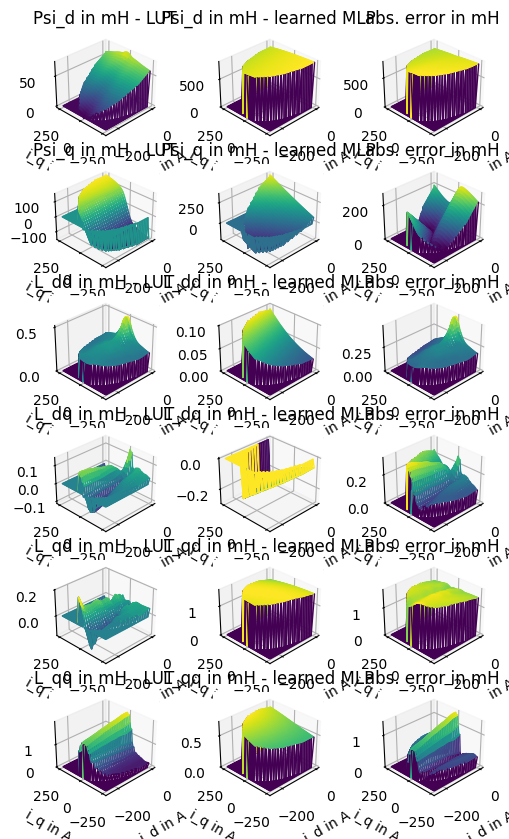

 40%|███▉      | 199996/500000 [38:48<56:02, 89.22it/s]   

0.002876464478152391


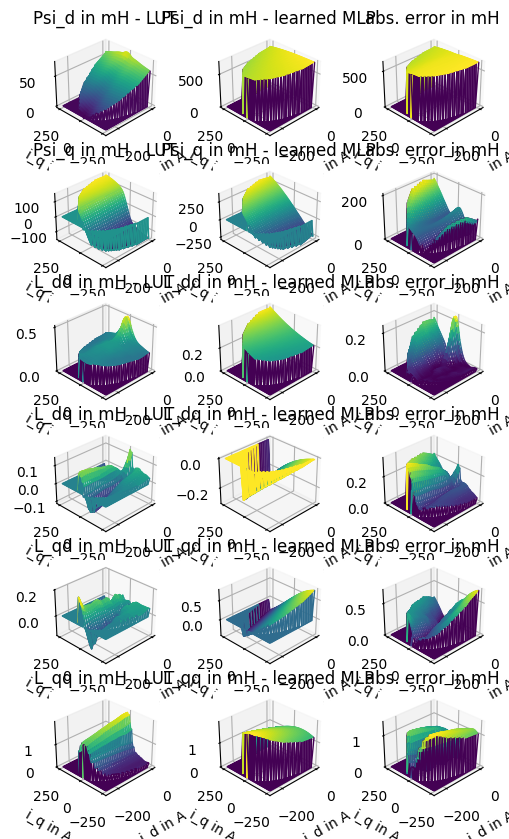

 42%|████▏     | 209995/500000 [40:44<54:11, 89.19it/s]   

858105.2931624389


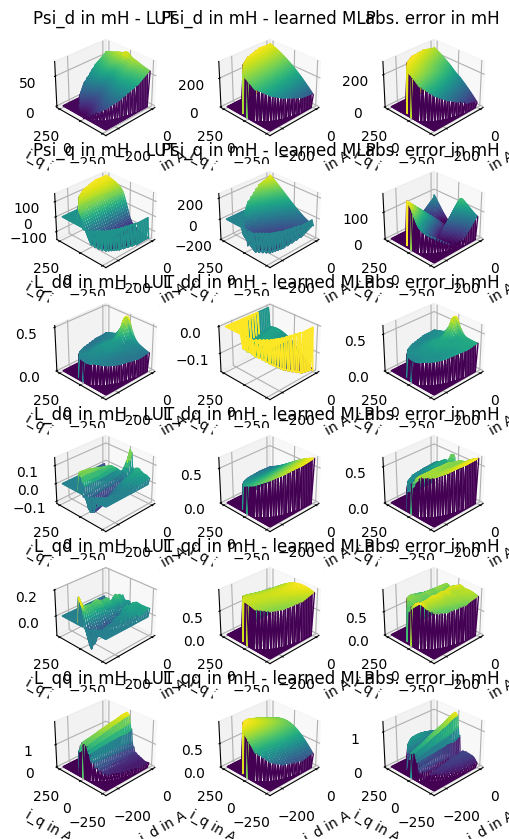

 44%|████▍     | 219993/500000 [42:41<52:20, 89.15it/s]   

348.509604994191


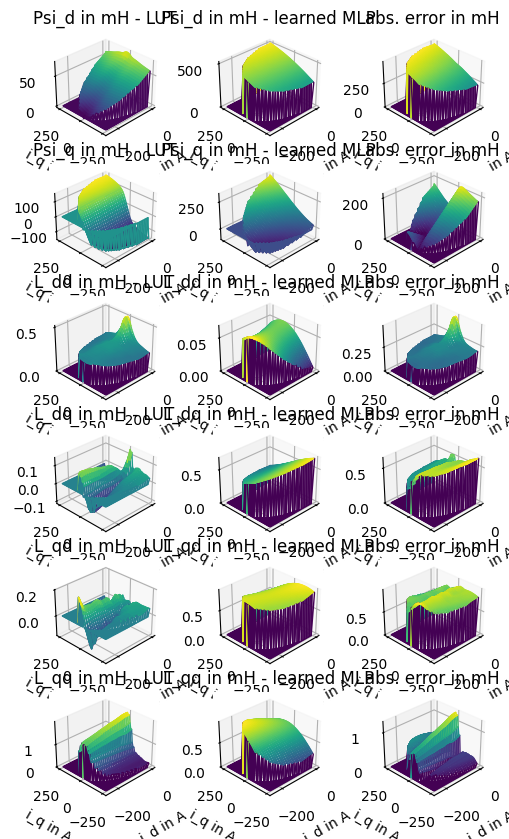

 46%|████▌     | 230000/500000 [44:37<50:26, 89.21it/s]   

77.47624711783644


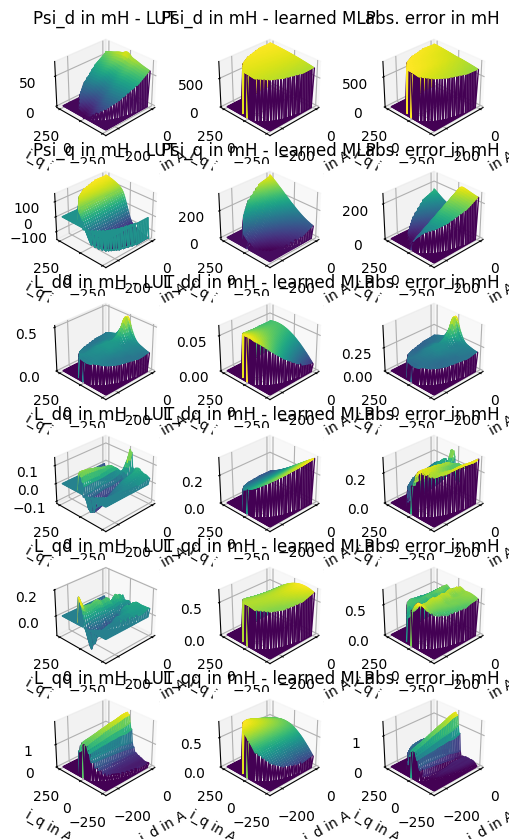

 48%|████▊     | 239993/500000 [46:34<48:35, 89.17it/s]   

0.03227337310739268


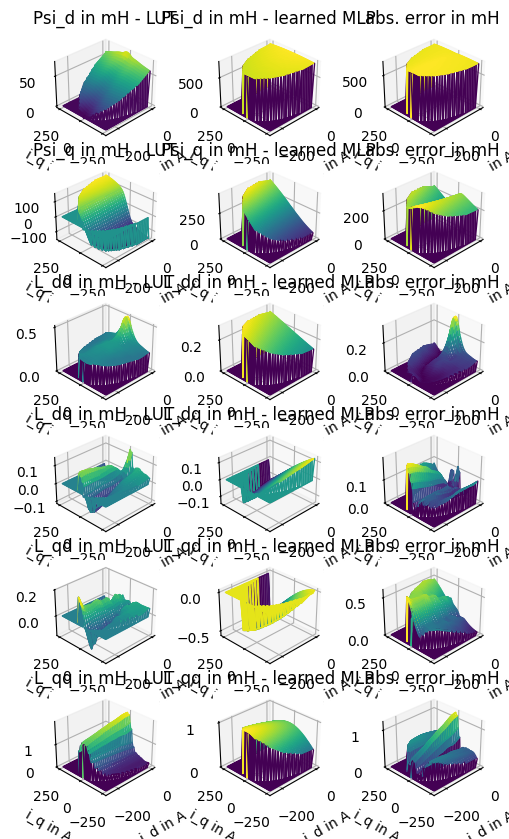

 50%|████▉     | 249994/500000 [48:29<46:40, 89.26it/s]  

0.029021819567806


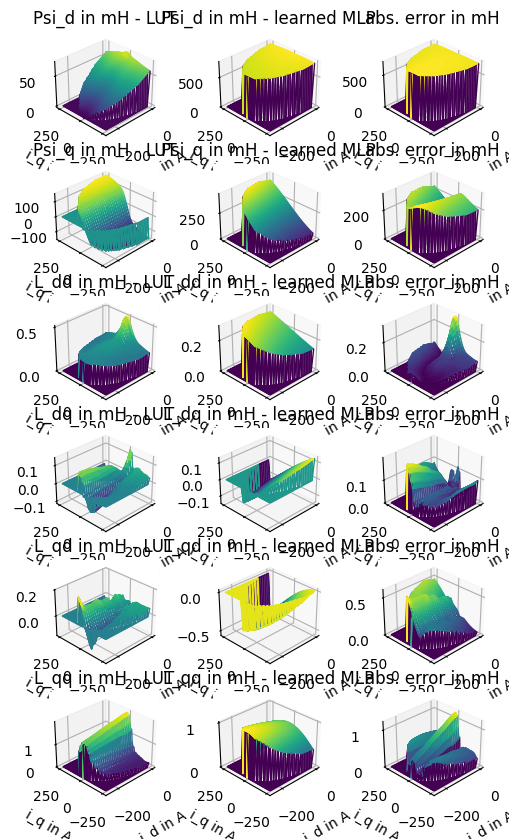

 52%|█████▏    | 259994/500000 [50:27<44:50, 89.20it/s]  

0.006524383398131617


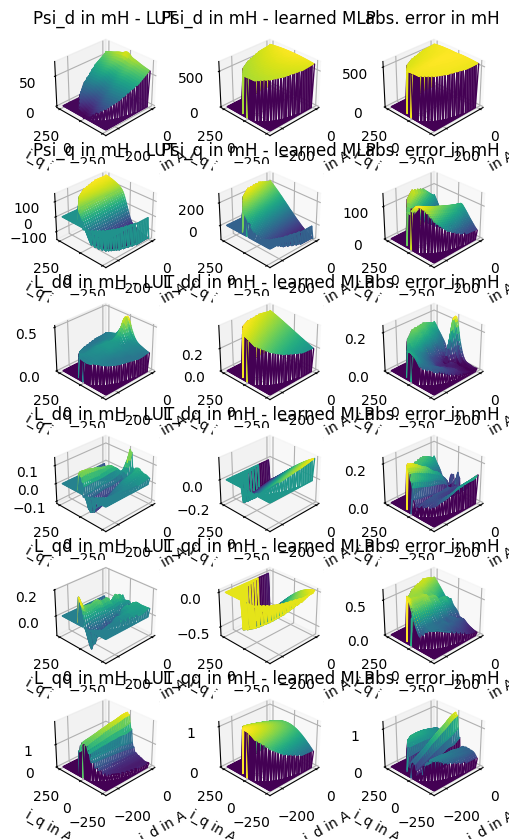

 54%|█████▍    | 269999/500000 [52:22<42:57, 89.22it/s]  

0.0025026222383930695


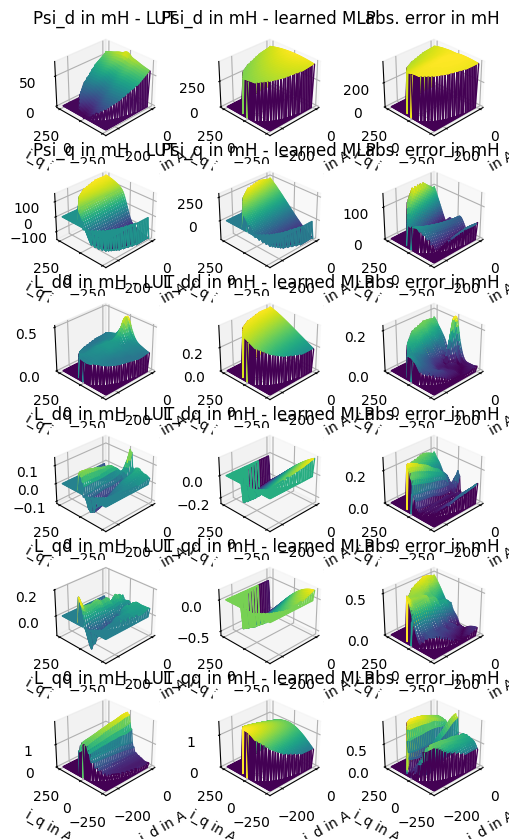

 56%|█████▌    | 279997/500000 [54:18<41:04, 89.27it/s]  

0.00408726512462724


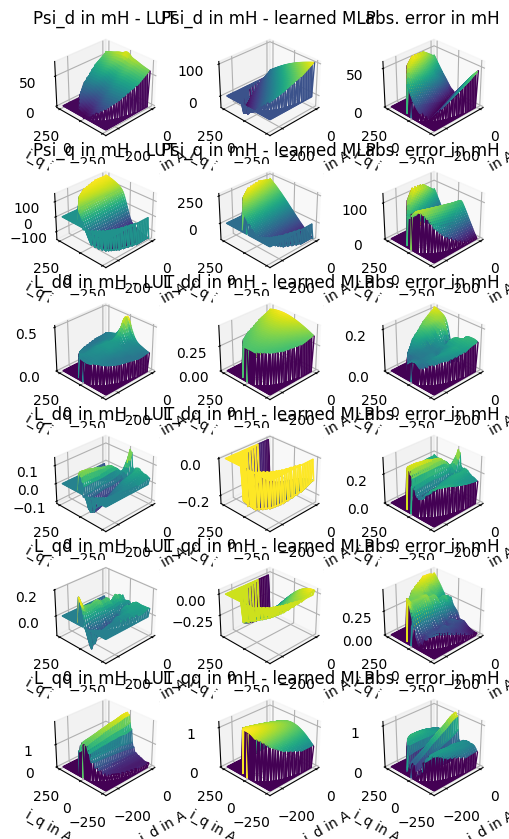

 58%|█████▊    | 289996/500000 [56:15<39:13, 89.23it/s]   

0.0028568480121402206


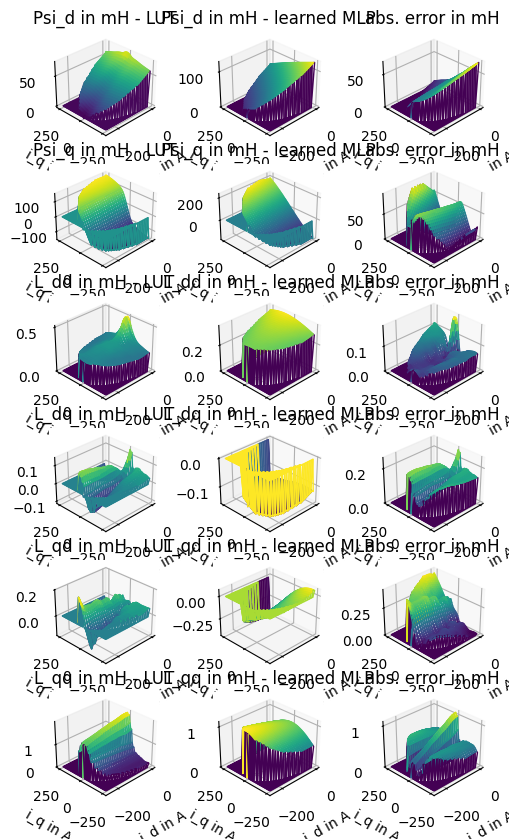

 60%|█████▉    | 299994/500000 [58:11<37:23, 89.15it/s]  

0.0013483583959239575


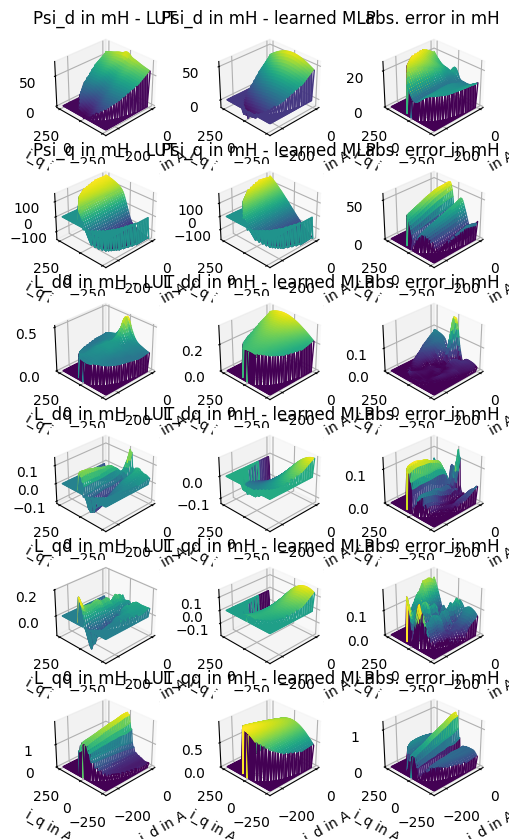

 62%|██████▏   | 309992/500000 [1:00:08<35:30, 89.20it/s]

0.0035768688875487883


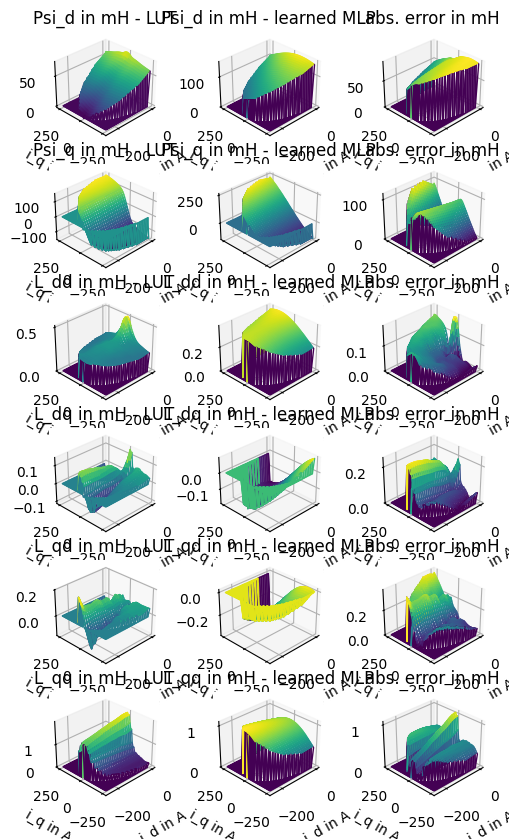

 64%|██████▍   | 319999/500000 [1:02:04<33:37, 89.23it/s]  

0.0014406611484297006


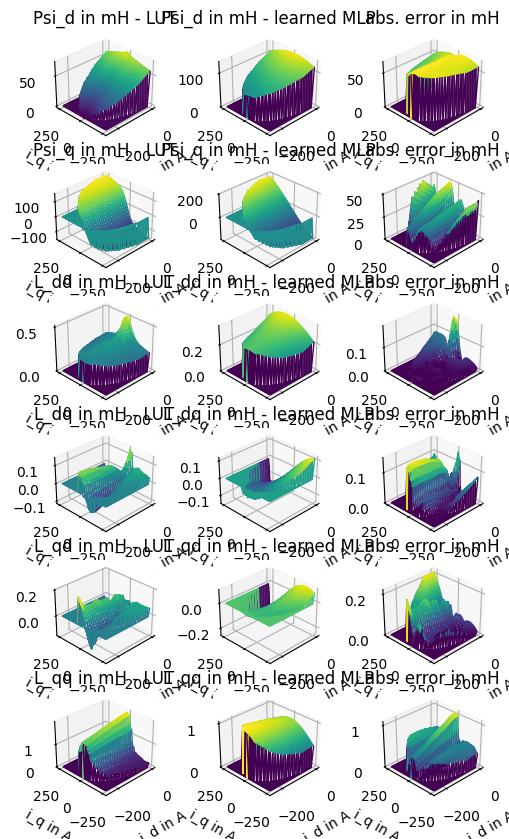

 66%|██████▌   | 329997/500000 [1:04:02<31:43, 89.32it/s]  

0.001121371612948902


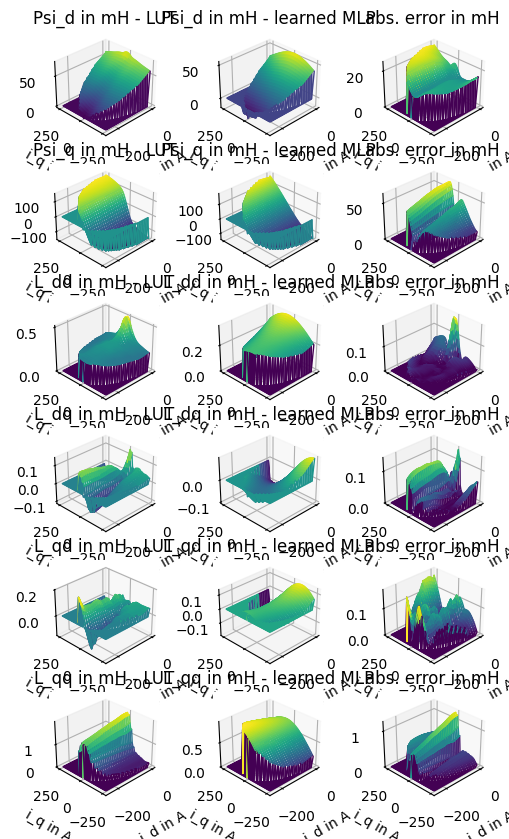

 68%|██████▊   | 339998/500000 [1:05:57<29:54, 89.19it/s]  

0.0027343877524844966


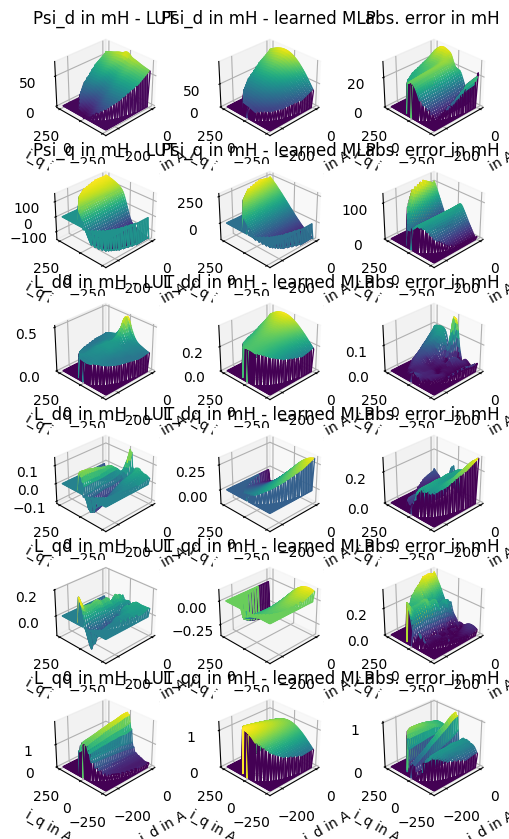

 70%|██████▉   | 349998/500000 [1:07:53<28:01, 89.21it/s]  

0.0015509732171012376


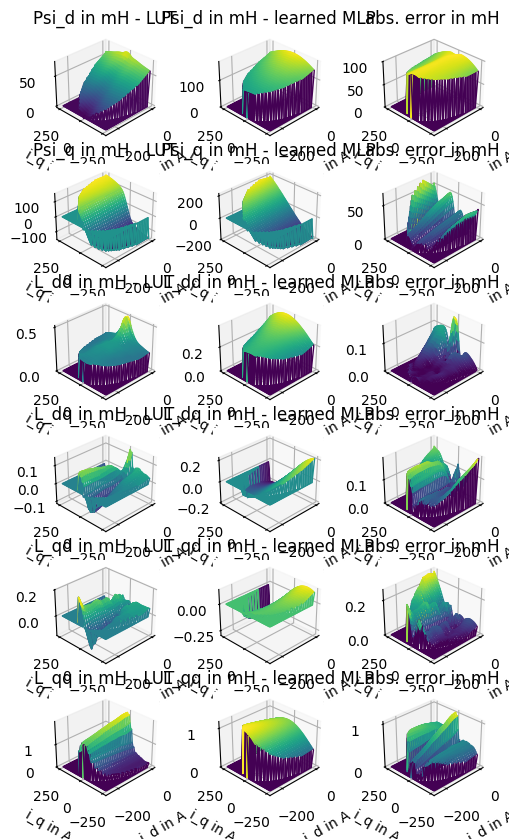

 72%|███████▏  | 359996/500000 [1:09:51<26:17, 88.77it/s]  

0.0013715018273402293


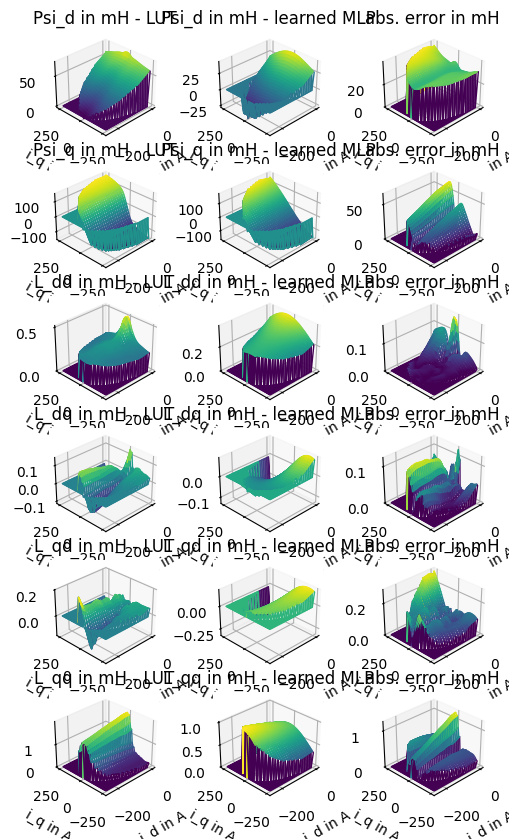

 74%|███████▍  | 369993/500000 [1:11:47<24:16, 89.29it/s]  

0.0013152814260661736


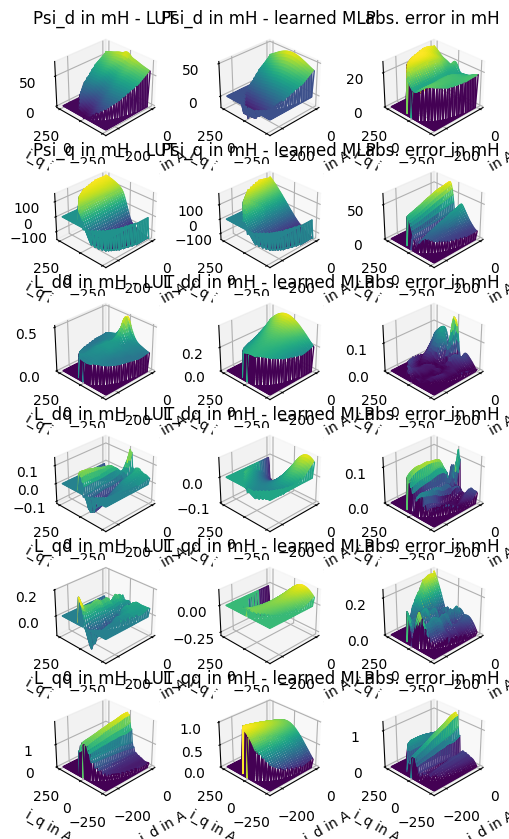

 76%|███████▌  | 380000/500000 [1:13:45<22:27, 89.09it/s]  

0.01007689085126857


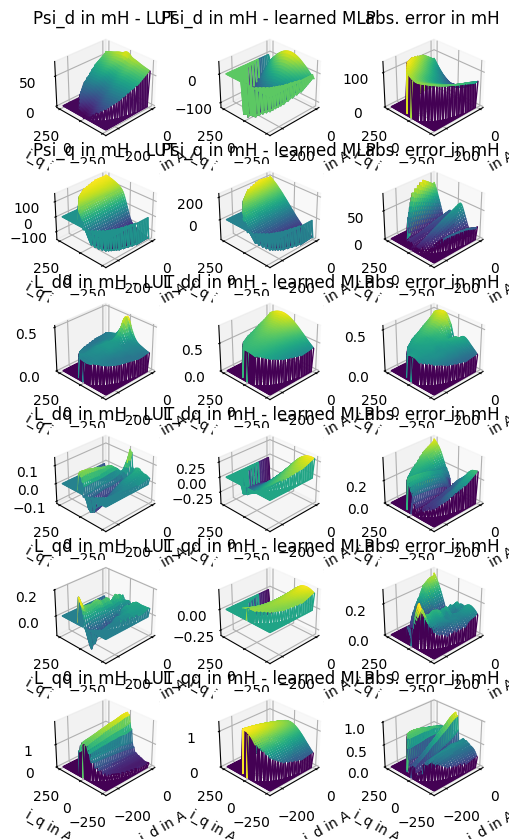

 78%|███████▊  | 389992/500000 [1:15:41<20:41, 88.61it/s]  

0.010725465968613767


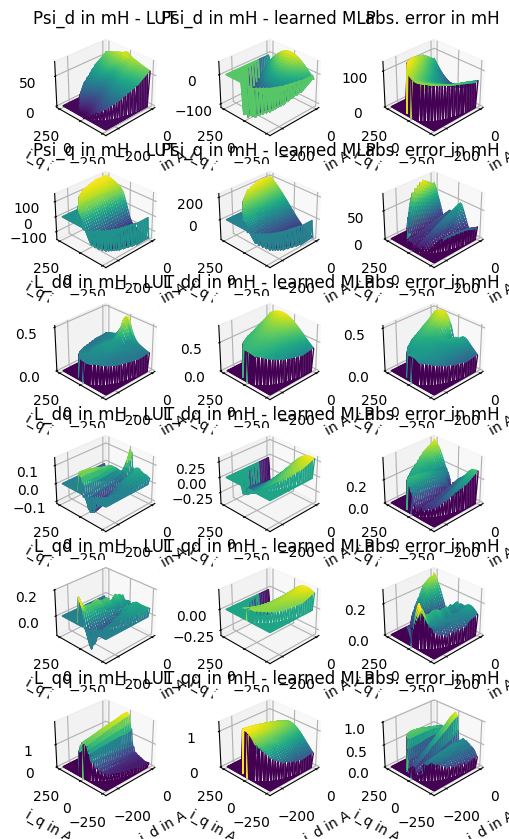

 80%|████████  | 400000/500000 [1:17:38<18:40, 89.21it/s]  

0.001197222191323199


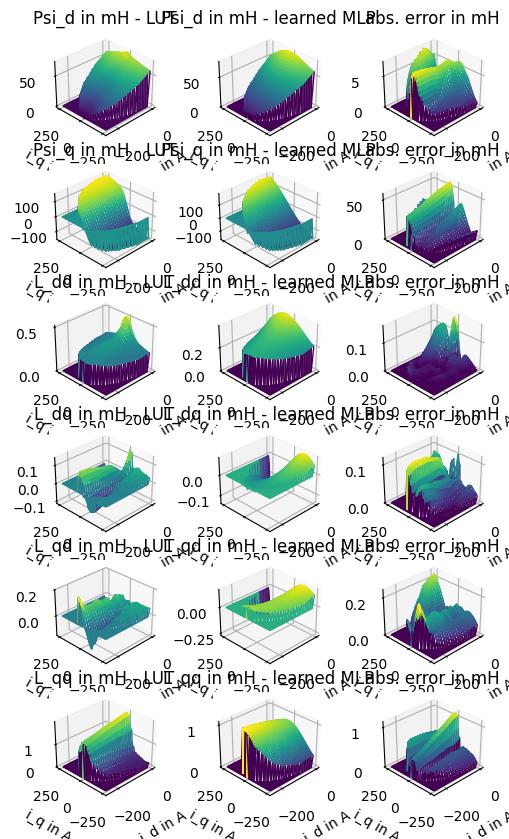

 82%|████████▏ | 410000/500000 [1:19:35<16:48, 89.28it/s]  

0.00303005172308906


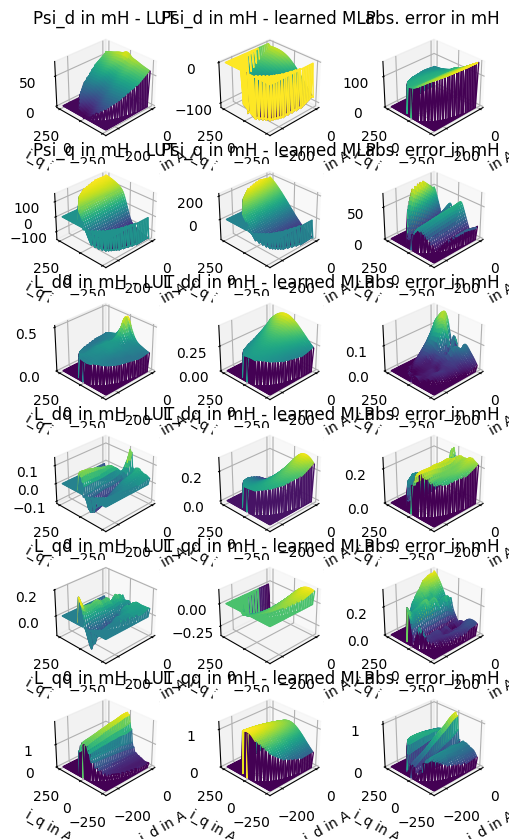

 84%|████████▍ | 419999/500000 [1:21:31<14:56, 89.25it/s]  

0.001339152137865576


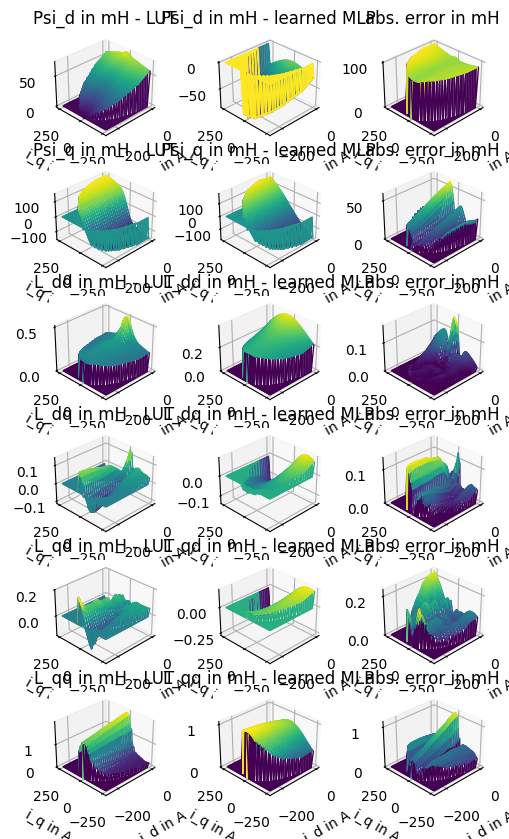

 86%|████████▌ | 429999/500000 [1:23:28<13:04, 89.22it/s]  

0.006081576554207182


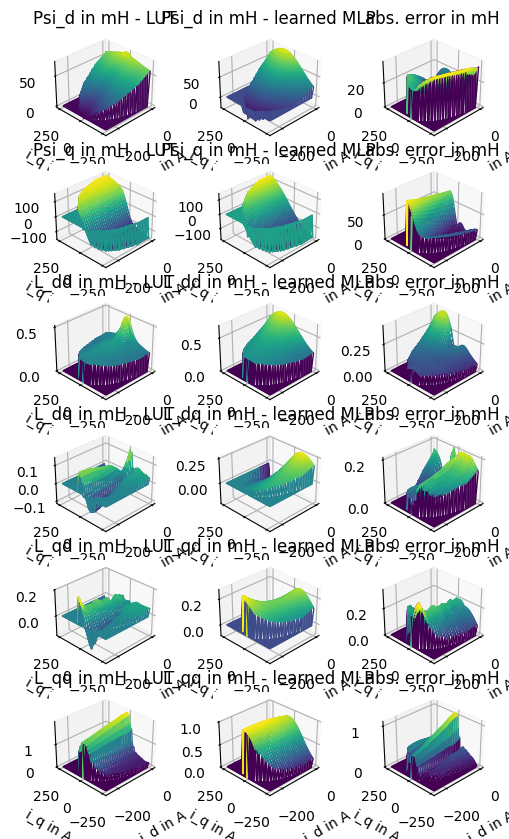

 88%|████████▊ | 439998/500000 [1:25:24<11:12, 89.23it/s]  

0.015062986542034836


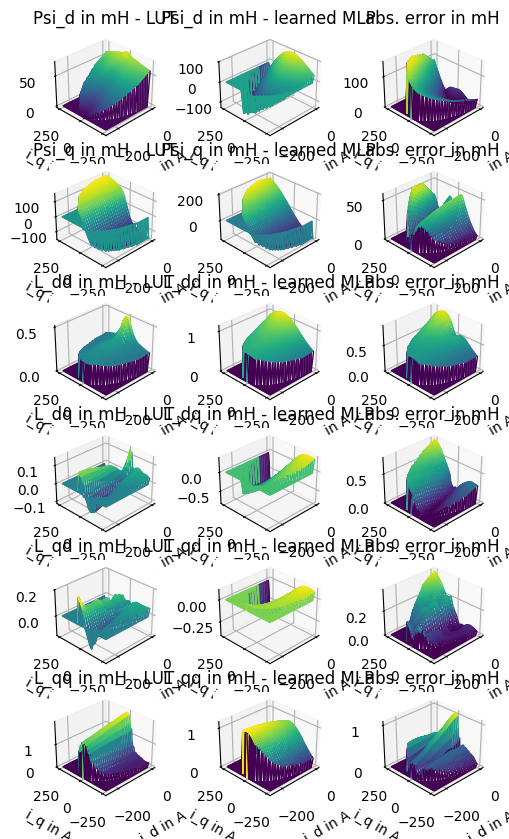

 90%|████████▉ | 449998/500000 [1:27:20<09:20, 89.28it/s]  

0.011619883477064287


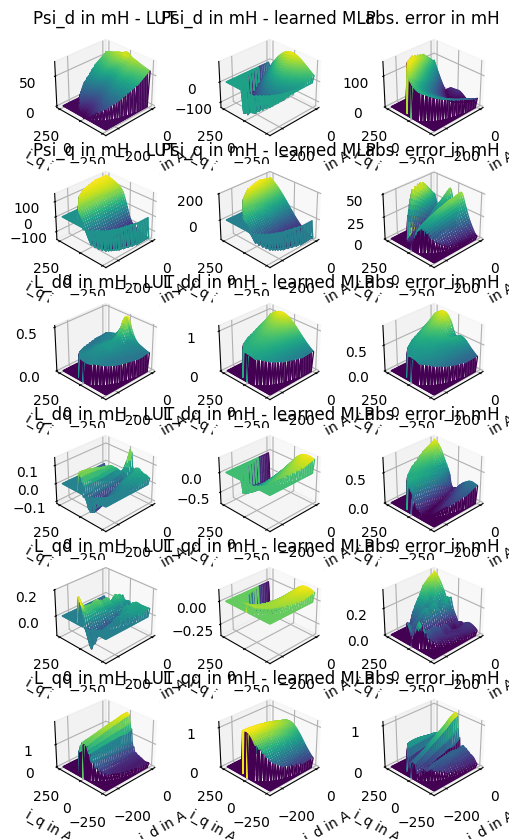

 92%|█████████▏| 459994/500000 [1:29:17<07:30, 88.75it/s]  

0.001171490855797578


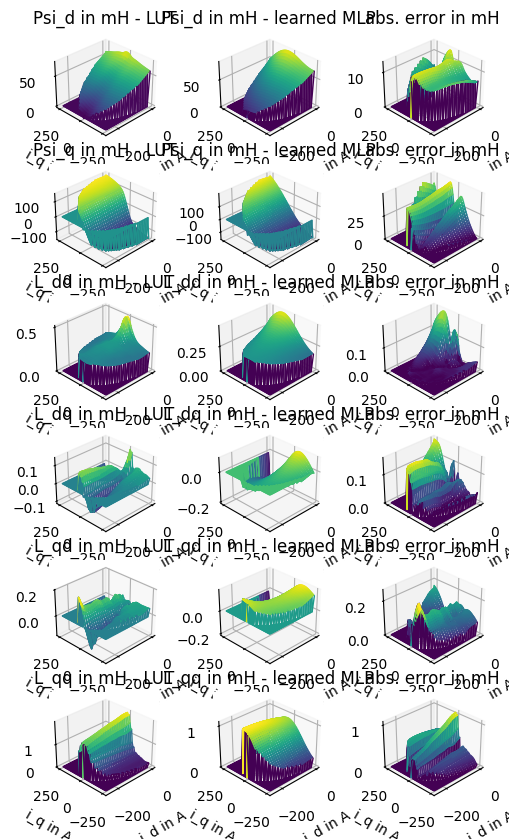

 94%|█████████▍| 469994/500000 [1:31:14<05:36, 89.27it/s]  

0.0009245945009075995


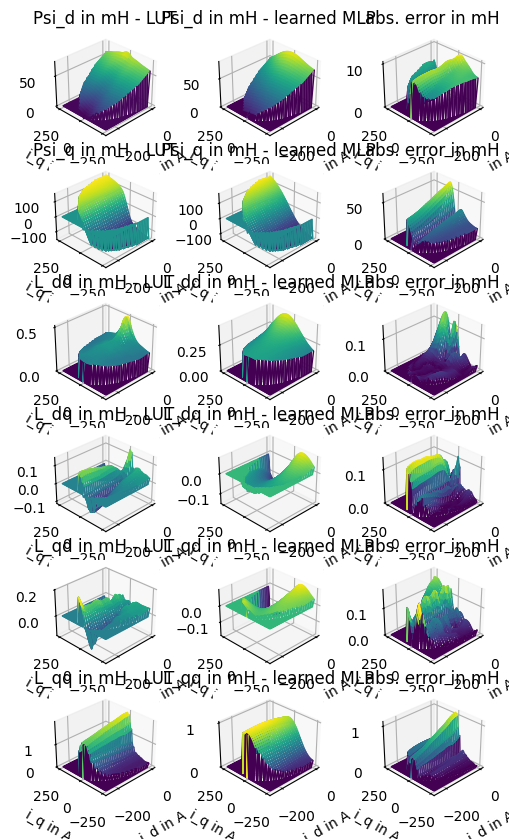

 96%|█████████▌| 479993/500000 [1:33:09<03:44, 89.27it/s]  

0.0001877978261838352


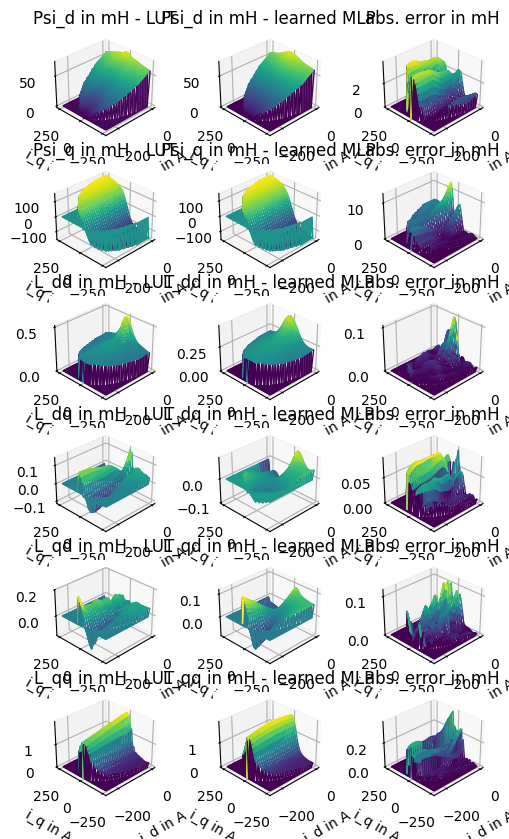

 98%|█████████▊| 489998/500000 [1:35:07<01:52, 89.21it/s]  

7.663848596690144e-05


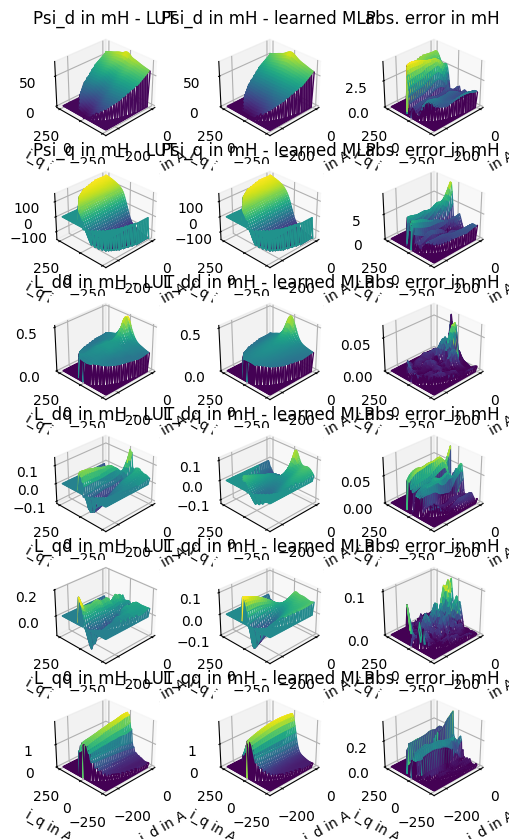

100%|██████████| 500000/500000 [1:37:03<00:00, 85.86it/s]


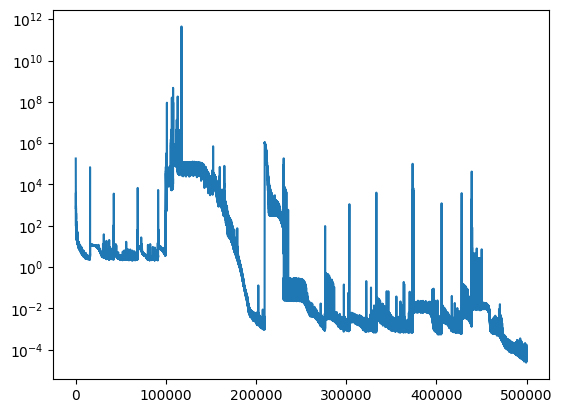

In [24]:
fin_node_20,fin_opt_state,fin_keys,losses, val_losses=mtrainer.fit_non_jit(node,opt_state,keys,plot_every=10_000)
plt.plot(losses)
plt.yscale('log')

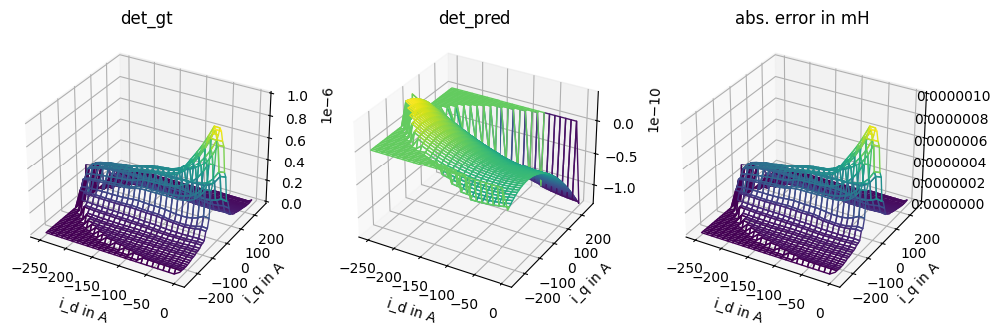

In [25]:
jax_key = jax.random.PRNGKey(21) # 10,11,13 worked 12 not
node = ExpertModel(motor_env=motor_env,psi_layer_sizes=[2,64,64,1],L_layer_sizes=[2,64,64,4],key=jax_key)#NeuralEulerODE([4,128,128,128,128,2],key=jax_key)
opt_state = optimizer_node.init(node)
eval_det(node)

  0%|          | 0/500000 [00:00<?, ?it/s]

109154.83124628417


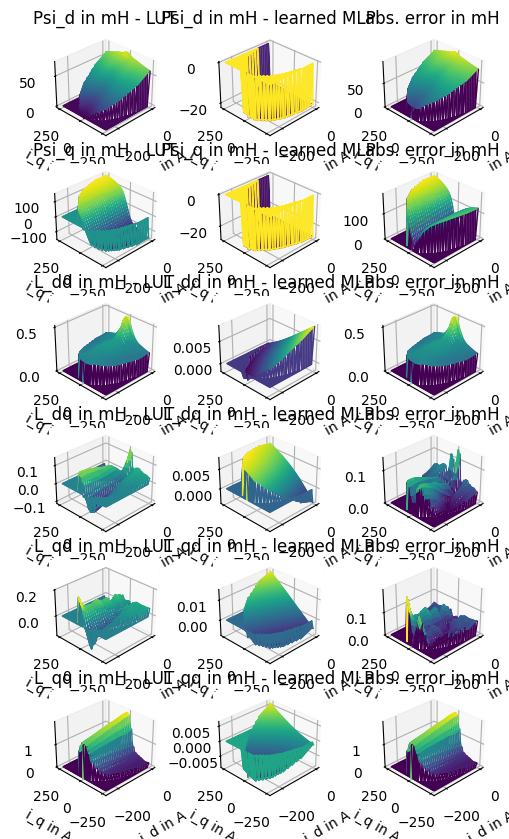

  2%|▏         | 9996/500000 [01:55<1:31:31, 89.22it/s]

11473.21520989333


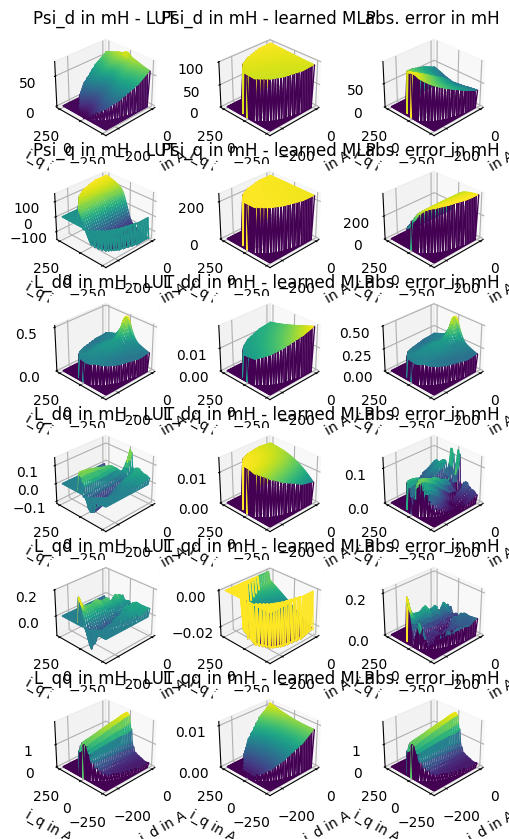

  4%|▍         | 19995/500000 [03:53<1:29:43, 89.16it/s] 

22.734561604271175


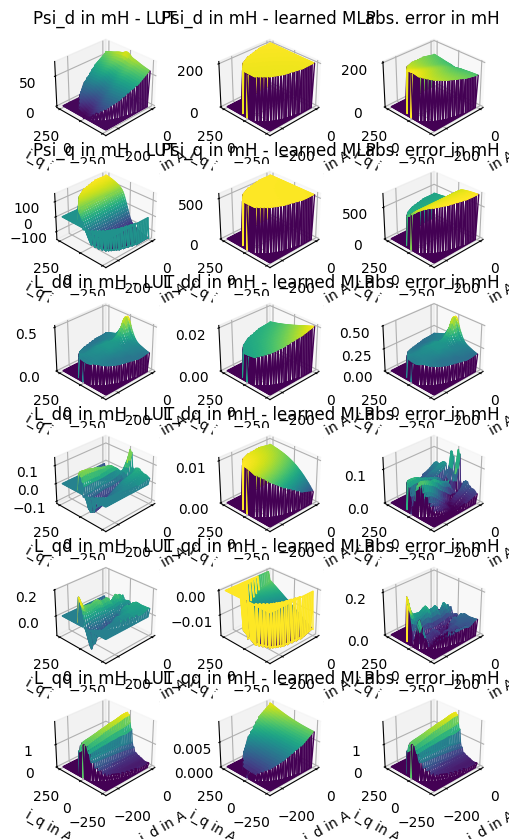

  6%|▌         | 29994/500000 [05:48<1:27:57, 89.07it/s] 

7.555916927616998


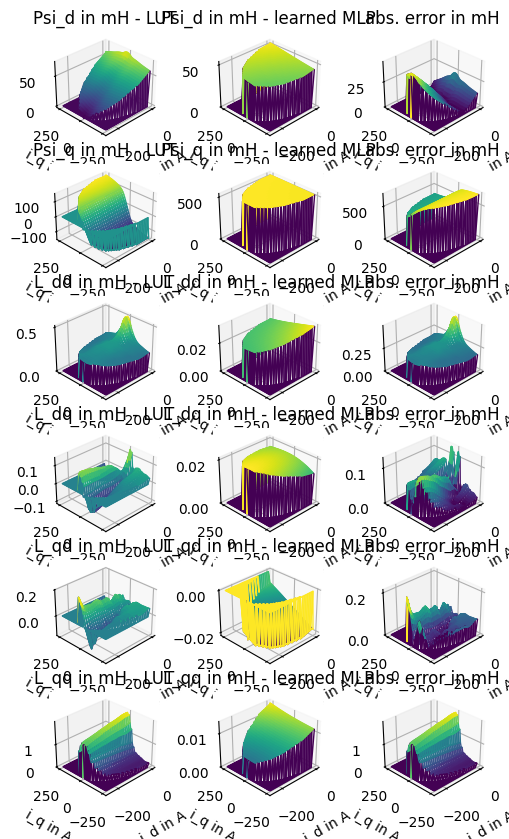

  8%|▊         | 39998/500000 [07:44<1:26:05, 89.06it/s] 

0.244904723396119


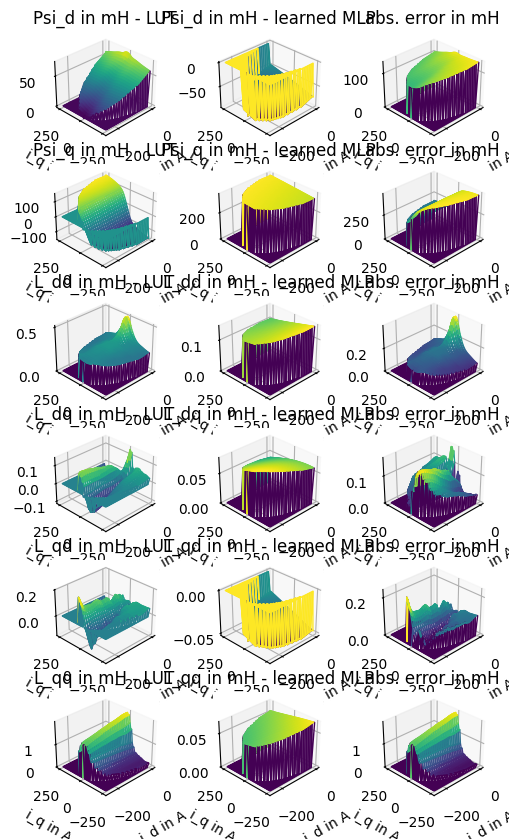

 10%|▉         | 49995/500000 [09:40<1:24:03, 89.23it/s] 

0.005642577395142863


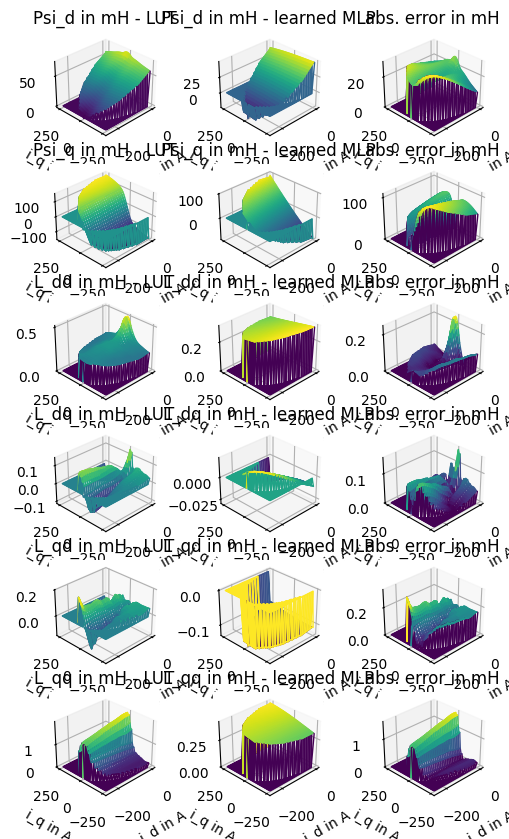

 12%|█▏        | 59996/500000 [11:38<1:22:12, 89.20it/s] 

0.001677476181267506


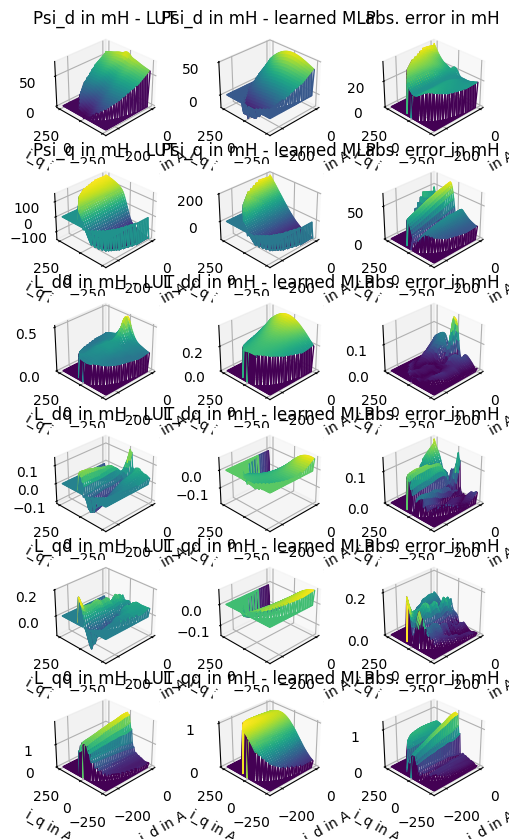

 14%|█▍        | 69996/500000 [13:34<1:20:25, 89.11it/s] 

0.0002981117889883823


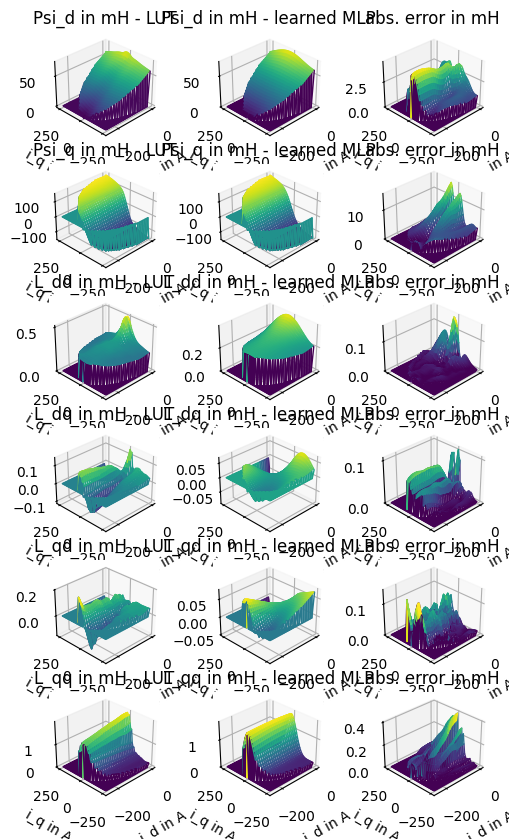

 16%|█▌        | 79994/500000 [15:30<1:18:25, 89.26it/s] 

0.00013772395997696093


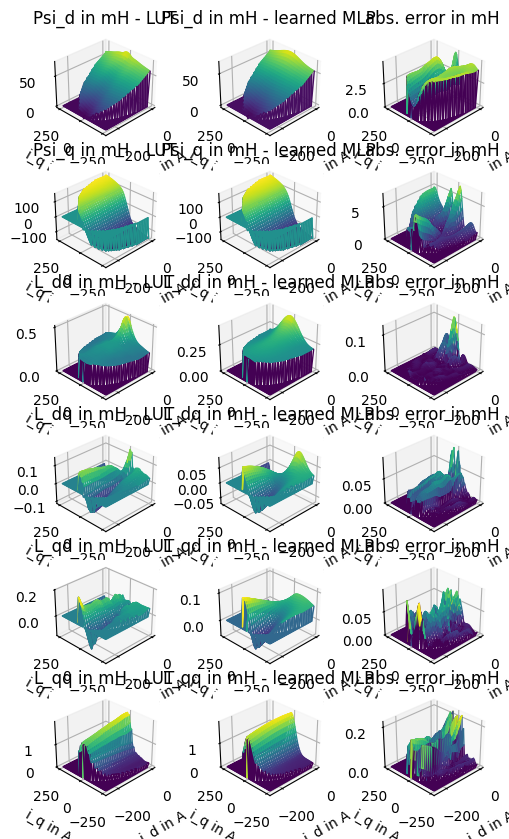

 18%|█▊        | 89996/500000 [17:28<1:16:34, 89.25it/s] 

8.203494243227612e-05


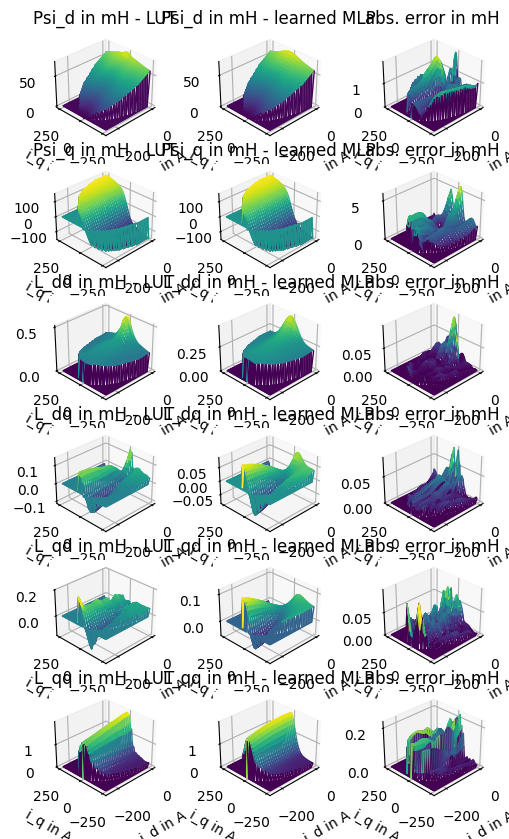

 20%|█▉        | 99996/500000 [19:24<1:14:57, 88.94it/s] 

4.454340820075939e-05


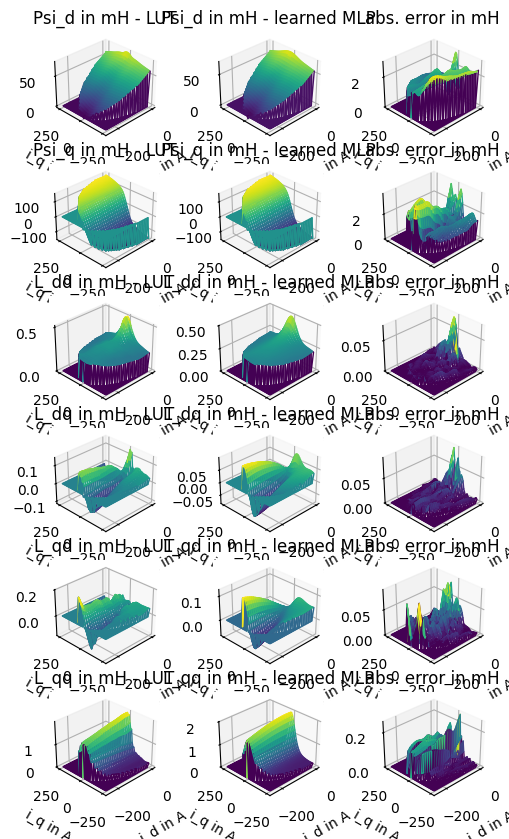

 20%|██        | 100000/500000 [19:28<1:17:52, 85.60it/s]


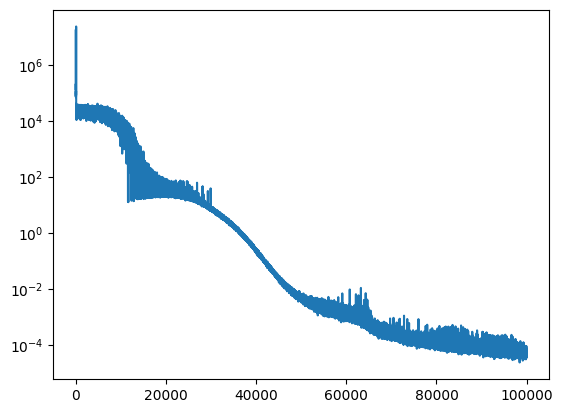

In [26]:
fin_node_21,fin_opt_state,fin_keys,losses, val_losses=mtrainer.fit_non_jit(node,opt_state,keys,plot_every=10_000)
plt.plot(losses)
plt.yscale('log')

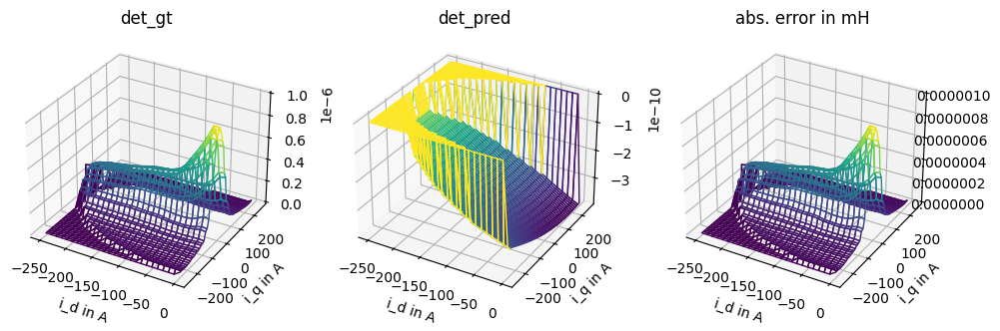

In [27]:
jax_key = jax.random.PRNGKey(22) # 10,11,13 worked 12 not
node = ExpertModel(motor_env=motor_env,psi_layer_sizes=[2,64,64,1],L_layer_sizes=[2,64,64,4],key=jax_key)#NeuralEulerODE([4,128,128,128,128,2],key=jax_key)
opt_state = optimizer_node.init(node)
eval_det(node)

  0%|          | 0/500000 [00:00<?, ?it/s]

130431.66714508427


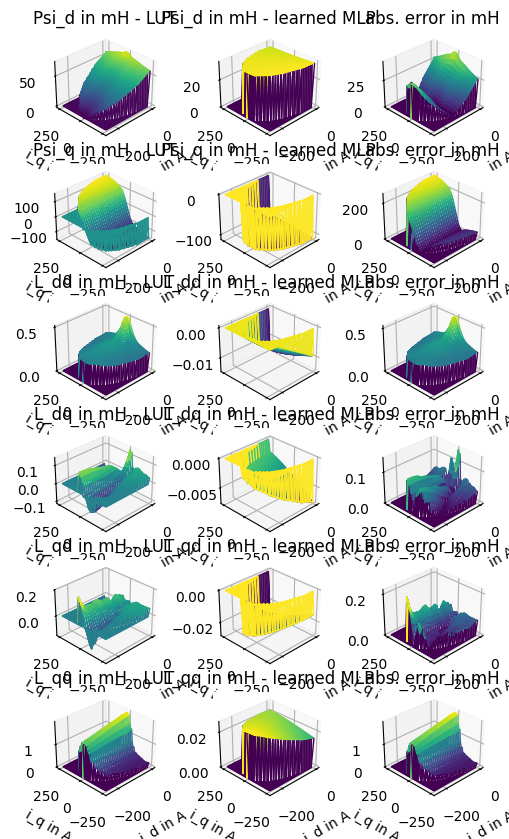

  2%|▏         | 9995/500000 [01:57<1:31:33, 89.20it/s]

2.8093758491066803


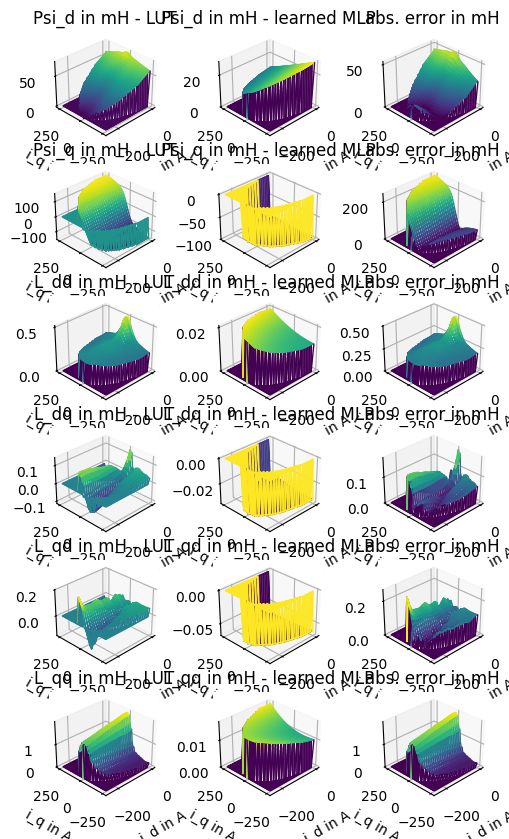

  4%|▍         | 19999/500000 [03:54<1:29:40, 89.22it/s] 

3.209930331601395


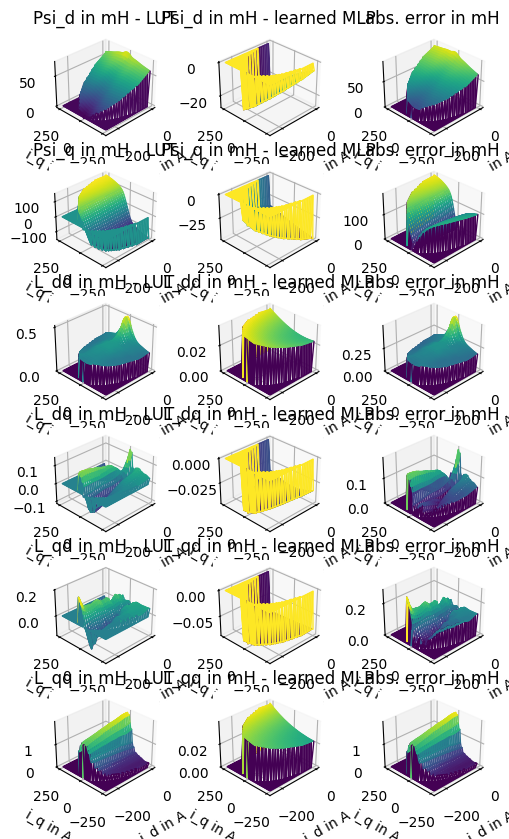

  6%|▌         | 30000/500000 [05:50<1:28:37, 88.39it/s] 

3.087342992684547


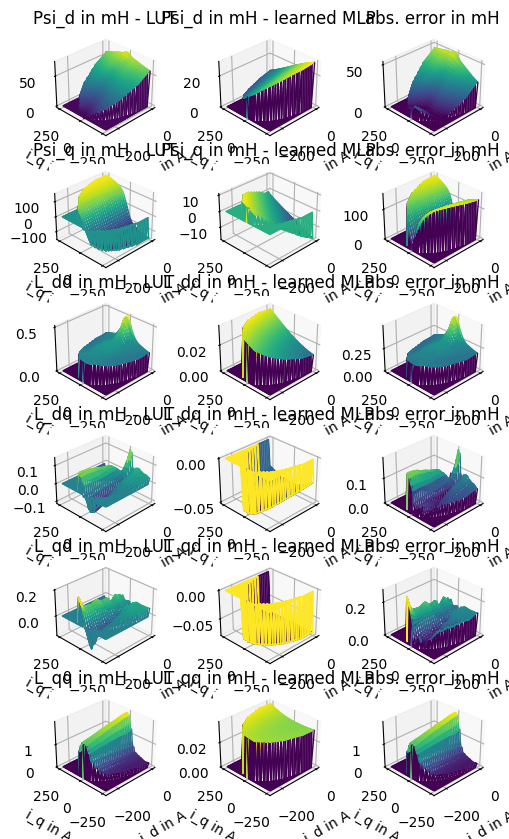

  8%|▊         | 39998/500000 [07:47<1:26:03, 89.09it/s] 

2.6974908036051444


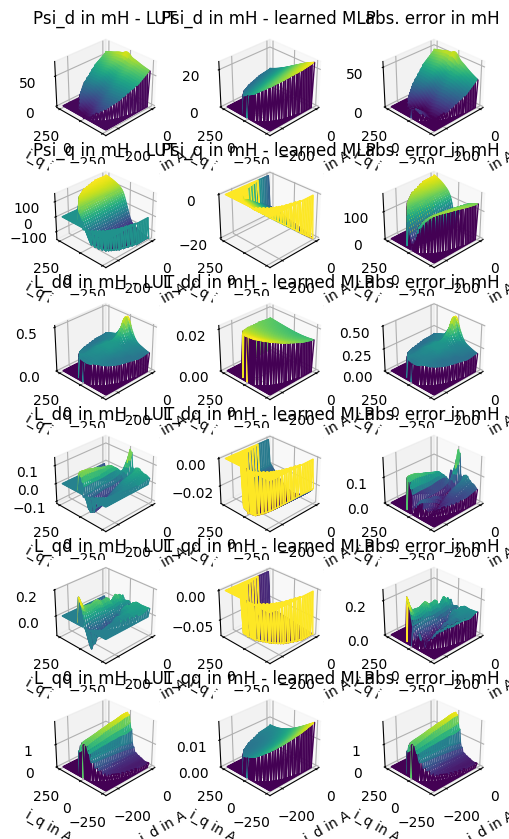

 10%|▉         | 49995/500000 [09:43<1:24:35, 88.66it/s] 

2.15148303925109


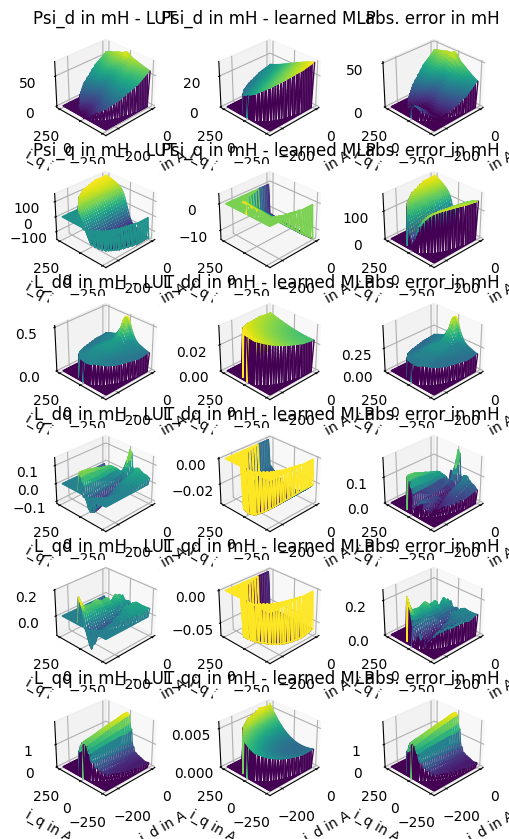

 12%|█▏        | 59993/500000 [11:41<1:22:11, 89.23it/s] 

2.2289177317294233


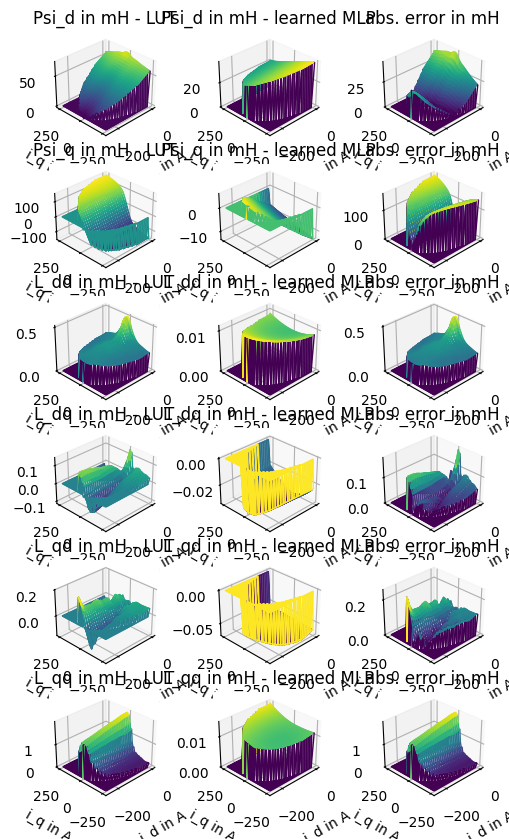

 14%|█▍        | 69992/500000 [13:37<1:20:18, 89.24it/s] 

2.4651024821720378


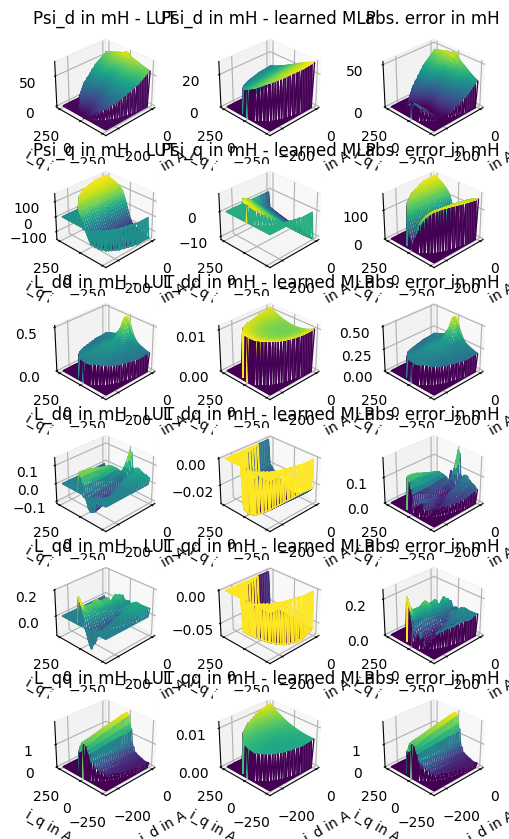

 16%|█▌        | 80000/500000 [15:33<1:18:29, 89.18it/s] 

2.644837505687936


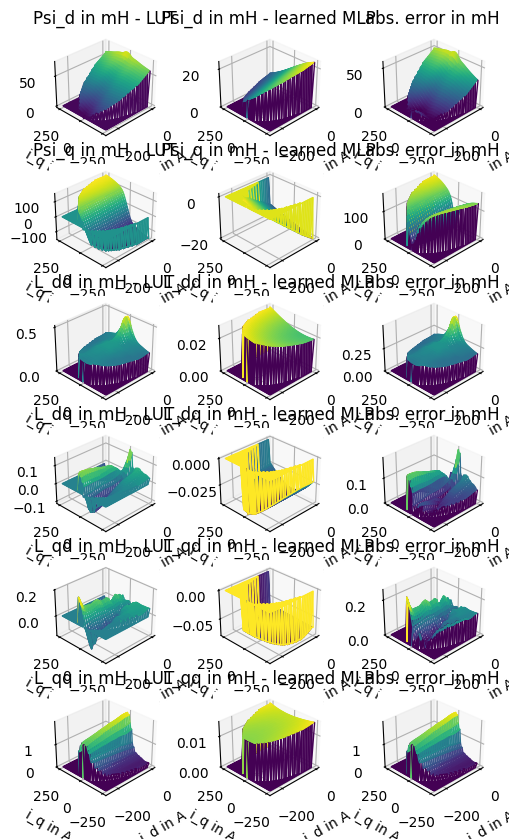

 18%|█▊        | 90000/500000 [17:30<1:16:34, 89.24it/s] 

2.2251912516100987


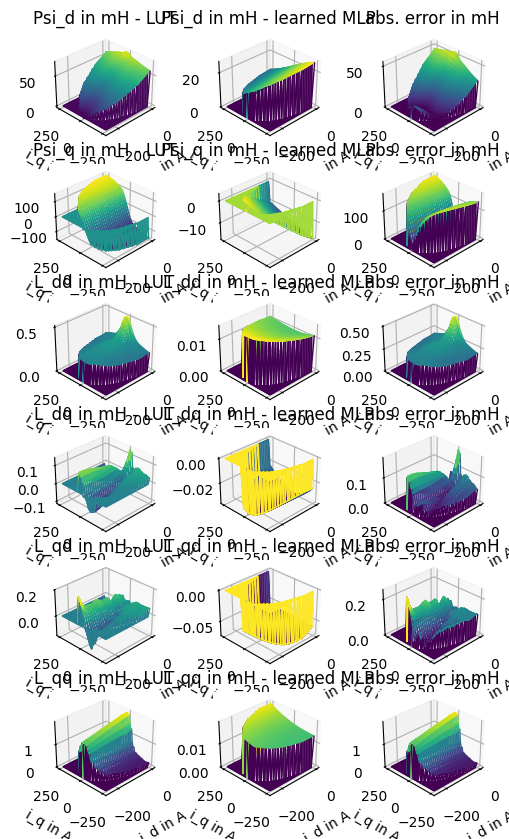

 20%|█▉        | 99997/500000 [19:26<1:14:40, 89.27it/s] 

2.430543294590243


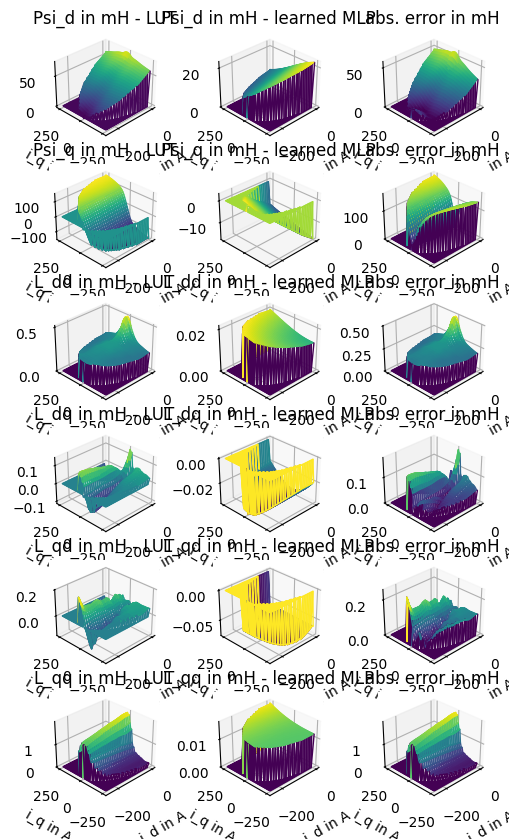

 22%|██▏       | 109994/500000 [21:23<1:12:46, 89.32it/s] 

2.3244639497644877


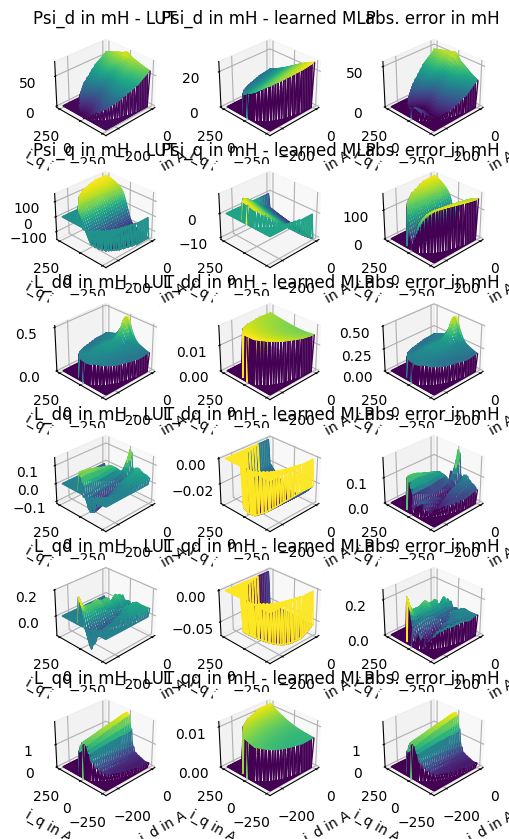

 24%|██▍       | 119992/500000 [23:20<1:11:05, 89.10it/s] 

2.3056000235712903


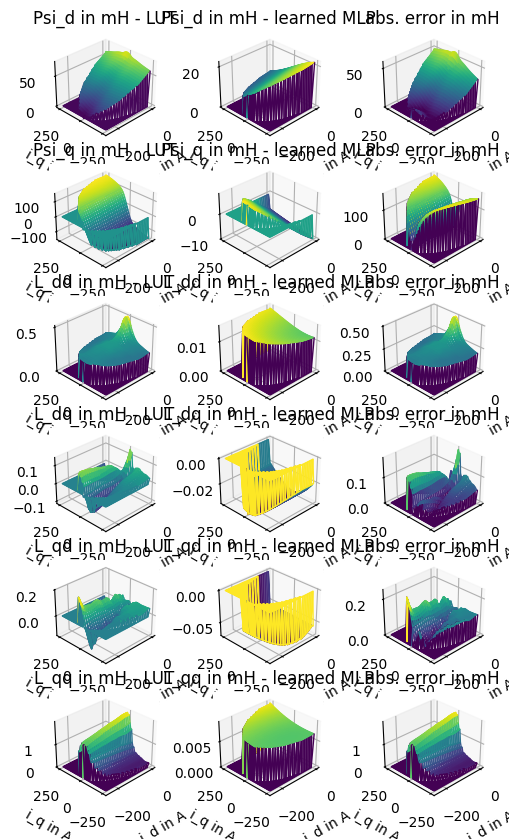

 26%|██▌       | 129996/500000 [25:15<1:09:12, 89.11it/s] 

2.30099640351135


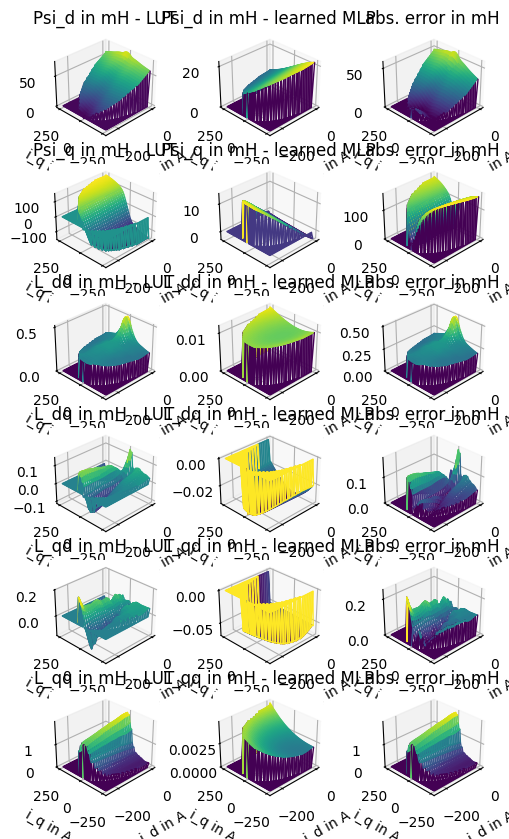

 28%|██▊       | 139993/500000 [27:13<1:07:20, 89.10it/s] 

2.2173505419401103


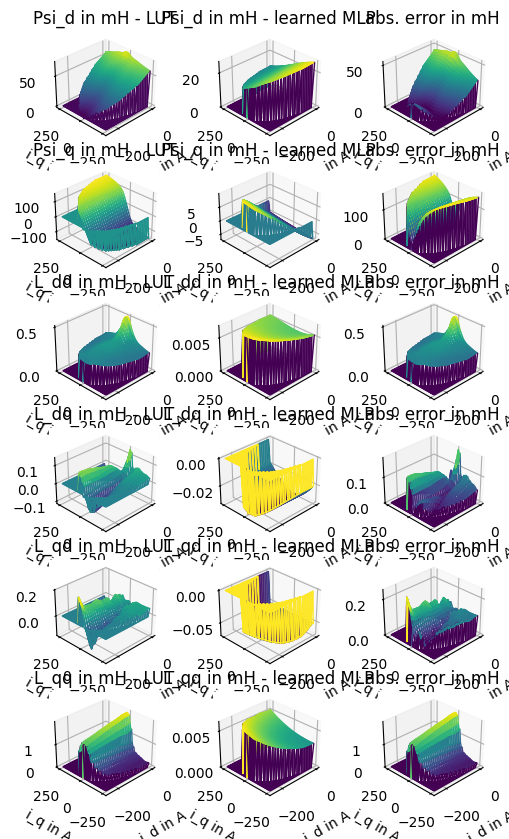

 30%|██▉       | 149999/500000 [29:09<1:05:24, 89.19it/s] 

2.241903834983015


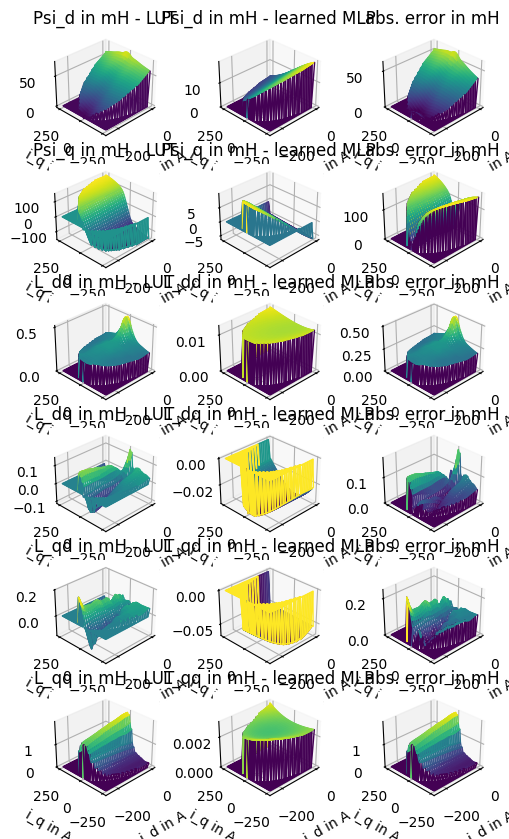

 32%|███▏      | 159998/500000 [31:06<1:03:35, 89.10it/s] 

2.22044150553533


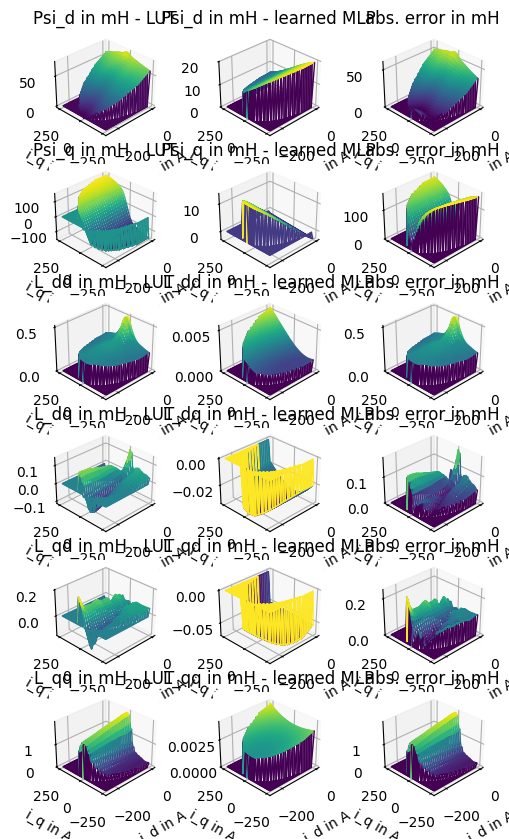

 34%|███▍      | 169993/500000 [33:02<1:01:39, 89.21it/s] 

2.2679868440287794


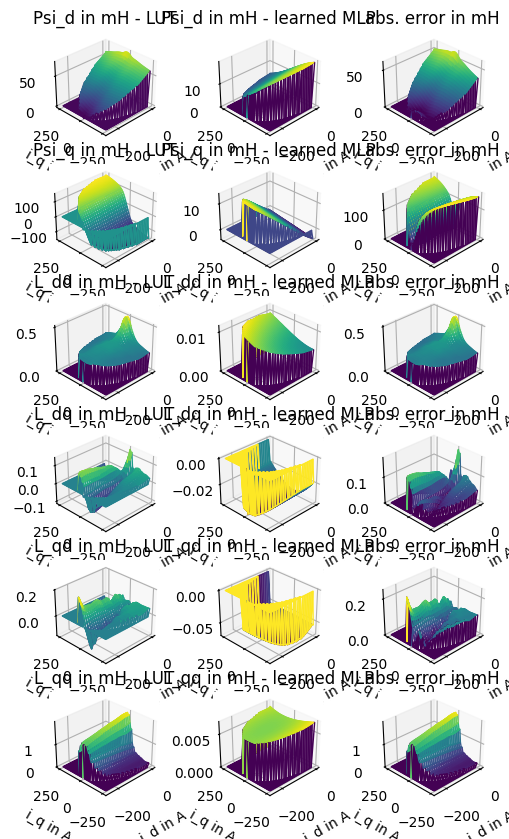

 36%|███▌      | 180000/500000 [34:59<59:46, 89.21it/s]   

2.2786369413306833


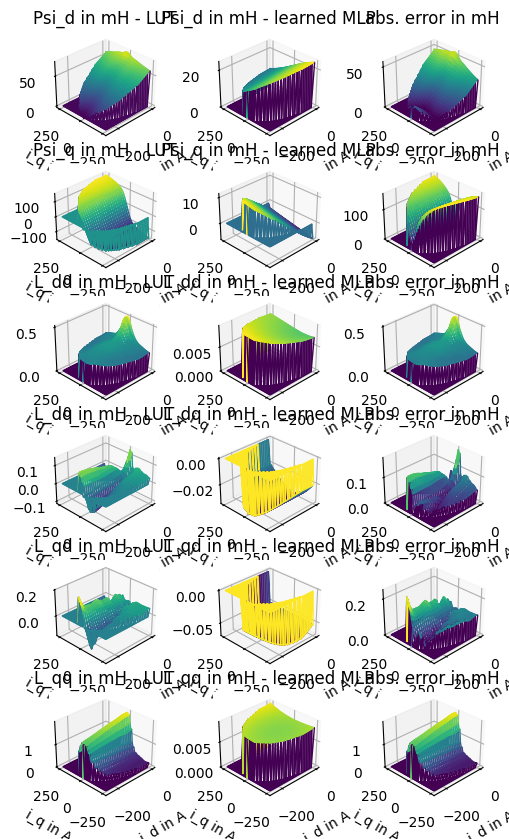

 38%|███▊      | 189998/500000 [36:55<57:55, 89.19it/s]   

2.2841727207529905


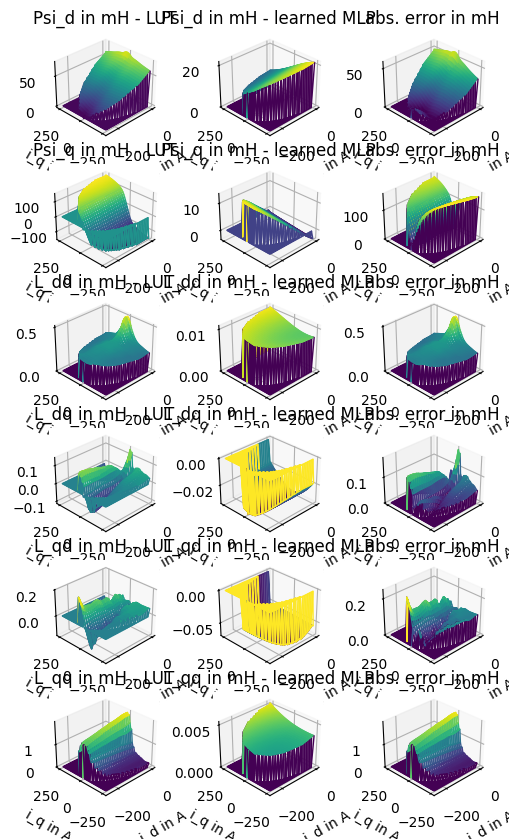

 40%|███▉      | 199995/500000 [38:52<56:05, 89.15it/s]   

2.162105210382984


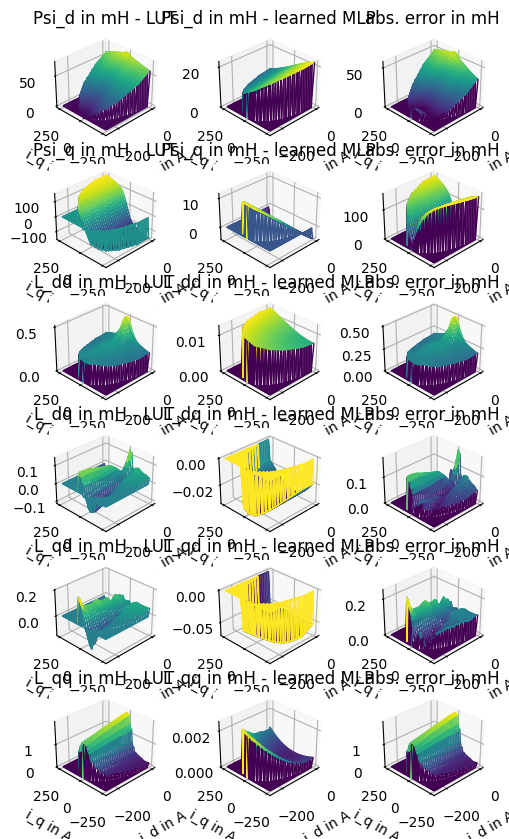

 42%|████▏     | 209993/500000 [40:48<54:42, 88.35it/s]   

2.170824432273554


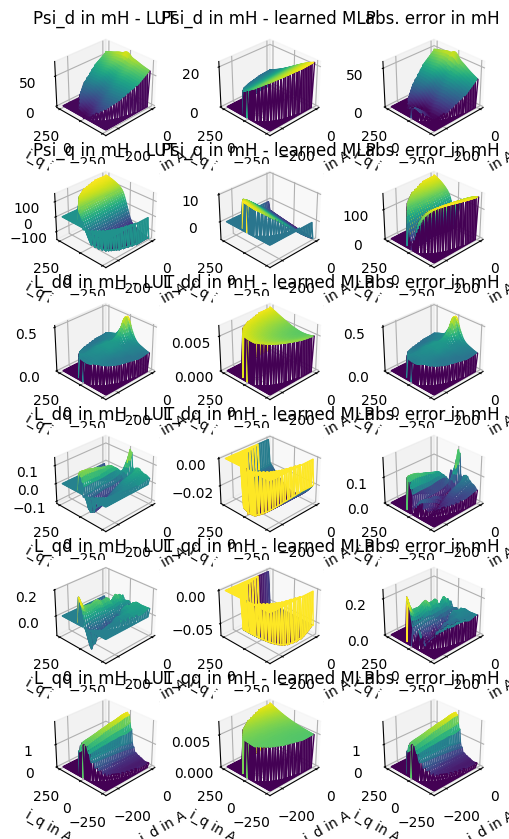

 44%|████▍     | 219997/500000 [42:45<52:20, 89.15it/s]   

2.081308421130678


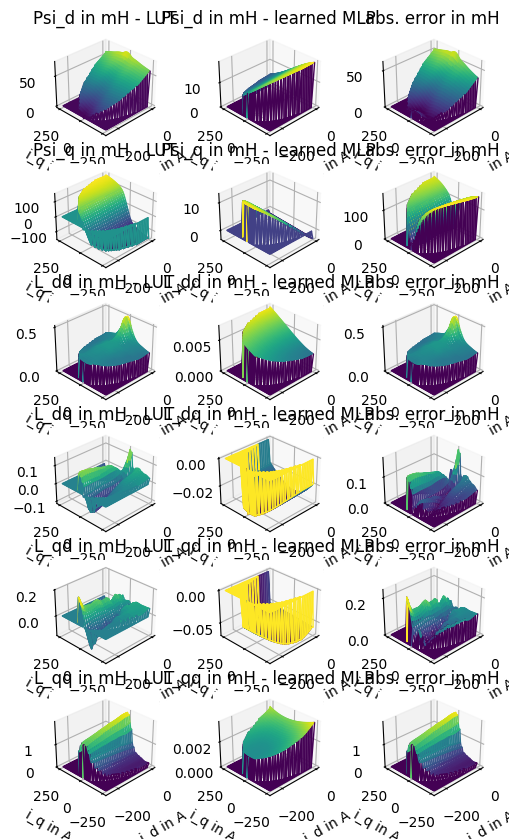

 46%|████▌     | 229997/500000 [44:42<50:28, 89.14it/s]   

2.150821204488844


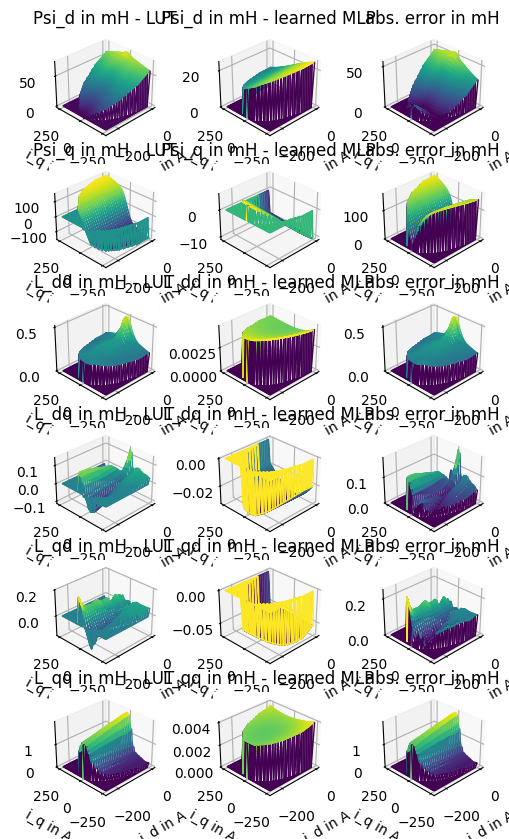

 48%|████▊     | 239998/500000 [46:38<48:35, 89.19it/s]   

2.1480354225284706


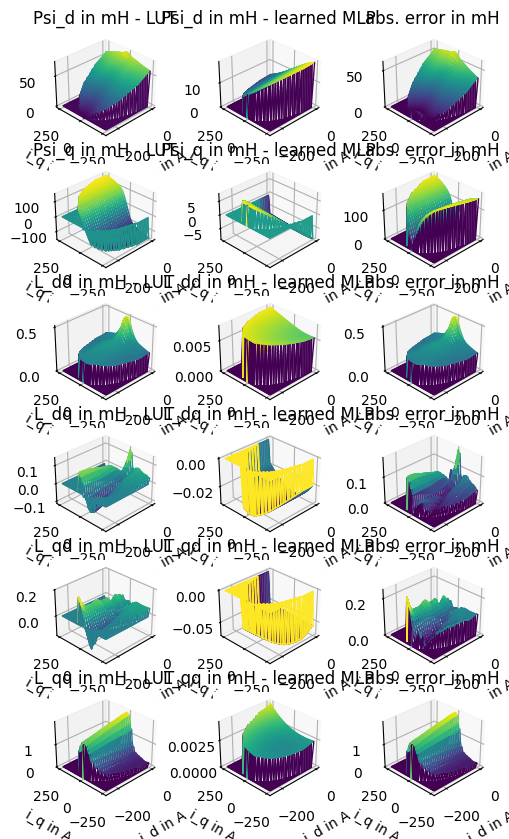

 50%|█████     | 250000/500000 [48:35<46:56, 88.75it/s]   

2.275775095248982


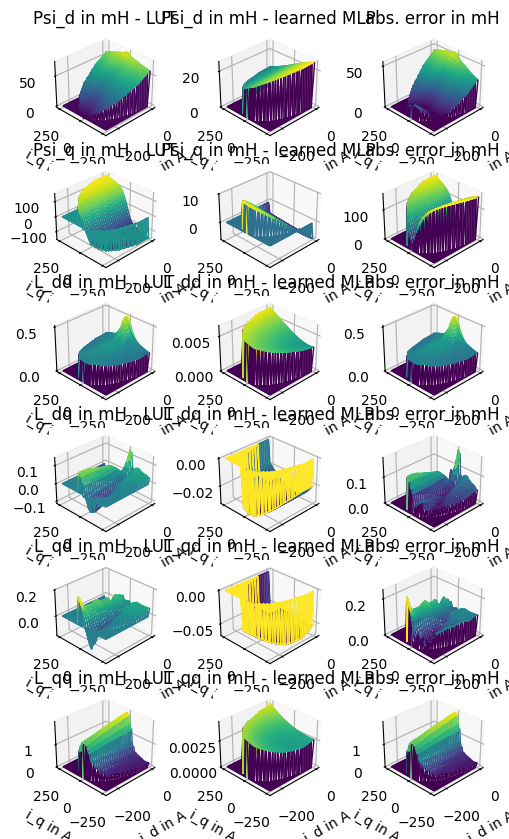

 52%|█████▏    | 259998/500000 [50:31<45:11, 88.50it/s]  

2.235099475678513


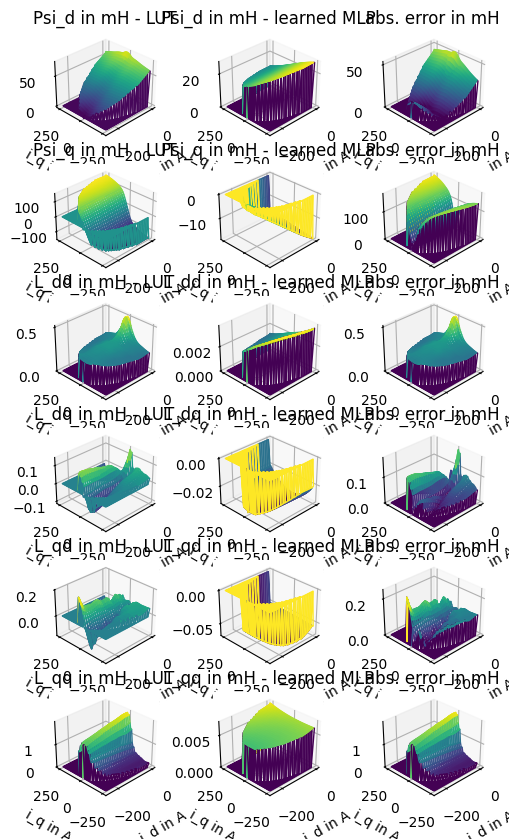

 54%|█████▍    | 269995/500000 [52:29<43:18, 88.50it/s]   

2.18074893630521


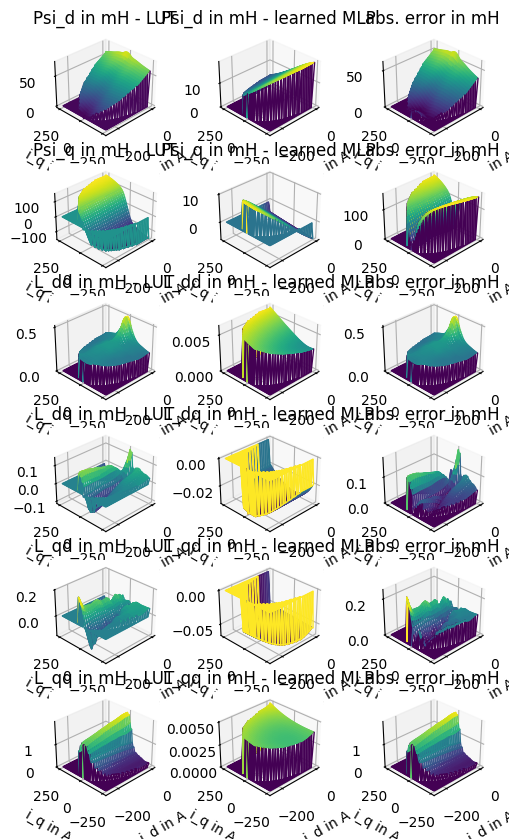

 56%|█████▌    | 279997/500000 [54:26<41:25, 88.51it/s]  

2.2357203050193952


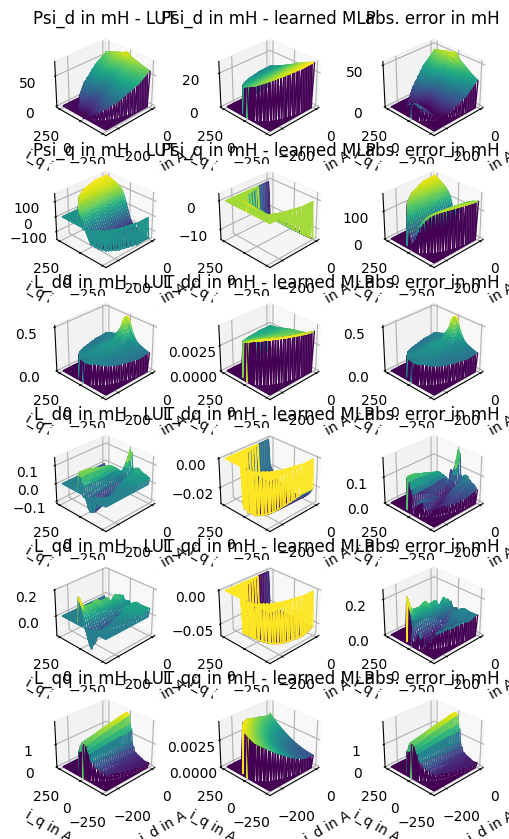

 58%|█████▊    | 289995/500000 [56:24<39:31, 88.55it/s]   

2.109583970663534


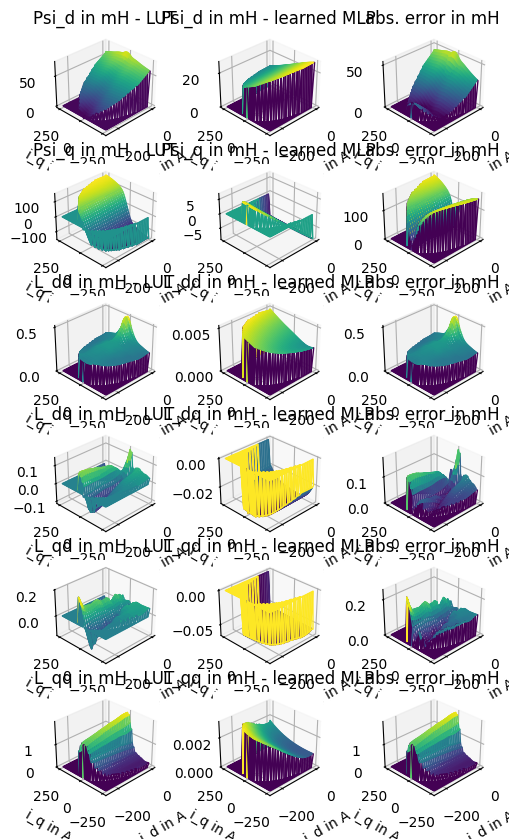

 60%|█████▉    | 299993/500000 [58:21<37:41, 88.42it/s]  

2.1296624066920105


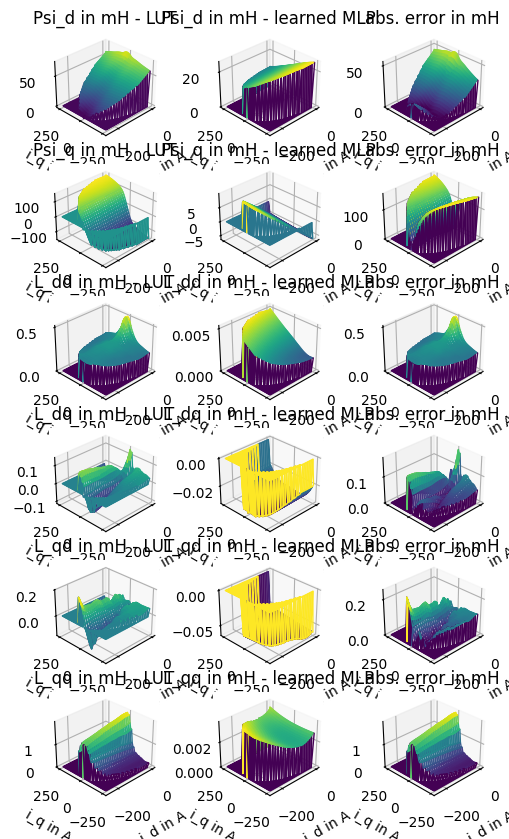

 62%|██████▏   | 309996/500000 [1:00:20<35:57, 88.08it/s]

2.0904574365315742


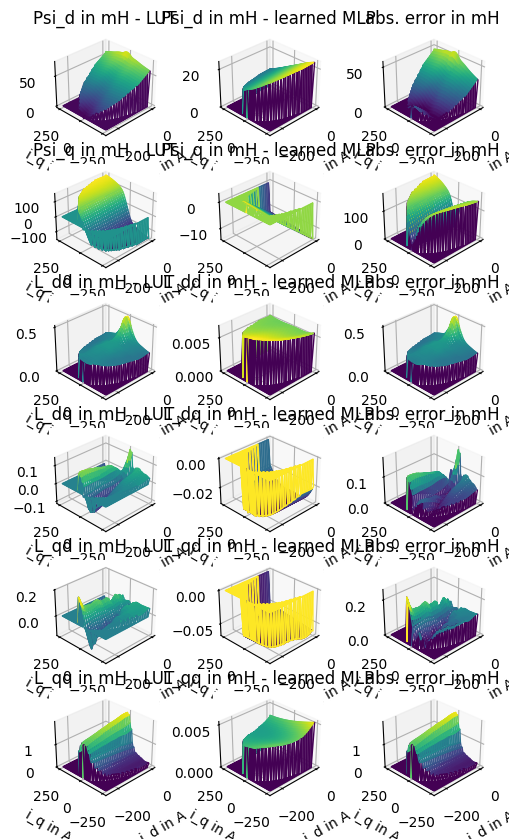

 64%|██████▍   | 319995/500000 [1:02:18<34:07, 87.93it/s]  

2.264323565151897


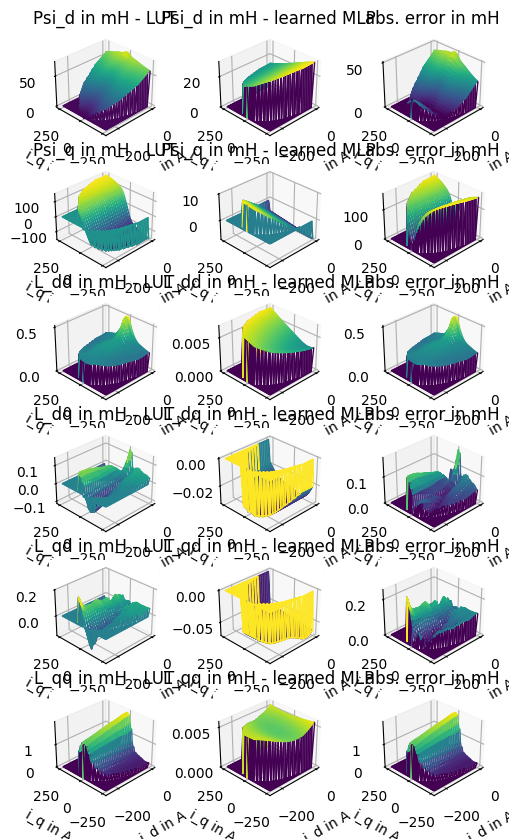

 66%|██████▌   | 330000/500000 [1:04:17<32:11, 87.99it/s]  

2.2706296135639317


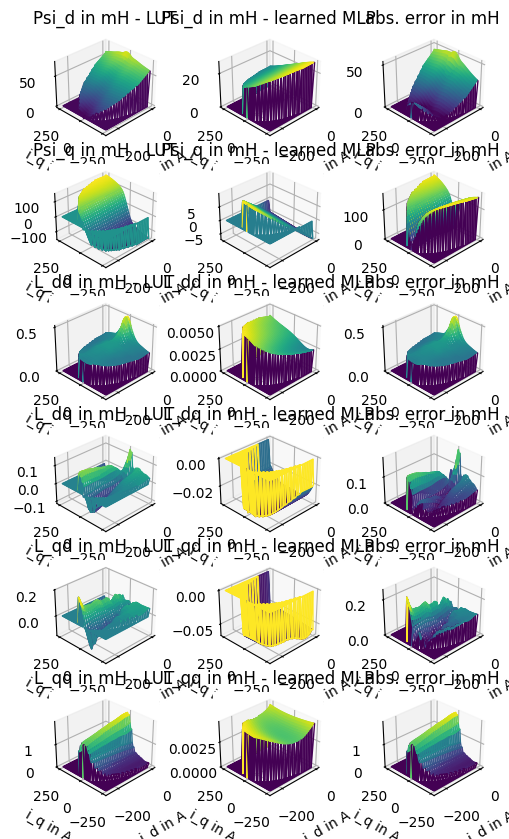

 68%|██████▊   | 339997/500000 [1:06:15<30:18, 88.00it/s]  

2.2568888948344066


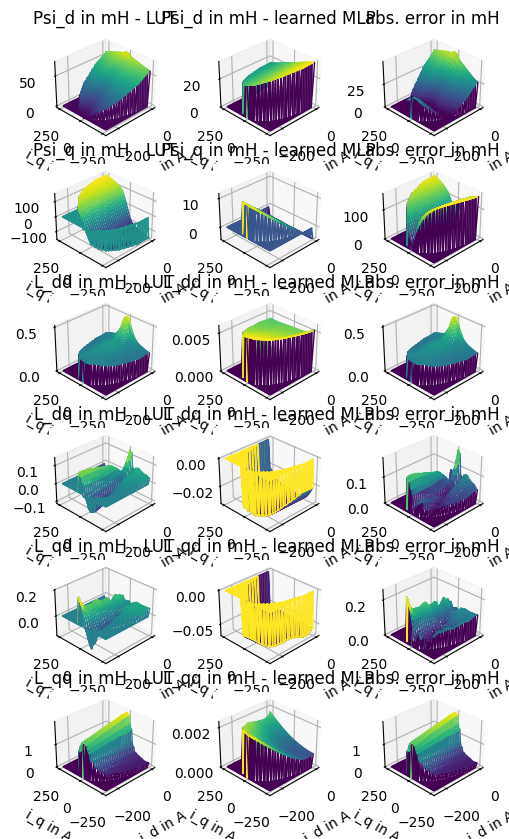

 70%|██████▉   | 349992/500000 [1:08:13<28:24, 88.03it/s]  

2.1823876189630838


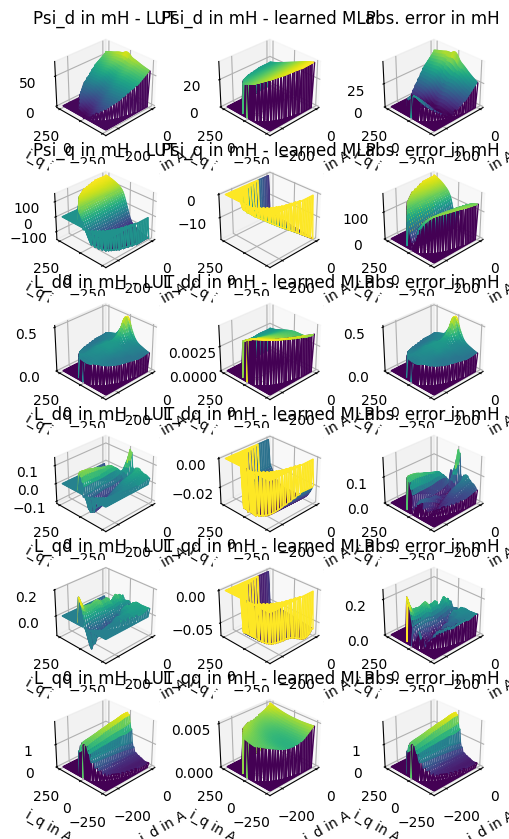

 72%|███████▏  | 359997/500000 [1:10:12<26:29, 88.06it/s]  

2.2720453030748944


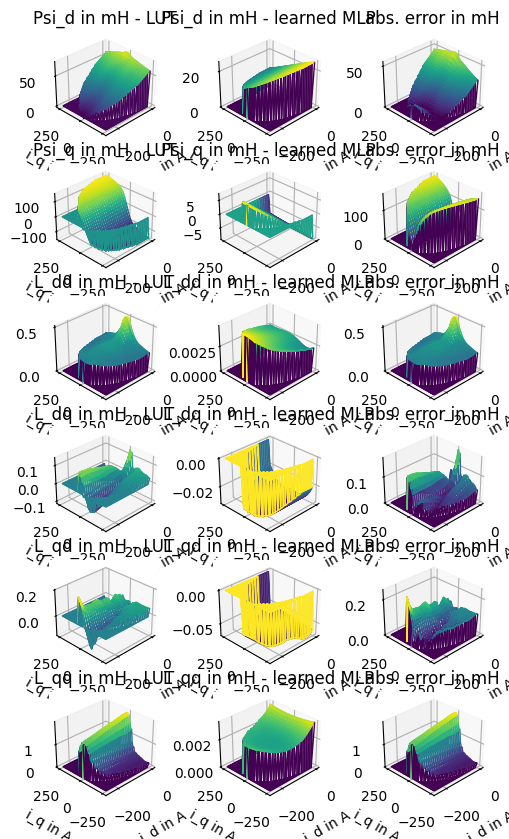

 74%|███████▍  | 369997/500000 [1:12:10<24:37, 88.00it/s]  

2.1205867864566486


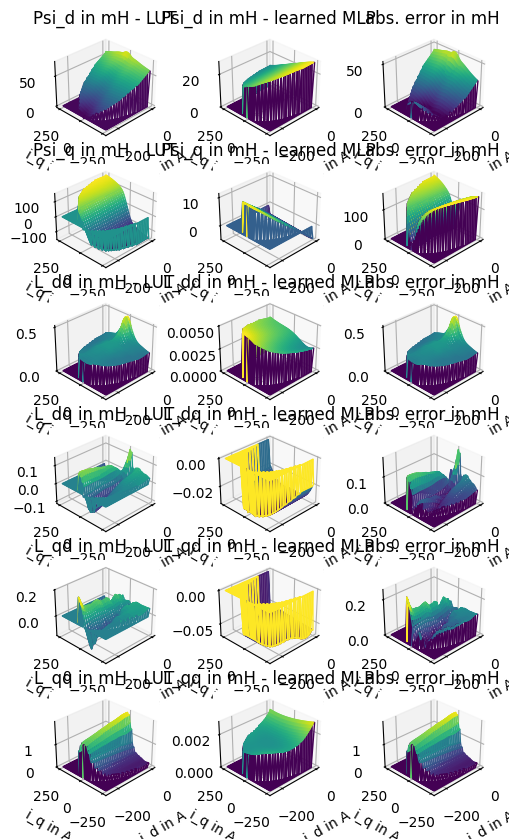

 76%|███████▌  | 379995/500000 [1:14:09<22:42, 88.08it/s]  

2.2142309981529626


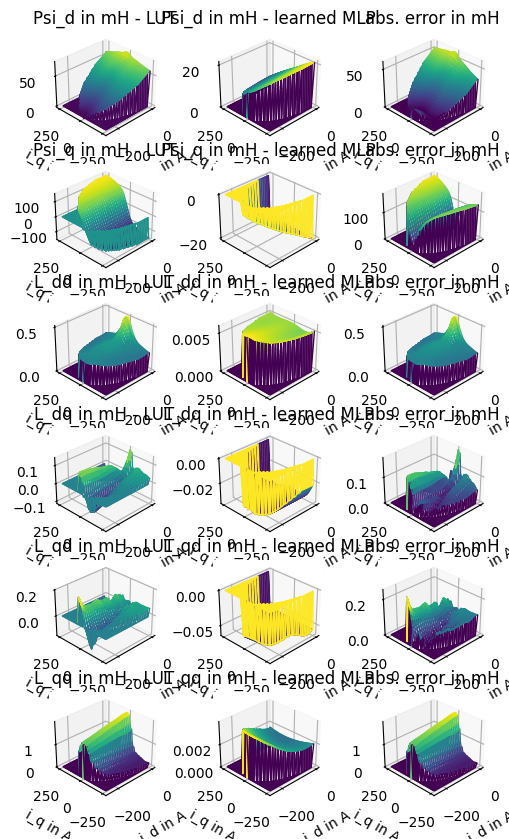

 78%|███████▊  | 390000/500000 [1:16:06<20:40, 88.69it/s]  

2.2642007967659277


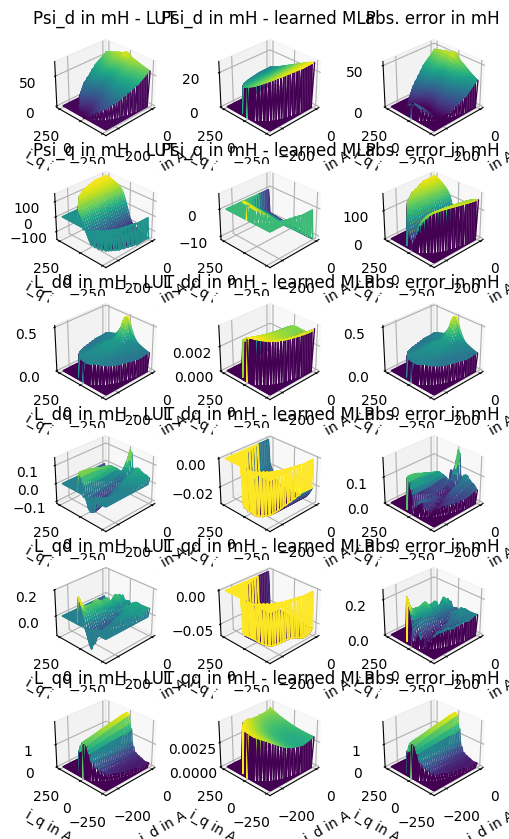

 80%|███████▉  | 399999/500000 [1:18:04<18:55, 88.04it/s]  

2.142343371289381


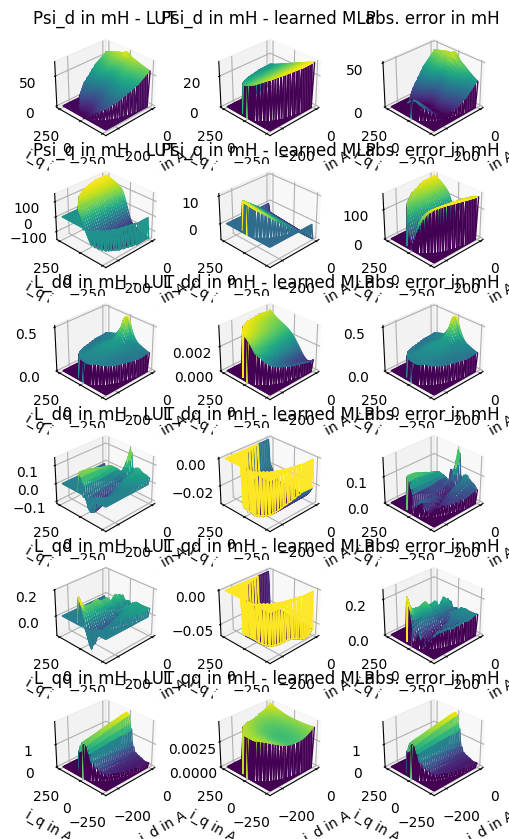

 82%|████████▏ | 409999/500000 [1:20:02<16:56, 88.53it/s]  

2.2584554213916004


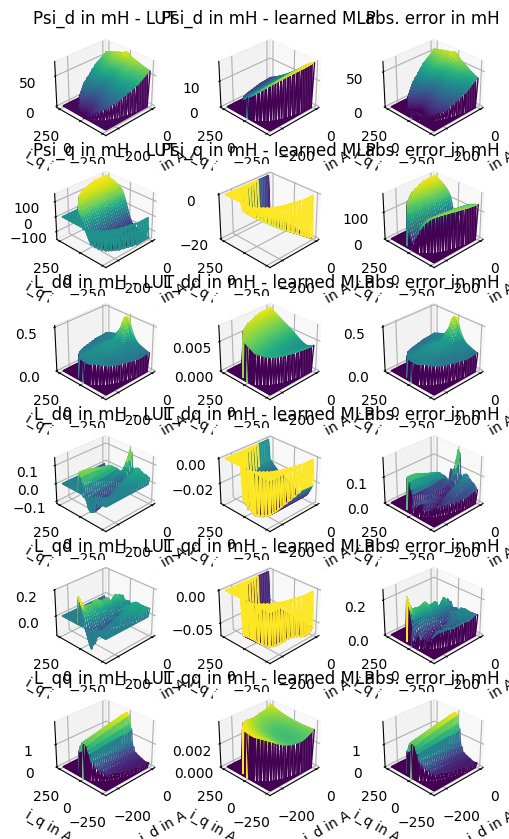

 84%|████████▍ | 419996/500000 [1:22:00<15:03, 88.51it/s]  

2.066066481996451


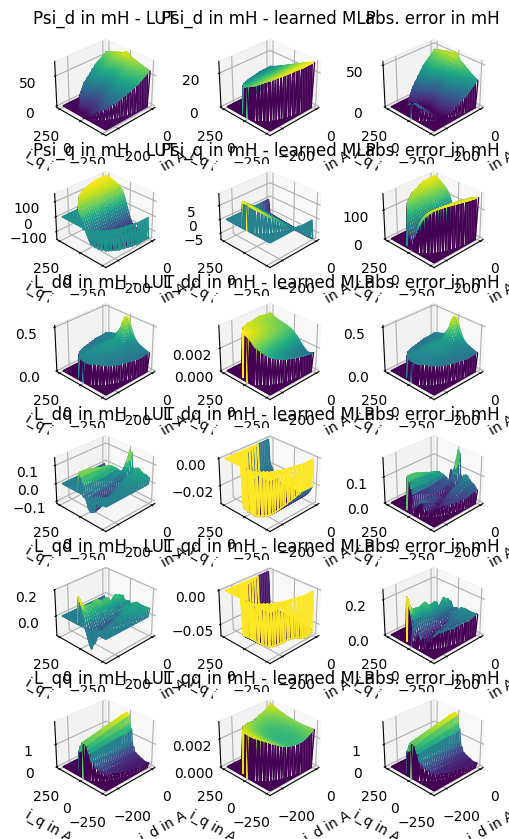

 86%|████████▌ | 429993/500000 [1:23:57<13:15, 88.02it/s]  

2.20618612563673


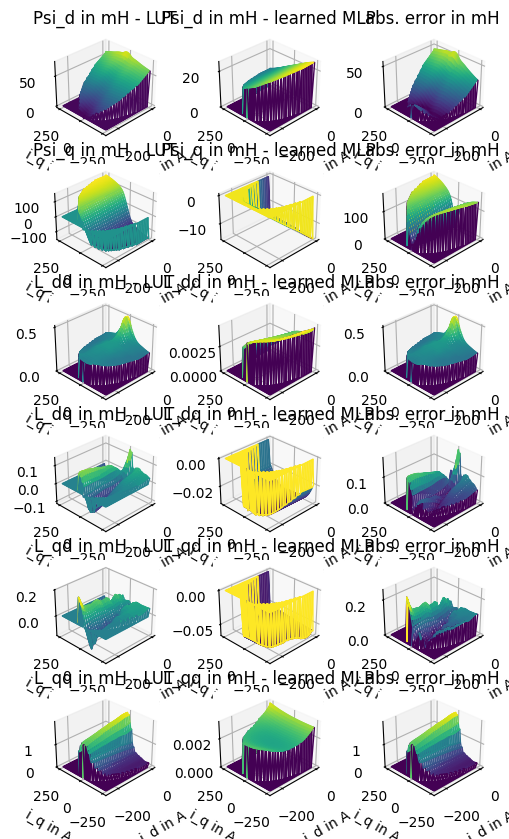

 88%|████████▊ | 439998/500000 [1:25:55<11:17, 88.52it/s]  

2.2802457404429735


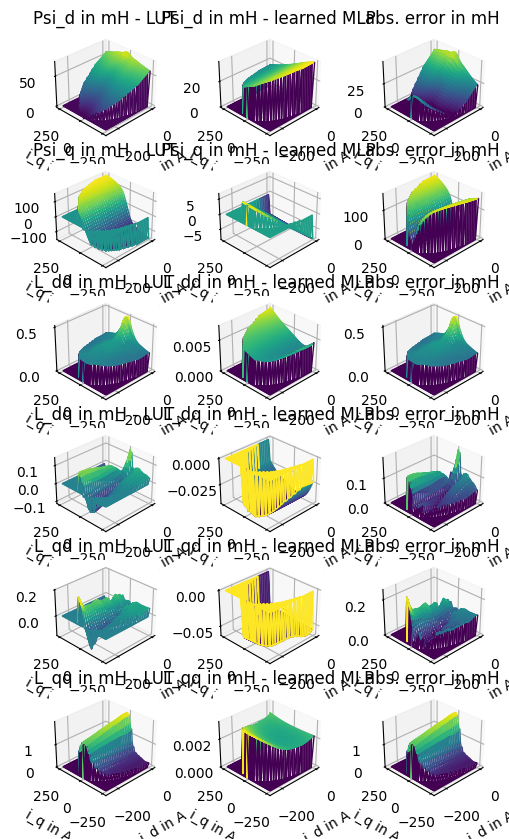

 90%|████████▉ | 449994/500000 [1:27:52<09:25, 88.49it/s]  

2.230805685758371


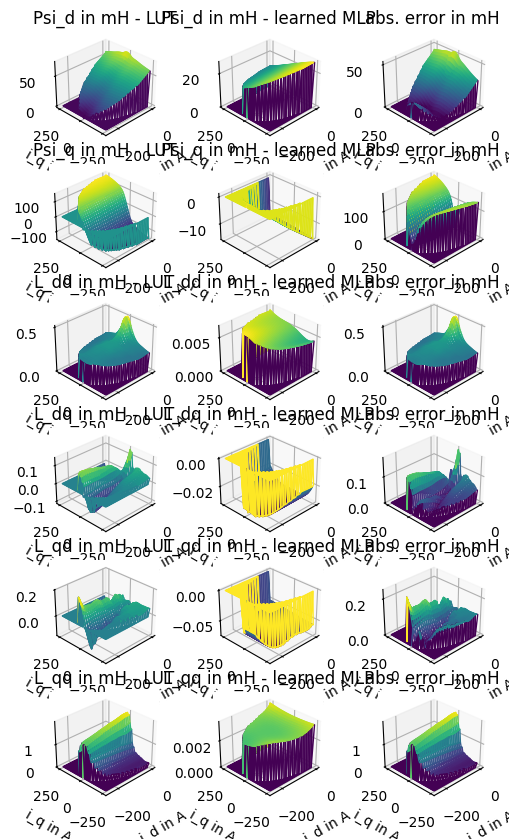

 92%|█████████▏| 460000/500000 [1:29:49<07:31, 88.60it/s]  

5.876546157377084


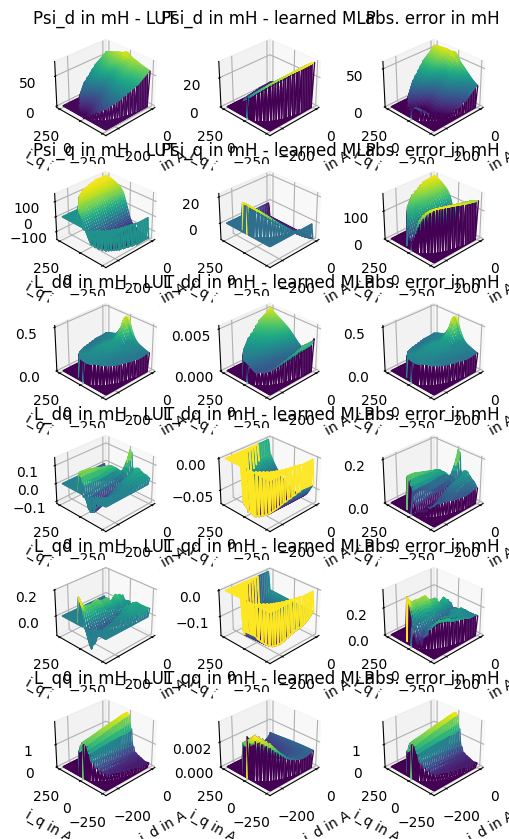

 94%|█████████▍| 469999/500000 [1:31:48<05:38, 88.58it/s]  

3.756020821400834


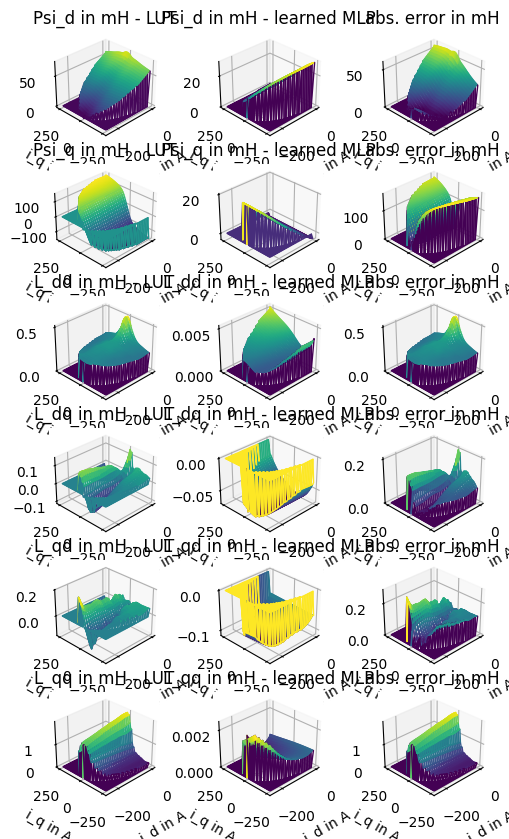

 96%|█████████▌| 479996/500000 [1:33:44<03:45, 88.55it/s]  

2.219149825493613


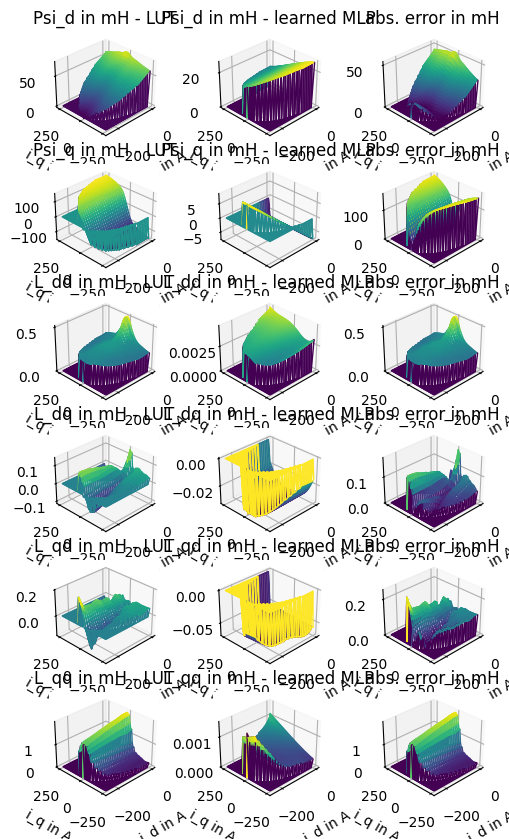

 98%|█████████▊| 489993/500000 [1:35:43<01:53, 88.50it/s]  

2.1183558703519303


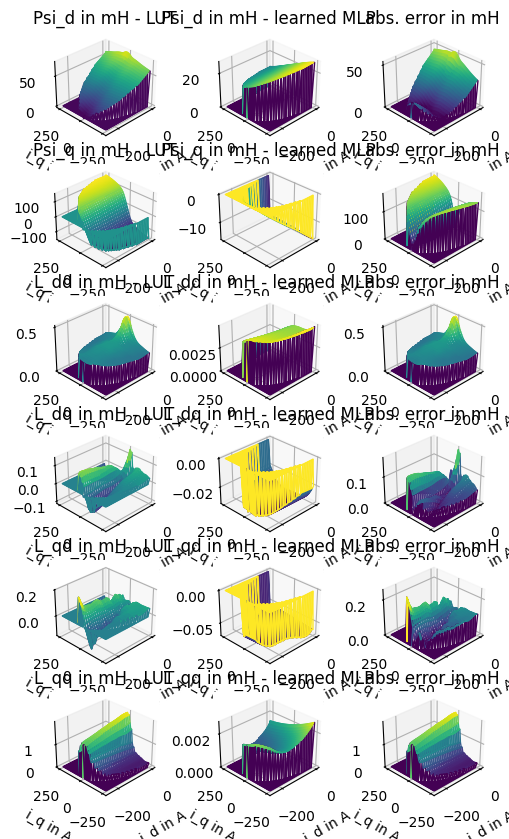

100%|██████████| 500000/500000 [1:37:40<00:00, 85.32it/s]


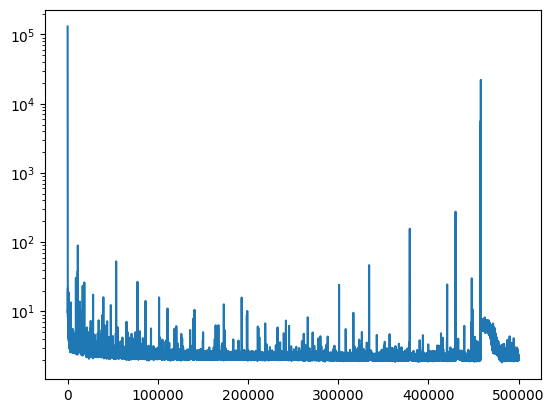

In [28]:
fin_node_22,fin_opt_state,fin_keys,losses, val_losses=mtrainer.fit_non_jit(node,opt_state,keys,plot_every=10_000)
plt.plot(losses)
plt.yscale('log')

In [29]:
motor_env = PMSM(
    saturated=True,
    LUT_motor_name="BRUSA",
    batch_size=1,
    control_state=[], 
    static_params = {
            "p": 3,
            "r_s": 15e-3,
            "l_d": 0.37e-3,
            "l_q": 1.2e-3,
            "psi_p": 65.6e-3,
            "deadtime": 0,
    })

In [30]:
@eqx.filter_jit
def reset(node,rng):
    obs, _ = motor_env.reset(motor_env.env_properties, rng)  #
    obs = obs.at[2].set((3*1500 / 60 * 2 * jnp.pi) / (2 * jnp.pi * 3 * 11000 / 60))
    return obs

In [31]:
@eqx.filter_jit
def node_dat_gen_sin(node,reset_env, rng, traj_len):
    rng, subkey = jax.random.split(rng)
    ref_obs = reset_env(node,subkey) 
    rng, subkey = jax.random.split(rng)
    init_obs = reset_env(node,subkey)  
    return init_obs, ref_obs, rng

In [32]:
@eqx.filter_jit
def featurize(obs,ref_obs, featurize_state=jnp.array([0,0])):
    feat_obs=jnp.concatenate([obs[0:2],ref_obs[0:2],ref_obs[0:2]-obs[0:2],featurize_state])#jnp.concatenate([obs[0:2],obs[6:8],ref_obs[0:2],ref_obs[0:2]-obs[0:2],featurize_state])
    #featurize_state=jnp.clip(featurize_state + ref_obs[0:2]-obs[0:2],min=-1,max=1) * (jnp.sign(0.01-jnp.sum((ref_obs[0:2]-obs[0:2])**2))*0.5+0.5)
    return feat_obs,featurize_state

In [33]:
@eqx.filter_jit
def mse_loss(feat_obs):
    loss=jnp.mean(jnp.sum((feat_obs[:,4:6])**2,axis=1))#be aware of idx if changing featurize
    return loss

In [34]:
@eqx.filter_jit
def penalty_loss(feat_obs):
    loss=jnp.array([0])
    return loss

In [35]:
jax_key = jax.random.PRNGKey(2)
policy=MLP([8,64,64,64,2],key=jax_key,output_activation=jnp.tanh)
optimizer = optax.adam(5e-4)
opt_state = optimizer.init(policy)

In [36]:
data_batch_size=100
trainer=DPCTrainer(
    batch_size=data_batch_size,
    train_steps=2000,
    horizon_length=5,
    reset_env=reset,
    data_gen_sin=node_dat_gen_sin,
    featurize=featurize,
    policy_optimizer=optimizer,
    ref_loss=mse_loss,
    constr_penalty=penalty_loss,
    ref_loss_weight=1)
keys=jax.vmap(jax.random.PRNGKey)(np.random.randint(0, 2**31, size=(data_batch_size,)))
#key=jax.vmap(jax.random.PRNGKey)(jnp.linspace(0,1000,1001).astype(int))

In [37]:
import matplotlib.pyplot as plt
from utils.evaluation import steps_eval

In [38]:
def featurize_node(obs):
    return jnp.concatenate([obs[0:2],obs[4:6]])

In [39]:
fin_policy_L_node,fin_opt_state,fin_keys,losses=trainer.fit_on_node_non_jit(policy, fin_node_12, motor_env.tau, featurize_node, keys, opt_state)
plt.plot(losses)
plt.yscale('log')

NameError: name 'fin_node_12' is not defined

In [ ]:
obs,obs2,acts=steps_eval(motor_env,reset,fin_policy_L_node,featurize,jax.random.PRNGKey(4),2000)

In [35]:
data_batch_size=100
trainer2=DPCTrainer(
    batch_size=data_batch_size,
    train_steps=2000,
    horizon_length=20,
    reset_env=reset,
    data_gen_sin=node_dat_gen_sin,
    featurize=featurize,
    policy_optimizer=optimizer,
    ref_loss=mse_loss,
    constr_penalty=penalty_loss,
    ref_loss_weight=1)
keys=jax.vmap(jax.random.PRNGKey)(np.random.randint(0, 2**31, size=(data_batch_size,)))

In [ ]:
fin_policy_L_node_20,fin_opt_state,fin_keys,losses=trainer2.fit_on_node_non_jit(fin_policy_L_node, fin_node_12, motor_env.tau, featurize_node, keys, opt_state)
plt.plot(losses)
plt.yscale('log')

In [ ]:
obs,obs2,acts=steps_eval(motor_env,reset,fin_policy_L_node_20,featurize,jax.random.PRNGKey(4),2000)